In [1]:
import numpy as np
import pandas as pd 
import xgboost as xgb
import matplotlib.pyplot as plt
import pickle
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.sandbox.regression.predstd import wls_prediction_std
import datetime
import xlrd
import os
import re
from scipy.stats import kstest
from scipy.spatial.distance import directed_hausdorff
from scipy import optimize
import pwlf1
from scipy.optimize import minimize
from pyecharts import options as opts
from pyecharts.charts import Calendar
from matplotlib.ticker import FuncFormatter
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import math
from sklearn.exceptions import ConvergenceWarning
import warnings
import contextlib

In [2]:
import importlib
importlib.reload(pwlf1)

<module 'pwlf1' from 'e:\\day-ahead price\\Code\\ISO_New_England\\pwlf1.py'>

In [3]:
# load day ahead price data from E:\day-ahead price\Data\ISO_New_England\day_ahead_price
path = r'E:\day-ahead price\Data\ISO_New_England\day_ahead_price'
os.chdir(path)
files = os.listdir(path)
df = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    # print(df_tmp)
    df = pd.concat([df, df_tmp])
df.columns = df.iloc[4]
df = df[df['H'] == 'D'].drop(['H'], axis = 1).reset_index(drop = True)
# average price by Date and Hour Ending
tmp = []
df['Hour Ending'] = df['Hour Ending'].astype(str)
df['Date'] = pd.to_datetime(df['Date'])
df['Date'] = df['Date'].dt.strftime('%Y-%m-%d')
df['Locational Marginal Price'] = df['Locational Marginal Price'].astype(float)
df['Energy Component'] = df['Energy Component'].astype(float)
df['Congestion Component'] = df['Congestion Component'].astype(float)
df['Marginal Loss Component'] = df['Marginal Loss Component'].astype(float)
df_group = df.groupby(['Date', 'Hour Ending'])
for [Date, Hour_Ending], group in df_group:
    Locational_Marginal_Price = group['Locational Marginal Price'].mean() 
    Energy_Component = group['Energy Component'].mean()
    Congestion_Component = group['Congestion Component'].mean()
    Marginal_Loss_Component = group['Marginal Loss Component'].mean()
    tmp.append([Date, Hour_Ending, Locational_Marginal_Price, Energy_Component, Congestion_Component, Marginal_Loss_Component])
df_price = pd.DataFrame(tmp, columns = ['Date', 'Hour Ending', 'Locational Marginal Price', 'Energy Component', 'Congestion Component', 'Marginal Loss Component'])
df_price

,Date,Hour Ending,Locational Marginal Price,Energy Component,Congestion Component,Marginal Loss Component
0,2023-01-01,01,31.089169,31.28,0.000000,-0.190831
1,2023-01-01,02,28.274745,28.44,0.000000,-0.165255
2,2023-01-01,03,26.674071,26.83,0.000000,-0.155929
3,2023-01-01,04,28.031077,28.19,0.000000,-0.158923
4,2023-01-01,05,29.541431,29.70,0.000000,-0.158569
...,...,...,...,...,...,...
7555,2023-11-11,20,40.609046,40.90,-0.030929,-0.260025
7556,2023-11-11,21,40.179589,40.43,-0.028840,-0.221571
7557,2023-11-11,22,39.871406,40.09,-0.032385,-0.186209
7558,2023-11-11,23,29.190831,29.34,-0.002179,-0.146990


In [4]:
# df_price lack a line of data in Date 2023-03-12, Hour Ending 3, so we need to add this line by average of Hour Ending 2 and Hour Ending 4
lost_data = pd.DataFrame({'Date': '2023-03-12', 'Hour Ending': '03', 'Locational Marginal Price': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Locational Marginal Price'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Locational Marginal Price'].values[0])/2, 'Energy Component': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Energy Component'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Energy Component'].values[0])/2, 'Congestion Component': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Congestion Component'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Congestion Component'].values[0])/2, 'Marginal Loss Component': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Marginal Loss Component'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Marginal Loss Component'].values[0])/2}, index = [0])
df_price = pd.concat([df_price, lost_data]).sort_values(by = ['Date', 'Hour Ending']).reset_index(drop = True)
# delete the line of data in Date 2023-11-05, whose Hour Ending = '02X' 
df_price = df_price.drop(df_price[(df_price['Date'] == '2023-11-05') & (df_price['Hour Ending'] == '02X')].index).reset_index(drop = True)
df_price['Hour Ending'] = df_price['Hour Ending'].astype(int)
df_price

,Date,Hour Ending,Locational Marginal Price,Energy Component,Congestion Component,Marginal Loss Component
0,2023-01-01,1,31.089169,31.28,0.000000,-0.190831
1,2023-01-01,2,28.274745,28.44,0.000000,-0.165255
2,2023-01-01,3,26.674071,26.83,0.000000,-0.155929
3,2023-01-01,4,28.031077,28.19,0.000000,-0.158923
4,2023-01-01,5,29.541431,29.70,0.000000,-0.158569
...,...,...,...,...,...,...
7555,2023-11-11,20,40.609046,40.90,-0.030929,-0.260025
7556,2023-11-11,21,40.179589,40.43,-0.028840,-0.221571
7557,2023-11-11,22,39.871406,40.09,-0.032385,-0.186209
7558,2023-11-11,23,29.190831,29.34,-0.002179,-0.146990


In [5]:
# load real capacity data from E:\day-ahead price\Data\ISO_New_England\real_capacity
path = r'E:\day-ahead price\Data\ISO_New_England\real_capacity'
os.chdir(path)
files = os.listdir(path)
df_peak_load = pd.DataFrame()
df_capa = pd.DataFrame()
df_interchange = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp = df_tmp.iloc[8:50, :].reset_index(drop=True)

    prior_date = pd.to_datetime(df_tmp.iloc[1, 1])
    Hour_Ending = int(df_tmp.iloc[1, 2])
    peak_load = float(df_tmp.iloc[1, 3])
    df_peak_load = pd.concat([df_peak_load, pd.DataFrame([[prior_date, Hour_Ending, peak_load]], columns=['Date', 'Hour Ending', 'Peak Load'])], axis=0)

    report_date = prior_date + datetime.timedelta(1)
    Capacity_Supply_Obligation = float(df_tmp.iloc[4, 2])
    Capacity_Additions_EcoMax_Bid_CSO = float(df_tmp.iloc[5, 2])	
    Generation_Outages_and_Reductions = float(df_tmp.iloc[6, 2])
    Uncommitted_Available_Generation = float(df_tmp.iloc[7, 2])
    DRR_Capacity = float(df_tmp.iloc[8, 2])
    Uncommitted_Available_DRR = float(df_tmp.iloc[9, 2])
    Net_Deliveries = float(df_tmp.iloc[17, 2])
    Total_Available_Capacity = float(df_tmp.iloc[18, 2])
    Peak_Load_Forecast = float(df_tmp.iloc[19, 2])
    Total_Operating_Reserve_Requirements = float(df_tmp.iloc[20, 2])
    Capacity_Required = float(df_tmp.iloc[21, 2])
    Surplus_Deficiency = float(df_tmp.iloc[22, 2])
    Replacement_Reserve_Requirement = float(df_tmp.iloc[23, 2])
    Excess_Commitment_Surplus_Deficiency = float(df_tmp.iloc[24, 2])
    df_capa = pd.concat([df_capa, pd.DataFrame([[report_date, Hour_Ending, Capacity_Supply_Obligation, Capacity_Additions_EcoMax_Bid_CSO, Generation_Outages_and_Reductions, Uncommitted_Available_Generation, DRR_Capacity, Uncommitted_Available_DRR, Net_Deliveries, Total_Available_Capacity, Peak_Load_Forecast, Total_Operating_Reserve_Requirements, Capacity_Required, Surplus_Deficiency, Replacement_Reserve_Requirement, Excess_Commitment_Surplus_Deficiency]], columns=['Date', 'Hour Ending', 'Capacity Supply Obligation', 'Capacity Additions EcoMax Bid CSO', 'Generation Outages and Reductions', 'Uncommitted Available Generation', 'DRR Capacity', 'Uncommitted Available DRR', 'Net Deliveries', 'Total Available Capacity', 'Peak Load Forecast', 'Total Operating Reserve Requirements', 'Capacity Required', 'Surplus Deficiency', 'Replacement Reserve Requirement', 'Excess Commitment Surplus Deficiency'])], axis=0)

    tmp_interchange = df_tmp.iloc[35:, 1:].reset_index(drop=True)
    tmp_interchange.columns = tmp_interchange.iloc[0]
    tmp_interchange = tmp_interchange.iloc[1:, :].reset_index(drop=True)
    tmp_interchange['Date'] = report_date
    df_interchange = pd.concat([df_interchange, tmp_interchange], axis=0)
    
df_peak_load = df_peak_load.drop_duplicates(subset=['Date'], keep='first').reset_index(drop=True)
df_capa = df_capa.drop_duplicates(subset=['Date'], keep='first').reset_index(drop=True)
df_interchange = df_interchange.drop_duplicates(subset=['Date', 'Description'], keep='first').reset_index(drop=True)
df_capa

,Date,Hour Ending,Capacity Supply Obligation,Capacity Additions EcoMax Bid CSO,Generation Outages and Reductions,Uncommitted Available Generation,DRR Capacity,Uncommitted Available DRR,Net Deliveries,Total Available Capacity,Peak Load Forecast,Total Operating Reserve Requirements,Capacity Required,Surplus Deficiency,Replacement Reserve Requirement,Excess Commitment Surplus Deficiency
0,2023-01-01,18,28274.0,3160.0,3108.0,12988.0,187.0,12.0,-3119.0,18632.0,14610.0,2475.0,17085.0,1547.0,180.0,1367.0
1,2023-01-02,18,28274.0,2803.0,2670.0,13351.0,221.0,12.0,-2706.0,17971.0,15310.0,2463.0,17773.0,198.0,180.0,18.0
2,2023-01-03,18,28274.0,2698.0,3457.0,11471.0,236.0,12.0,-2755.0,19023.0,16250.0,2124.0,18374.0,649.0,180.0,469.0
3,2023-01-04,18,28274.0,2723.0,2799.0,11306.0,248.0,12.0,-2896.0,20024.0,16000.0,2532.0,18532.0,1492.0,180.0,1312.0
4,2023-01-05,18,28274.0,2924.0,2602.0,10051.0,229.0,12.0,-2638.0,21400.0,16750.0,2431.0,19181.0,2219.0,180.0,2039.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
310,2023-11-07,18,28377.0,1129.0,9637.0,4125.0,220.0,12.0,-2401.0,18353.0,14500.0,2108.0,16608.0,1745.0,180.0,1565.0
311,2023-11-08,18,28377.0,1769.0,8918.0,4023.0,220.0,12.0,-2383.0,19796.0,15280.0,2053.0,17333.0,2463.0,180.0,2283.0
312,2023-11-09,18,28377.0,974.0,9639.0,3207.0,226.0,12.0,-2002.0,18721.0,15360.0,2110.0,17470.0,1251.0,180.0,1071.0
313,2023-11-10,18,28377.0,1268.0,9118.0,4559.0,224.0,12.0,-2145.0,18325.0,14830.0,2068.0,16898.0,1427.0,180.0,1247.0


In [6]:
# load real load data from E:\day-ahead price\Data\ISO_New_England\real_load
path = r'E:\day-ahead price\Data\ISO_New_England\real_load'
os.chdir(path)
files = os.listdir(path)
df_real_load = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp.columns = df_tmp.iloc[4]
    df_tmp = df_tmp[df_tmp['H'] == 'D'].iloc[:, 1:].reset_index(drop=True)
    df_tmp['Date'] = pd.to_datetime(df_tmp['Date'])
    df_tmp = df_tmp[df_tmp['Hour Ending'] != '02X']
    df_tmp['Hour Ending'] = df_tmp['Hour Ending'].astype(int)
    df_tmp['Day-Ahead Cleared Demand'] = df_tmp['Day-Ahead Cleared Demand'].astype(float)
    df_real_load = pd.concat([df_real_load, df_tmp], axis=0)
df_real_load

4,Date,Hour Ending,Day-Ahead Cleared Demand
0,2023-01-01,1,9825.0
1,2023-01-01,2,9322.0
2,2023-01-01,3,9366.0
3,2023-01-01,4,9316.0
4,2023-01-01,5,9668.0
...,...,...,...
356,2023-11-11,20,13427.0
357,2023-11-11,21,13145.0
358,2023-11-11,22,12383.0
359,2023-11-11,23,11749.0


In [7]:
# df_real_load lack a line of data in Date 2023-03-12, Hour Ending 3, so we need to add this line by average of Hour Ending 2 and Hour Ending 4
df_tmp = df_real_load[(df_real_load['Date'] == '2023-03-12') & (df_real_load['Hour Ending'] == 2)].reset_index(drop=True)
df_tmp['Hour Ending'] = 3
df_tmp['Day-Ahead Cleared Demand'] = (df_real_load[(df_real_load['Date'] == '2023-03-12') & (df_real_load['Hour Ending'] == 2)]['Day-Ahead Cleared Demand'].values + df_real_load[(df_real_load['Date'] == '2023-03-12') & (df_real_load['Hour Ending'] == 4)]['Day-Ahead Cleared Demand'].values) / 2
df_real_load = pd.concat([df_real_load, df_tmp], axis=0).reset_index(drop=True).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)
df_real_load

4,Date,Hour Ending,Day-Ahead Cleared Demand
0,2023-01-01,1,9825.0
1,2023-01-01,2,9322.0
2,2023-01-01,3,9366.0
3,2023-01-01,4,9316.0
4,2023-01-01,5,9668.0
...,...,...,...
7555,2023-11-11,20,13427.0
7556,2023-11-11,21,13145.0
7557,2023-11-11,22,12383.0
7558,2023-11-11,23,11749.0


In [8]:
# load real solar generation data from E:\day-ahead price\Data\ISO_New_England\real_solar
path = r'E:\day-ahead price\Data\ISO_New_England\real_solar'
os.chdir(path)
df_solar_generation = pd.read_excel('hourly_solar_gen_2023.xlsx', sheet_name='HourlyData')
df_solar_generation

,year,local_day,LOCAL_HOUR_END,tot_solar_mwh,_FREQ_
0,2023,2023-01-01,1,NaN,NaN
1,2023,2023-01-01,2,NaN,NaN
2,2023,2023-01-01,3,NaN,NaN
3,2023,2023-01-01,4,NaN,NaN
4,2023,2023-01-01,5,NaN,NaN
...,...,...,...,...,...
6546,2023,2023-09-30,20,NaN,NaN
6547,2023,2023-09-30,21,NaN,NaN
6548,2023,2023-09-30,22,NaN,NaN
6549,2023,2023-09-30,23,NaN,NaN


In [9]:
# load real wind generation data from E:\day-ahead price\Data\ISO_New_England\real_wind
path = r'E:\day-ahead price\Data\ISO_New_England\real_wind'
os.chdir(path)
df_wind_generation = pd.read_excel('hourly_wind_gen_2023.xlsx', sheet_name='HourlyData')
df_wind_generation['Hour Ending'] = df_wind_generation['local_hour_end'].astype(int)
df_wind_generation['Date'] = pd.to_datetime(df_wind_generation['local_day'])
df_wind_generation

,year,local_day,local_hour_end,tot_wind_mwh,_FREQ_,Hour Ending,Date
0,2023,2023-01-01,1,233.564,54,1,2023-01-01
1,2023,2023-01-01,2,234.742,54,2,2023-01-01
2,2023,2023-01-01,3,289.882,56,3,2023-01-01
3,2023,2023-01-01,4,356.773,53,4,2023-01-01
4,2023,2023-01-01,5,409.672,57,5,2023-01-01
...,...,...,...,...,...,...,...
6546,2023,2023-09-30,20,77.428,41,20,2023-09-30
6547,2023,2023-09-30,21,97.503,41,21,2023-09-30
6548,2023,2023-09-30,22,97.517,41,22,2023-09-30
6549,2023,2023-09-30,23,95.512,44,23,2023-09-30


In [10]:
# df_wind_generation lack a line of data in Date 2023-03-12, Hour Ending 2, so we need to add this line by average of Hour Ending 1 and Hour Ending 3
df_tmp = df_wind_generation[(df_wind_generation['Date'] == '2023-03-12') & (df_wind_generation['Hour Ending'] == 1)].reset_index(drop=True)
df_tmp['Hour Ending'] = 2
df_tmp['local_hour_end'] = 2
df_tmp['local_day'] = '2023-03-12'
df_tmp['tot_wind_mwh'] = (df_wind_generation[(df_wind_generation['Date'] == '2023-03-12') & (df_wind_generation['Hour Ending'] == 1)]['tot_wind_mwh'].values + df_wind_generation[(df_wind_generation['Date'] == '2023-03-12') & (df_wind_generation['Hour Ending'] == 3)]['tot_wind_mwh'].values) / 2
df_wind_generation = pd.concat([df_wind_generation, df_tmp], axis=0).reset_index(drop=True).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)
df_wind_generation

,year,local_day,local_hour_end,tot_wind_mwh,_FREQ_,Hour Ending,Date
0,2023,2023-01-01 00:00:00,1,233.564,54,1,2023-01-01
1,2023,2023-01-01 00:00:00,2,234.742,54,2,2023-01-01
2,2023,2023-01-01 00:00:00,3,289.882,56,3,2023-01-01
3,2023,2023-01-01 00:00:00,4,356.773,53,4,2023-01-01
4,2023,2023-01-01 00:00:00,5,409.672,57,5,2023-01-01
...,...,...,...,...,...,...,...
6547,2023,2023-09-30 00:00:00,20,77.428,41,20,2023-09-30
6548,2023,2023-09-30 00:00:00,21,97.503,41,21,2023-09-30
6549,2023,2023-09-30 00:00:00,22,97.517,41,22,2023-09-30
6550,2023,2023-09-30 00:00:00,23,95.512,44,23,2023-09-30


In [11]:
# load real fuel generation data from E:\day-ahead price\Data\ISO_New_England\real_fuel(daily)
path = r'E:\day-ahead price\Data\ISO_New_England\real_fuel(daily)'
os.chdir(path)
df_fuel_generation = pd.read_excel('2023_daygenbyfuel.xlsx', sheet_name='DAYGENBYFUEL')
df_fuel_generation['COAL percentage'] = df_fuel_generation['COAL'] / df_fuel_generation['TOTAL']
df_fuel_generation['OIL percentage'] = df_fuel_generation['OIL'] / df_fuel_generation['TOTAL']
df_fuel_generation['GAS percentage'] = df_fuel_generation['GAS'] / df_fuel_generation['TOTAL']
df_fuel_generation['NUCLEAR percentage'] = df_fuel_generation['NUCLEAR'] / df_fuel_generation['TOTAL']
df_fuel_generation['HYDRO percentage'] = df_fuel_generation['HYDRO'] / df_fuel_generation['TOTAL']
df_fuel_generation['WIND percentage'] = df_fuel_generation['WIND'] / df_fuel_generation['TOTAL']
df_fuel_generation['SOLAR percentage'] = df_fuel_generation['SOLAR'] / df_fuel_generation['TOTAL']
df_fuel_generation['OTHER percentage'] = df_fuel_generation['OTHER'] / df_fuel_generation['TOTAL']
df_fuel_generation['LANDFILL GAS percentage'] = df_fuel_generation['LANDFILL GAS'] / df_fuel_generation['TOTAL']
df_fuel_generation['WOOD percentage'] = df_fuel_generation['WOOD'] / df_fuel_generation['TOTAL']
df_fuel_generation['REFUSE percentage'] = df_fuel_generation['REFUSE'] / df_fuel_generation['TOTAL']
df_fuel_generation['METHANE percentage'] = df_fuel_generation['METHANE'] / df_fuel_generation['TOTAL']
df_fuel_generation['STEAM percentage'] = df_fuel_generation['STEAM'] / df_fuel_generation['TOTAL']
df_fuel_generation['PRD percentage'] = df_fuel_generation['PRD'] / df_fuel_generation['TOTAL']
df_fuel_generation

,DATE,COAL,GAS,HYDRO,NUCLEAR,OIL,LANDFILL GAS,METHANE,REFUSE,SOLAR,...,HYDRO percentage,WIND percentage,SOLAR percentage,OTHER percentage,LANDFILL GAS percentage,WOOD percentage,REFUSE percentage,METHANE percentage,STEAM percentage,PRD percentage
0,2023-01-01,77.02,85851.2430,30164.153,80789.181,0.0600,1319.486,113.432,8148.220,6168.543,...,0.129569,0.061758,0.026497,0.000950,0.005668,0.023939,0.035000,0.000487,0.0,0.000000
1,2023-01-02,84.70,104672.5790,34297.445,80757.543,118.5150,1288.105,106.871,8128.698,3677.442,...,0.139380,0.028049,0.014945,0.000659,0.005235,0.023848,0.033034,0.000434,0.0,0.000025
2,2023-01-03,63.24,133729.0770,32007.830,80679.259,83.0970,1275.894,105.410,8111.049,636.615,...,0.120014,0.014739,0.002387,0.000478,0.004784,0.022244,0.030412,0.000395,0.0,0.000071
3,2023-01-04,0.00,128070.9770,29452.488,80668.757,172.4150,1252.046,97.779,7527.341,1888.894,...,0.113551,0.016828,0.007282,0.000500,0.004827,0.022127,0.029021,0.000377,0.0,0.000050
4,2023-01-05,115.19,142948.7490,29107.280,80696.338,38.1400,1312.166,116.357,7774.134,1347.380,...,0.106146,0.018130,0.004914,0.000518,0.004785,0.020601,0.028350,0.000424,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
311,2023-11-08,14.64,150830.1574,20266.312,50753.420,191.7186,1297.216,123.543,8146.792,11947.596,...,0.074000,0.085312,0.043625,0.003124,0.004737,0.022188,0.029747,0.000451,0.0,0.000000
312,2023-11-09,60.53,184206.7830,20375.528,50756.730,333.0420,1272.508,124.782,8000.103,1160.184,...,0.073304,0.019087,0.004174,0.000730,0.004578,0.022088,0.028782,0.000449,0.0,0.000074
313,2023-11-10,89.99,173323.4170,19918.751,50794.927,13.1410,1341.180,122.287,7550.636,3940.235,...,0.071973,0.047348,0.014237,0.001410,0.004846,0.022137,0.027283,0.000442,0.0,0.000139
314,2023-11-11,143.06,147997.4840,18944.985,50788.360,7.3040,1342.163,116.214,7642.556,11379.609,...,0.072065,0.066484,0.043287,0.003375,0.005105,0.023431,0.029072,0.000442,0.0,0.000000


In [12]:
# load real electricity generation distribution data from E:\day-ahead price\Data\ISO_New_England\power_distribution_part
path = r'E:\day-ahead price\Data\ISO_New_England\power_distribution_part'
os.chdir(path)
files = os.listdir(path)
df_generation_distribution = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp.columns = df_tmp.iloc[4]
    df_tmp = df_tmp[df_tmp['H'] == 'D'].iloc[:, 1:].reset_index(drop=True)
    df_tmp['Date'] = pd.to_datetime(df_tmp['Date'])
    df_tmp['Hour Ending'] = pd.to_datetime(df_tmp['Time'], format="%H:%M:%S").dt.hour + 1
    df_tmp['Gen Mw'] = df_tmp['Gen Mw'].astype(float)
    df_group = df_tmp.groupby(['Date', 'Time'])
    for [Date, Time], group in df_group:
        total_generation = group['Gen Mw'].sum()
        group['percent'] = group['Gen Mw'] / total_generation
        df_generation_distribution = pd.concat([df_generation_distribution, group], axis=0)
    
df_generation_distribution = df_generation_distribution.reset_index(drop=True)
df_generation_distribution

4,Date,Time,Fuel Category,Fuel Category Rollup,Gen Mw,Marginal Flag,Hour Ending,percent
0,2023-01-01,00:01:47,Hydro,Hydro,1144.0,No,1,0.132163
1,2023-01-01,00:01:47,Natural Gas,Natural Gas,3343.0,Yes,1,0.386206
2,2023-01-01,00:01:47,Nuclear,Nuclear,3371.0,No,1,0.389441
3,2023-01-01,00:01:47,Landfill Gas,Renewables,36.0,No,1,0.004159
4,2023-01-01,00:01:47,Refuse,Renewables,335.0,No,1,0.038701
...,...,...,...,...,...,...,...,...
668920,2023-11-11,23:57:59,Landfill Gas,Renewables,37.0,No,24,0.003626
668921,2023-11-11,23:57:59,Refuse,Renewables,315.0,No,24,0.030873
668922,2023-11-11,23:57:59,Solar,Renewables,1.0,No,24,0.000098
668923,2023-11-11,23:57:59,Wind,Renewables,479.0,No,24,0.046947


In [13]:
# convert the df_generation_distribution to df_generation_distribution_by_hour
df_group = df_generation_distribution.groupby(['Date', 'Hour Ending'])
tmp = []
for [Date, Hour_Ending], group in df_group:
    sub_tmp = dict()
    time_num = len(group['Time'].unique())
    tmp_group = group.groupby(['Fuel Category'])
    for (Fuel_Category,), sub_group in tmp_group:
        sub_tmp[Fuel_Category] = sub_group['Gen Mw'].sum() / time_num
        # sub_tmp.append([Fuel_Category, sub_group['Gen Mw'].sum() / time_num])
    tmp.append([Date, Hour_Ending, sub_tmp, group['Gen Mw'].sum() / time_num])
df_generation_distribution_by_hour = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Generation Distribution', 'Total Generation'])
df_generation_distribution_by_hour

,Date,Hour Ending,Generation Distribution,Total Generation
0,2023-01-01,1,"{'Coal': 0.14285714285714285, 'Hydro': 1088.28...",8464.571429
1,2023-01-01,2,"{'Coal': 0.7777777777777778, 'Hydro': 970.2222...",8113.333333
2,2023-01-01,3,"{'Coal': 1.6666666666666667, 'Hydro': 965.5555...",8062.222222
3,2023-01-01,4,"{'Hydro': 949.25, 'Landfill Gas': 36.0, 'Natur...",7806.500000
4,2023-01-01,5,"{'Coal': 0.0, 'Hydro': 943.625, 'Landfill Gas'...",7846.375000
...,...,...,...,...
7549,2023-11-11,20,"{'Coal': 5.538461538461538, 'Hydro': 908.07692...",11463.923077
7550,2023-11-11,21,"{'Coal': 3.3636363636363638, 'Hydro': 801.4545...",11468.363636
7551,2023-11-11,22,"{'Coal': 7.636363636363637, 'Hydro': 676.81818...",11501.272727
7552,2023-11-11,23,"{'Coal': 6.0, 'Hydro': 654.4285714285714, 'Lan...",11094.142857


In [14]:
# load interchange data from E:\day-ahead price\Data\ISO_New_England\real_interchange
df_interchange_by_hour = pd.read_excel('E:/day-ahead price/Data/ISO_New_England/real_interchange/smd_interchange_2023.xlsx',sheet_name='ISO NE CA')
df_interchange_by_hour['Date'] = pd.to_datetime(df_interchange_by_hour['Date'])
df_interchange_by_hour['Hour Ending'] = df_interchange_by_hour['Hr_End'].astype(int)
df_interchange_by_hour

,Date,Hr_End,NetInt_MWh,Import_MWh,Export_MWh,Hour Ending
0,2023-01-01,1,1930.0,2244,-314.0,1
1,2023-01-01,2,1818.0,2021,-203.0,2
2,2023-01-01,3,2117.0,2389,-272.0,3
3,2023-01-01,4,2444.0,2594,-150.0,4
4,2023-01-01,5,2369.0,2490,-121.0,5
...,...,...,...,...,...,...
7291,2023-10-31,20,1083.0,1351,-268.0,20
7292,2023-10-31,21,1283.0,1552,-269.0,21
7293,2023-10-31,22,1334.0,1566,-232.0,22
7294,2023-10-31,23,1211.0,1542,-331.0,23


In [15]:
# load forecast capacity data from E:\day-ahead price\Data\ISO_New_England\forecast_capacity
path = r'E:\day-ahead price\Data\ISO_New_England\forecast_capacity'
os.chdir(path)
files = os.listdir(path)
df1 = pd.DataFrame()
df2 = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp = df_tmp.iloc[6:27, 1:4].T
    df_tmp.columns = df_tmp.iloc[0]
    df_tmp = df_tmp.drop(['Weather', 'High Temperature - Boston', 'Dew Point - Boston', 'High Temperature - Hartford', 'Dew Point - Hartford', 'Generating Capacity Position'], axis=1).reset_index(drop=True).iloc[1:,:]
    df_tmp['Date'] = pd.to_datetime(df_tmp['Date'])
    df_tmp['Total Capacity Supply Obligation (CSO)'] = df_tmp['Total Capacity Supply Obligation (CSO)'].astype(float)
    df_tmp['Anticipated Cold Weather Outages'] = df_tmp['Anticipated Cold Weather Outages'].astype(float)
    df_tmp['Other Generation Outages'] = df_tmp['Other Generation Outages'].astype(float)
    df_tmp['Anticipated De-List MW Offered'] = df_tmp['Anticipated De-List MW Offered'].astype(float)
    df_tmp['Total Generation Available'] = df_tmp['Total Generation Available'].astype(float)
    df_tmp['Import at Time of Peak'] = df_tmp['Import at Time of Peak'].astype(float)
    df_tmp['Total Available Generation and Imports'] = df_tmp['Total Available Generation and Imports'].astype(float)
    df_tmp['Projected Peak Load'] = df_tmp['Projected Peak Load'].astype(float)
    df_tmp['Replacement Reserve Requirement'] = df_tmp['Replacement Reserve Requirement'].astype(float)
    df_tmp['Required Reserve'] = df_tmp['Required Reserve'].astype(float)
    df_tmp['Required Reserve including Replacement'] = df_tmp['Required Reserve including Replacement'].astype(float)
    df_tmp['Total Load plus Required Reserve'] = df_tmp['Total Load plus Required Reserve'].astype(float)
    df_tmp['Projected Surplus/(Deficiency)'] = df_tmp['Projected Surplus/(Deficiency)'].astype(float)
    df_tmp['Available Demand Response Resources'] = df_tmp['Available Demand Response Resources'].astype(float)
    column_name = df_tmp.columns
    df1 = pd.concat([df1, df_tmp.iloc[0, :]], axis=1)
    df2 = pd.concat([df2, df_tmp.iloc[1, :]], axis=1)
df1 = df1.T
df2 = df2.T
df1.columns = column_name
df2.columns = column_name
df1.drop_duplicates(subset=['Date'], keep='first', inplace=True)
df2.drop_duplicates(subset=['Date'], keep='first', inplace=True)
df_capa_pred_D1 = df1.reset_index(drop=True)
df_capa_pred_D2 = df2.reset_index(drop=True)
df_capa_pred_D1

1,Date,Total Capacity Supply Obligation (CSO),Anticipated Cold Weather Outages,Other Generation Outages,Anticipated De-List MW Offered,Total Generation Available,Import at Time of Peak,Total Available Generation and Imports,Projected Peak Load,Replacement Reserve Requirement,Required Reserve,Required Reserve including Replacement,Total Load plus Required Reserve,Projected Surplus/(Deficiency),Available Demand Response Resources
0,2023-01-01,28274.0,0.0,4104.0,2713.0,26883.0,2920.0,29803.0,14610.0,180.0,2303.0,2483.0,17093.0,12710.0,265.0
1,2023-01-02,28274.0,0.0,3569.0,3185.0,27890.0,2920.0,30810.0,15310.0,180.0,2303.0,2483.0,17793.0,13017.0,233.0
2,2023-01-03,28274.0,0.0,4319.0,2839.0,26794.0,3120.0,29914.0,16250.0,180.0,2303.0,2483.0,18733.0,11181.0,310.0
3,2023-01-04,28274.0,0.0,4729.0,2839.0,26384.0,3120.0,29504.0,15750.0,180.0,2303.0,2483.0,18233.0,11271.0,310.0
4,2023-01-05,28274.0,0.0,2797.0,2720.0,28197.0,3120.0,31317.0,16750.0,180.0,2303.0,2483.0,19233.0,12084.0,325.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
310,2023-11-08,28377.0,0.0,10394.0,1243.0,19226.0,3295.0,22521.0,15280.0,180.0,2303.0,2483.0,17763.0,4758.0,342.0
311,2023-11-09,28377.0,0.0,10998.0,1731.0,19110.0,3295.0,22405.0,15360.0,180.0,2303.0,2483.0,17843.0,4562.0,343.0
312,2023-11-10,28377.0,0.0,11241.0,962.0,18098.0,3295.0,21393.0,14830.0,180.0,2303.0,2483.0,17313.0,4080.0,355.0
313,2023-11-11,28377.0,0.0,9945.0,1209.0,19641.0,3095.0,22736.0,14430.0,180.0,2303.0,2483.0,16913.0,5823.0,353.0


In [16]:
# load forecast load data from E:\day-ahead price\Data\ISO_New_England\forecast_load
path = r'E:\day-ahead price\Data\ISO_New_England\forecast_load'
os.chdir(path)
files = os.listdir(path)
tmp1 = []
tmp2 = []
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    # print(df_tmp)
    df_tmp.columns = df_tmp.iloc[4]
    df_tmp = df_tmp.iloc[6:]
    df_tmp = df_tmp[df_tmp['H'] == 'D'].drop(['H'], axis=1).reset_index(drop=True)
    df_tmp['Published Date'] = pd.to_datetime(df_tmp['Published Date'])
    df_tmp['Forecast Date'] = pd.to_datetime(df_tmp['Forecast Date'])
    df_tmp['Published Day'] = df_tmp['Published Date'].dt.strftime('%Y-%m-%d')
    df_tmp['Published Day'] = pd.to_datetime(df_tmp['Published Day'])
    df_tmp['delta'] = df_tmp['Forecast Date'] - df_tmp['Published Day']
    df_tmp['MW'] = df_tmp['MW'].astype(float)
    df_tmp['%'] = df_tmp['%'].astype(float)
    df_tmp1 = df_tmp[df_tmp['delta'] == datetime.timedelta(1)].reset_index(drop=True)
    df_tmp2 = df_tmp[df_tmp['delta'] == datetime.timedelta(2)].reset_index(drop=True)
    df_tmp1.drop_duplicates(subset=['Forecast Date', 'Hour', 'Reliability Region'], keep='first', inplace=True)
    df_tmp2.drop_duplicates(subset=['Forecast Date', 'Hour', 'Reliability Region'], keep='first', inplace=True)
    df_group1 = df_tmp1.groupby(['Forecast Date', 'Hour'])
    
    for [Forecast_Date, Hour], group in df_group1:
        Load = group['MW'].sum()
        percent = group['%'].sum()
        if percent > 90:
            tmp1.append([Forecast_Date, Hour, Load])
    df_group2 = df_tmp2.groupby(['Forecast Date', 'Hour'])
    for [Forecast_Date, Hour], group in df_group2:
        Load = group['MW'].sum()
        percent = group['%'].sum()
        if percent > 90:
            tmp2.append([Forecast_Date, Hour, Load])
df_load_pred_D1 = pd.DataFrame(tmp1, columns=['Forecast Date', 'Hour', 'Load(MW)'])
df_load_pred_D2 = pd.DataFrame(tmp2, columns=['Forecast Date', 'Hour', 'Load(MW)'])
df_load_pred_D1['Date'] = df_load_pred_D1['Forecast Date']
df_load_pred_D2['Date'] = df_load_pred_D2['Forecast Date']
df_load_pred_D1 = df_load_pred_D1[df_load_pred_D1['Hour'] != '02X']
df_load_pred_D2 = df_load_pred_D2[df_load_pred_D2['Hour'] != '02X']
df_load_pred_D1['Hour Ending'] = df_load_pred_D1['Hour'].astype(int)
df_load_pred_D2['Hour Ending'] = df_load_pred_D2['Hour'].astype(int)
df_load_pred_D1

,Forecast Date,Hour,Load(MW),Date,Hour Ending
0,2023-01-01,01,10270.001,2023-01-01,1
1,2023-01-01,02,9860.000,2023-01-01,2
2,2023-01-01,03,9590.001,2023-01-01,3
3,2023-01-01,04,9420.001,2023-01-01,4
4,2023-01-01,05,9390.002,2023-01-01,5
...,...,...,...,...,...
7555,2023-11-11,20,13819.999,2023-11-11,20
7556,2023-11-11,21,13249.999,2023-11-11,21
7557,2023-11-11,22,12730.000,2023-11-11,22
7558,2023-11-11,23,12020.000,2023-11-11,23


In [17]:
# df_load_pred_D1 lack a line of data in Date 2023-03-12, Hour Ending 3, so we need to add this line by average of Hour Ending 2 and Hour Ending 4
df_tmp = df_load_pred_D1[(df_load_pred_D1['Date'] == '2023-03-12') & (df_load_pred_D1['Hour'] == '02')].reset_index(drop=True)
df_tmp['Hour'] = 3
df_tmp['Load(MW)'] = (df_load_pred_D1[(df_load_pred_D1['Date'] == '2023-03-12') & (df_load_pred_D1['Hour'] == '02')]['Load(MW)'].values + df_load_pred_D1[(df_load_pred_D1['Date'] == '2023-03-12') & (df_load_pred_D1['Hour'] == '04')]['Load(MW)'].values) / 2
df_load_pred_D1 = pd.concat([df_load_pred_D1, df_tmp], axis=0).reset_index(drop=True).sort_values(by=['Date', 'Hour']).reset_index(drop=True)
df_load_pred_D1

,Forecast Date,Hour,Load(MW),Date,Hour Ending
0,2023-01-01,01,10270.001,2023-01-01,1
1,2023-01-01,02,9860.000,2023-01-01,2
2,2023-01-01,03,9590.001,2023-01-01,3
3,2023-01-01,04,9420.001,2023-01-01,4
4,2023-01-01,05,9390.002,2023-01-01,5
...,...,...,...,...,...
7555,2023-11-11,20,13819.999,2023-11-11,20
7556,2023-11-11,21,13249.999,2023-11-11,21
7557,2023-11-11,22,12730.000,2023-11-11,22
7558,2023-11-11,23,12020.000,2023-11-11,23


In [18]:
# load forecast wind data from E:\day-ahead price\Data\ISO_New_England\forecast_wind
path = r'E:\day-ahead price\Data\ISO_New_England\forecast_wind'
os.chdir(path)
files = os.listdir(path)
df1 = pd.DataFrame()
df2 = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp = df_tmp.iloc[6:31, 2:6].T.reset_index(drop=True)
    df_tmp.columns = df_tmp.iloc[0]
    df1 = pd.concat([df1, df_tmp.iloc[2, :]], axis=1)
    df2 = pd.concat([df2, df_tmp.iloc[3, :]], axis=1)     
df1 = df1.T
df2 = df2.T
df_wind_pred_D1 = df1.drop(['02X'], axis=1)
df_wind_pred_D2 = df2.drop(['02X'], axis=1)
df_tmp = pd.DataFrame()
for line_index in range(0, len(df_wind_pred_D1)):
    line = df_wind_pred_D1.iloc[line_index, :]
    date = df_wind_pred_D1.iloc[line_index, 0]
    line = pd.DataFrame(line).reset_index()
    line.columns = ['Hour Ending', 'Wind(MW)']
    line['Date'] = date
    line = line.iloc[1:, :]
    df_tmp = pd.concat([df_tmp, line], axis=0)
df_wind_pred_D1 = df_tmp.reset_index(drop=True)
df_tmp = pd.DataFrame()
for line_index in range(0, len(df_wind_pred_D2)):
    line = df_wind_pred_D2.iloc[line_index, :]
    date = df_wind_pred_D2.iloc[line_index, 0]
    line = pd.DataFrame(line).reset_index()
    line.columns = ['Hour Ending', 'Wind(MW)']
    line['Date'] = date
    line = line.iloc[1:, :]
    df_tmp = pd.concat([df_tmp, line], axis=0)
df_wind_pred_D2 = df_tmp.reset_index(drop=True)
df_wind_pred_D1['Hour Ending'] = df_wind_pred_D1['Hour Ending'].astype(int)
df_wind_pred_D2['Hour Ending'] = df_wind_pred_D2['Hour Ending'].astype(int)
df_wind_pred_D1['Date'] = pd.to_datetime(df_wind_pred_D1['Date'])
df_wind_pred_D2['Date'] = pd.to_datetime(df_wind_pred_D2['Date'])
df_wind_pred_D1['Wind(MW)'] = df_wind_pred_D1['Wind(MW)'].astype(float)
df_wind_pred_D2['Wind(MW)'] = df_wind_pred_D2['Wind(MW)'].astype(float)
df_wind_pred_D1

,Hour Ending,Wind(MW),Date
0,1,399.0,2023-01-02
1,2,387.0,2023-01-02
2,3,347.0,2023-01-02
3,4,319.0,2023-01-02
4,5,292.0,2023-01-02
...,...,...,...
7555,20,289.0,2023-11-12
7556,21,253.0,2023-11-12
7557,22,238.0,2023-11-12
7558,23,217.0,2023-11-12


In [19]:
# df_wind_pred_D1 is nan of data in Date 2023-03-12, Hour Ending 2, so we need to replace this data by average of Hour Ending 3 and Hour Ending 1
tmp_wind = (df_wind_pred_D1[(df_wind_pred_D1['Date'] == '2023-03-12') & (df_wind_pred_D1['Hour Ending'] == 3)]['Wind(MW)'].values + df_wind_pred_D1[(df_wind_pred_D1['Date'] == '2023-03-12') & (df_wind_pred_D1['Hour Ending'] == 1)]['Wind(MW)'].values) / 2
df_wind_pred_D1.loc[(df_wind_pred_D1['Date'] == '2023-03-12') & (df_wind_pred_D1['Hour Ending'] == 2), 'Wind(MW)'] = tmp_wind
df_wind_pred_D1


,Hour Ending,Wind(MW),Date
0,1,399.0,2023-01-02
1,2,387.0,2023-01-02
2,3,347.0,2023-01-02
3,4,319.0,2023-01-02
4,5,292.0,2023-01-02
...,...,...,...
7555,20,289.0,2023-11-12
7556,21,253.0,2023-11-12
7557,22,238.0,2023-11-12
7558,23,217.0,2023-11-12


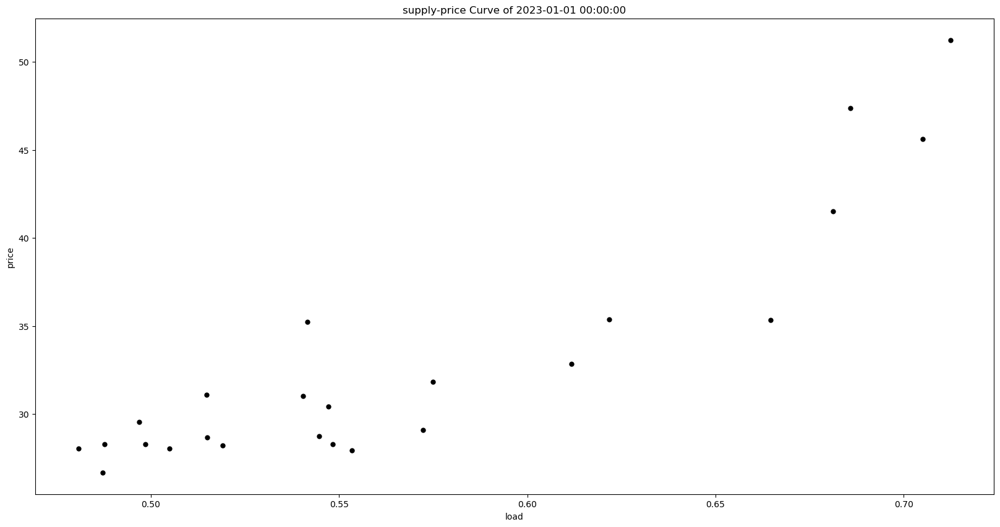

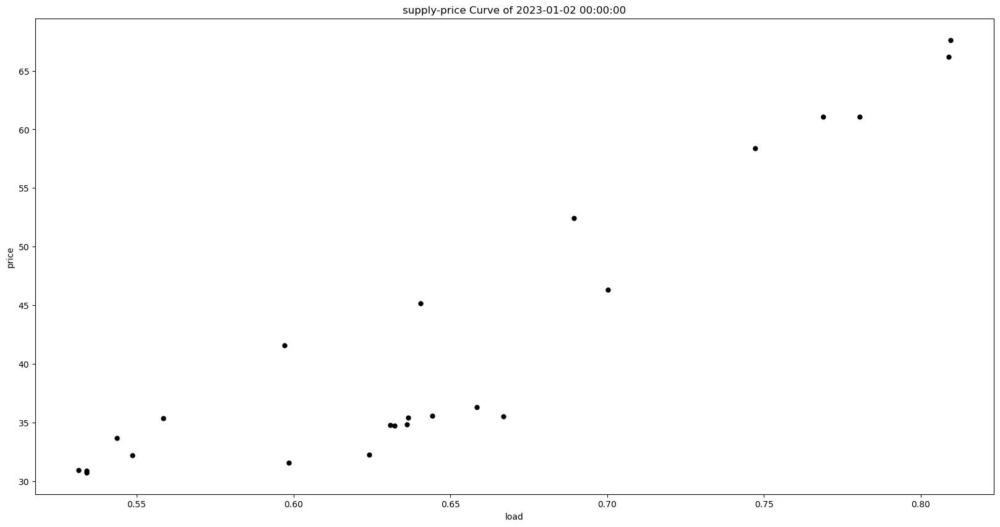

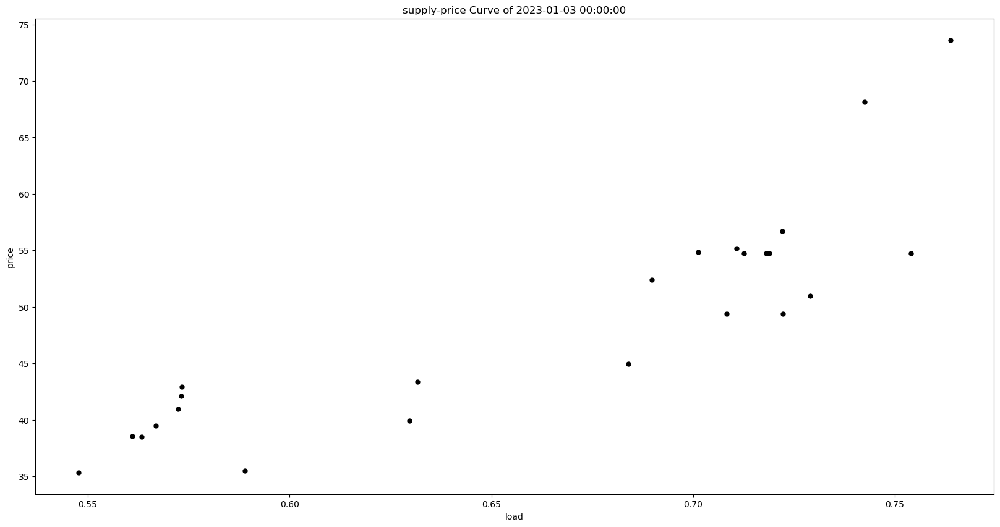

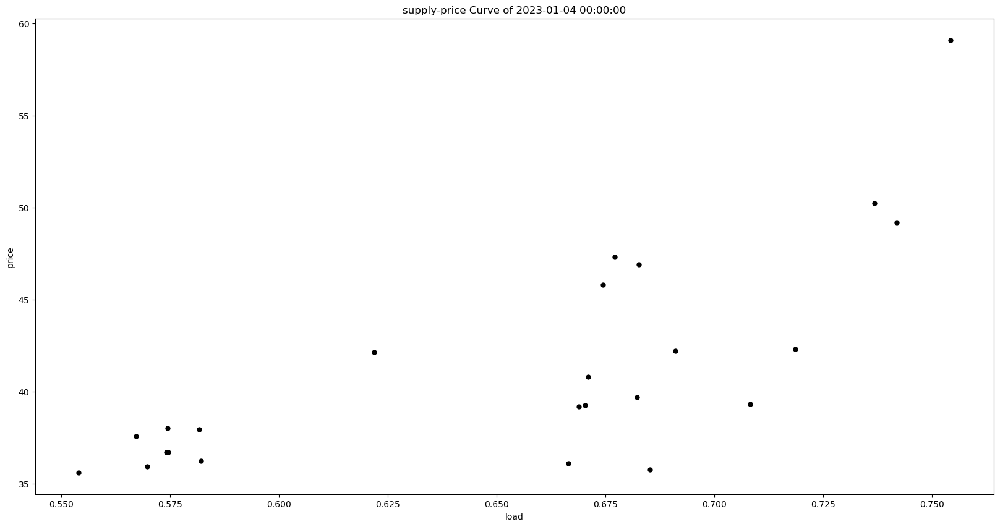

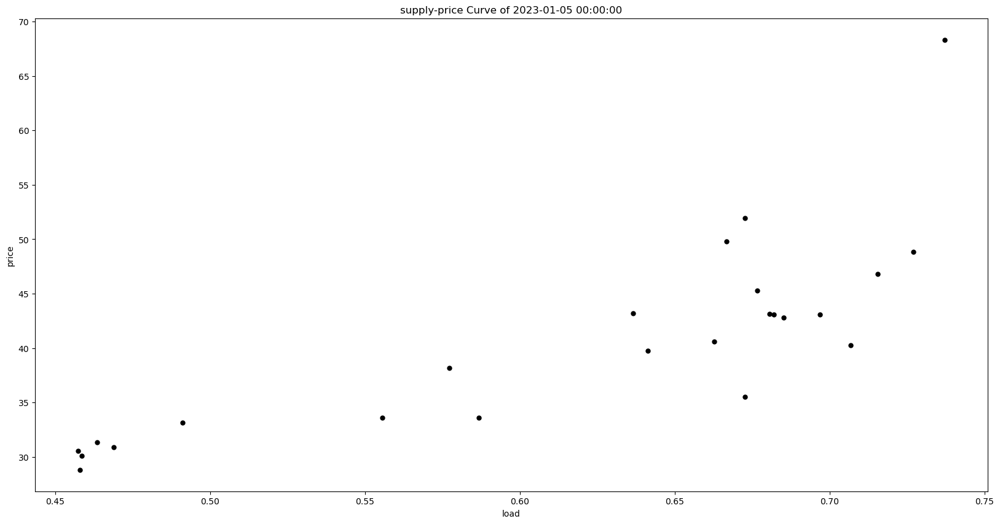

...

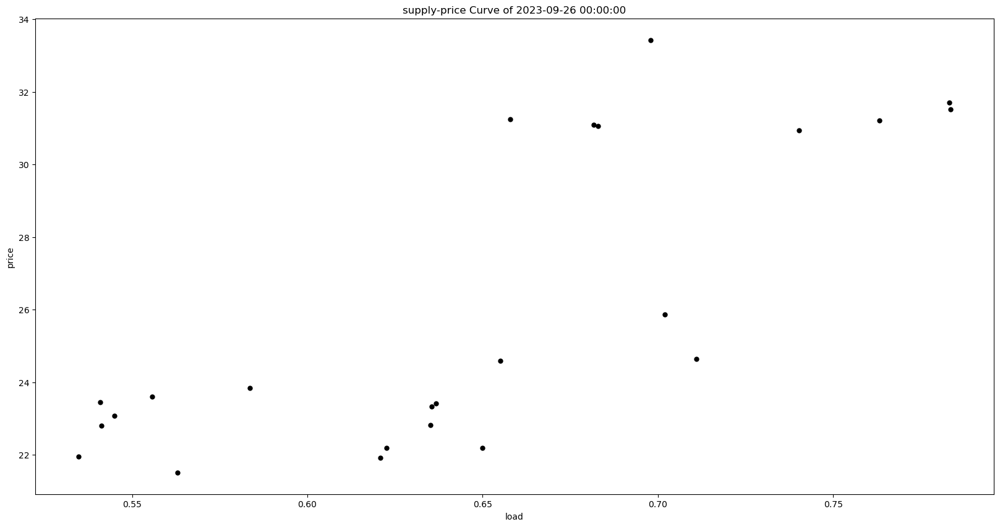

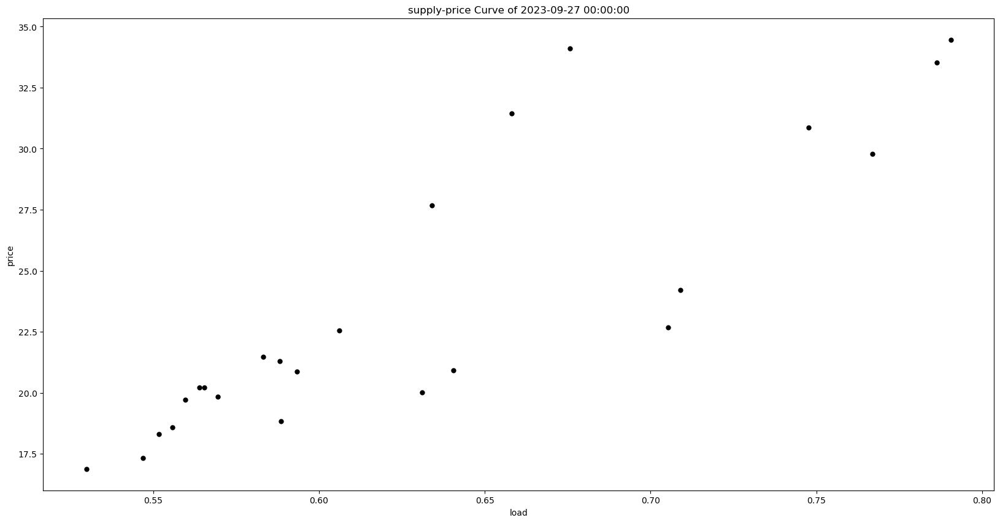

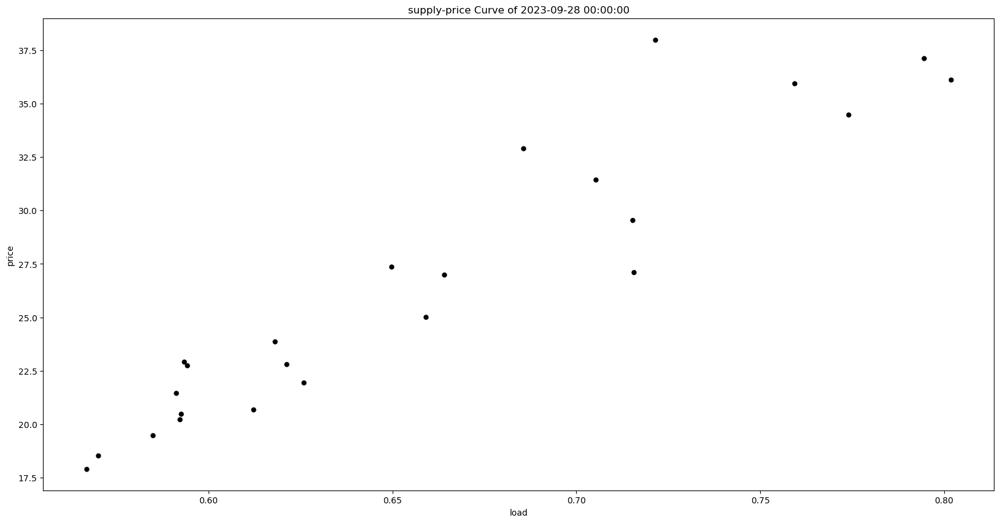

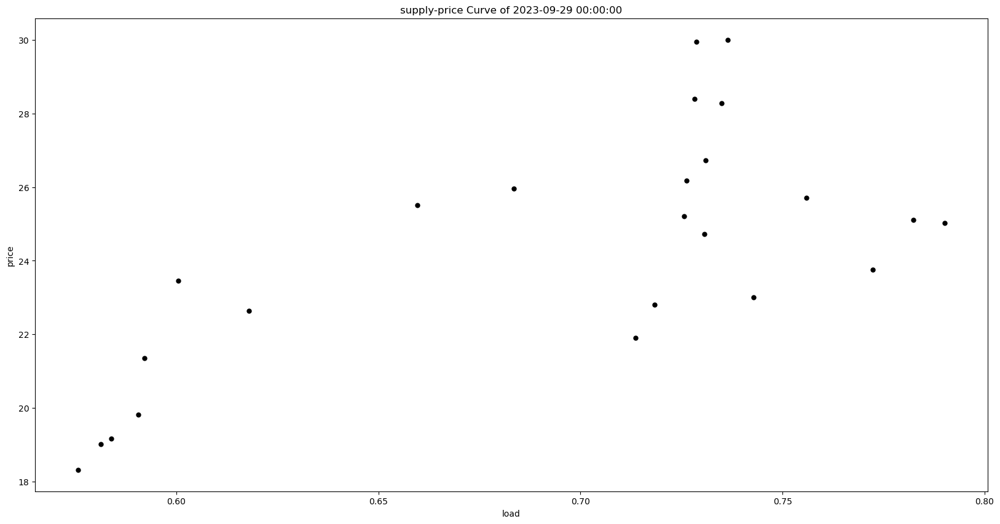

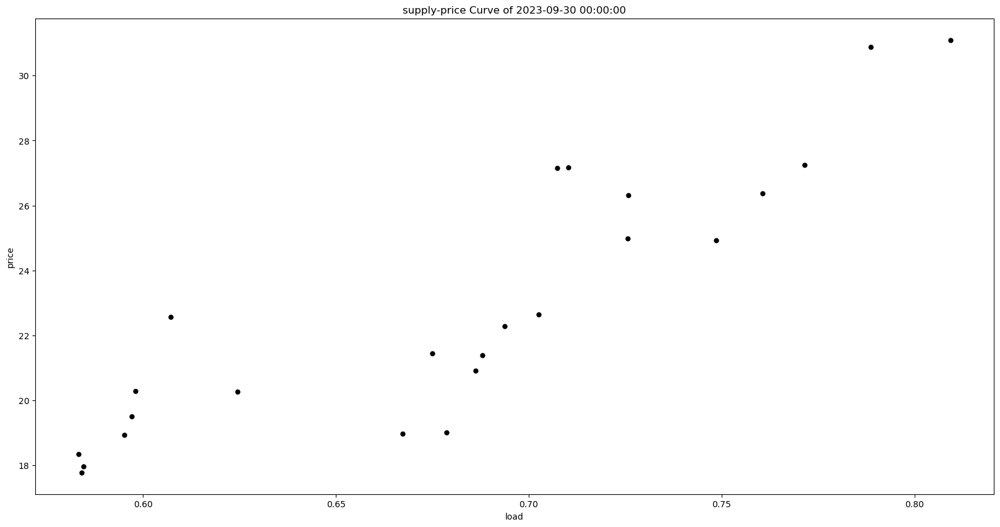

In [116]:
# draw each days' supply-price curve
df_price['Date'] = pd.to_datetime(df_price['Date'])
df_price['Hour Ending'] = df_price['Hour Ending'].astype(int)
df_tmp = pd.merge(df_wind_generation, df_real_load, on=['Date', 'Hour Ending'], how='inner')
df_tmp['thermal'] = df_tmp['Day-Ahead Cleared Demand'] - df_tmp['tot_wind_mwh']
df_tmp = pd.merge(df_tmp, df_capa.drop('Hour Ending', axis=1), on=['Date'], how='inner')
df_tmp['thermal/capa'] = df_tmp['thermal'] / df_tmp['Total Available Capacity']
for _ in pd.date_range(start='2023-01-01', end='2023-10-31'):
    price = df_price[df_price['Date'] == _]['Locational Marginal Price']
    try:
        load = df_tmp[df_tmp['Date'] == _]['thermal/capa']
    except:
        continue
    if len(price) == len(load):

        plt.figure(figsize=(20, 10))
        plt.plot(load, price, 'o', color='black', markersize=5)
        # plt.xticks(time)
        # plt.ylim(0, 400)
        plt.xlabel('load')
        plt.ylabel('price')
        plt.title('supply-price Curve of {}'.format(_))
        plt.show()

In [36]:
def loss(target, prediction):
    if np.isnan(target).all() or np.isnan(prediction).all():
        return 0, 0, 0, 0
    from math import sqrt
    error = []
    pError = []
    for i in range(len(target)):
        error.append(target[i] - prediction[i])
        
        # if target[i] < 55:
        #     a = 55
        # else:
        #     a = target[i]
        # if prediction[i] < 55:
        #     b = 55
        # else:
        #     b = prediction[i]
        pError.append(abs(target[i] - prediction[i]) / ((abs(target[i]) + abs(prediction[i]))/2))

    squaredError = []
    absError = []
    for val in error:
        squaredError.append(val * val)#target-prediction之差平方 
        absError.append(abs(val))#误差绝对值
    mse = sum(squaredError) / len(squaredError)#均方误差MSE
    rmse = sqrt(sum(squaredError) / len(squaredError))#均方根误差RMSE
    mae = sum(absError) / len(absError)#平均绝对误差MAE
    smape = sum(pError) / len(absError)
    return mse, rmse, mae, smape

df_price['Date'] = pd.to_datetime(df_price['Date'])
df_price['Hour Ending'] = df_price['Hour Ending'].astype(int)
def get_price_data(tgt_dt):
    df_1 = df_price[df_price['Date'] == tgt_dt].reset_index(drop=True)
    return df_1

df_predpower_predcapa = pd.merge(df_wind_pred_D1 , df_load_pred_D1, on=['Date', 'Hour Ending'], how='inner')
df_predpower_predcapa = pd.merge(df_predpower_predcapa, df_capa_pred_D1, on=['Date'], how='inner')
df_predpower_predcapa['thermal'] = df_predpower_predcapa['Load(MW)'] - df_predpower_predcapa['Wind(MW)']
df_predpower_predcapa['thermal/capa'] = df_predpower_predcapa['thermal'] / df_predpower_predcapa['Total Generation Available']
# df_predpower_predcapa['thermal/capa'] = df_predpower_predcapa['thermal'] / (df_predpower_predcapa['Total Generation Available'] - df_predpower_predcapa['Projected Surplus/(Deficiency)'])

def get_predpower_predcapa(tgt_dt):
    df_1 = df_predpower_predcapa[df_predpower_predcapa['Date'] == tgt_dt].reset_index(drop=True)
    return df_1

def simulate_by_3_part_line(x, y):
    # initialize piecewise linear fit with your x and y data
    mypwlf1 = pwlf1.PiecewiseLinFit(x, y)
    mypwlf1.fit(3)
    return mypwlf1

def evaluate_model_dist(mypwlf11, mypwlf12, down, up):
    xd = np.linspace(down, up)
    y1, y2 = mypwlf11.predict(xd), mypwlf12.predict(xd)
    y1[y1<0] = 0
    y2[y2<0] = 0
    y1[y1>400] = 400
    y2[y2>400] = 400
    return abs(y1 - y2).sum()

def evaluate_model_accu(mypwlf1, x, y):
    y1 = mypwlf1.predict(x)
    return abs(y1 - y).sum()

def simulate_by_3_part_line1(x, y):
    # initialize piecewise linear fit with your x and y data
    mypwlf1 = pwlf1.PiecewiseLinFit(x, y)
    mypwlf1.use_custom_opt(3)
    xGuess = np.zeros(2)
    xGuess[0] = 0.3 if np.min(x) < 0.3 else np.min(x)+0.05
    xGuess[1] = 0.7 if np.max(x) > 0.7 else np.max(x)-0.05
    res = minimize(mypwlf1.fit_with_breaks_opt, xGuess)
    x0 = np.zeros(4)
    x0[0] = np.min(x)
    x0[-1] = np.max(x)
    x0[1:-1] = res.x
    mypwlf1.fit_with_breaks(x0)
#     if xmin != 0 and xmax != 0:
#         # fit the function with 3 line segments
#         # force the function to go through the data points
#         # where the data points are of the form (x, y)
#         x_c = [xmin, xmax]
#         y_c = [ymin, ymax]
#         res = mypwlf1.fit(3, x_c, y_c)
#     else:
#         res = mypwlf1.fit(3)
    return mypwlf1

df_realpower_realcapa = pd.merge(df_wind_generation, df_real_load, on=['Date', 'Hour Ending'], how='inner')
df_realpower_realcapa = pd.merge(df_realpower_realcapa, df_capa, on=['Date'], how='inner')
df_realpower_realcapa['thermal'] = df_realpower_realcapa['Day-Ahead Cleared Demand'] - df_realpower_realcapa['tot_wind_mwh']
df_realpower_realcapa['thermal/capa'] = df_realpower_realcapa['thermal'] / df_realpower_realcapa['Total Available Capacity']
# df_realpower_realcapa['thermal/capa'] = df_realpower_realcapa['thermal'] / (df_realpower_realcapa['Total Available Capacity'] - df_realpower_realcapa['Surplus Deficiency'])

def get_realpower_realcapa(tgt_dt):
    df_1 = df_realpower_realcapa[df_realpower_realcapa['Date'] == tgt_dt].reset_index(drop=True)
    return df_1

def calculate_dist(mypwlf1, tgt_day):
    y = get_price_data(tgt_day)['Locational Marginal Price']
    x = get_realpower_realcapa(tgt_day)['thermal/capa']
    y_pred = mypwlf1.predict(x)
    y_pred[y_pred<0] = 0
    y_pred[y_pred>400] = 400
    mse, rmse, mae, smape = loss(y, y_pred)
#     xd = np.linspace(0, 1)
#     plt.plot(xd, mypwlf1.predict(xd))
#     plt.scatter(x, y, s = 20)
#     plt.title(tgt_day)
#     plt.show()
    return mae, smape


204.2768366749333
5.7417790383162535 5.741779038316333 5.7417790383162535


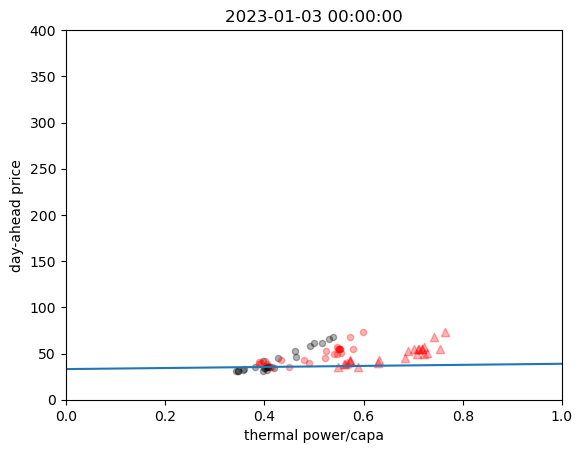

109.20306764891453
204.27683667493312
114.6597632427289 114.65976324272881 114.65976324272891


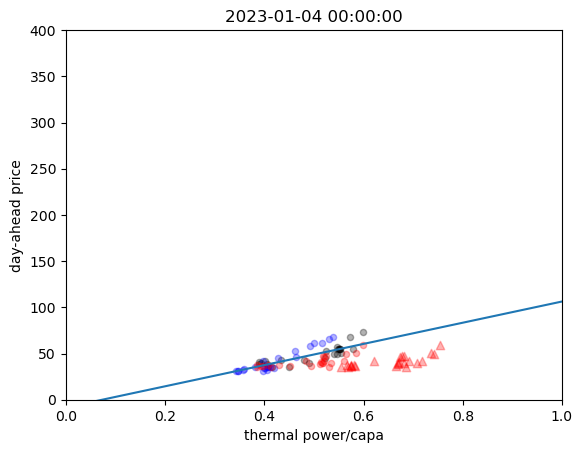

88.89908515445974
109.20306764891453
204.27683667493312
81.37121051825319 81.37121051825322 81.37121051825325


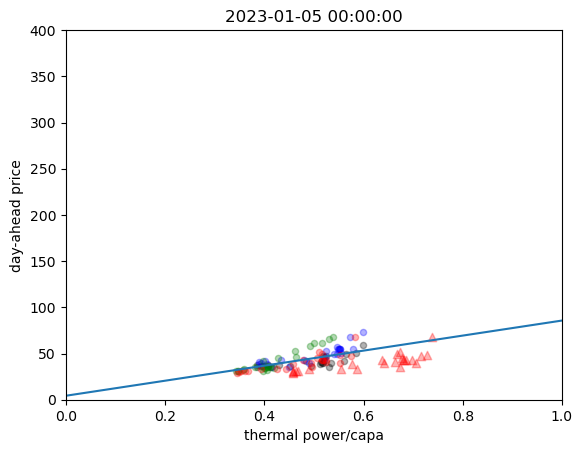

72.30757683635437
88.89908515445961
109.20306764891453
204.27683667493312
85.31028747696377 85.3102874769637 85.31028747696375


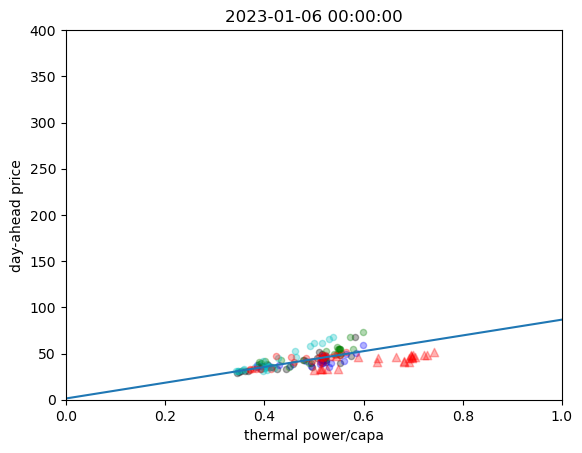

110.33483938939769
72.30757683635429
88.89908515445975
109.20306764891441
89.43540348266689 89.4354034826668 89.43540348266671


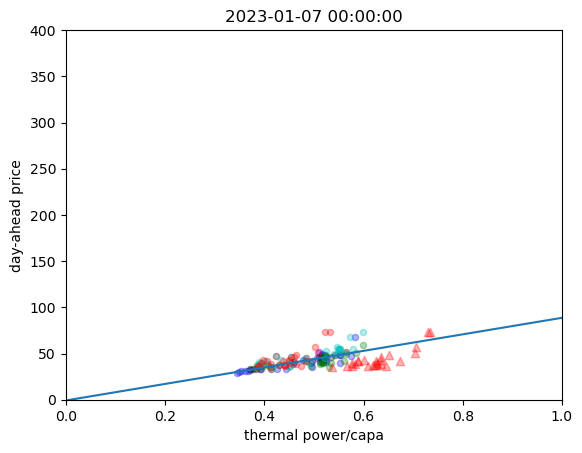

148.05709703947363
110.33483938939756
72.30757683635434
88.89908515445961
81.20530587045381 81.20530587045386 81.20530587045373


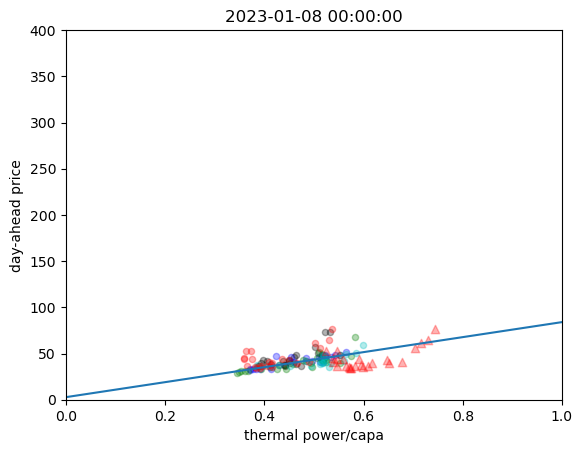

180.8301233552632
148.05709703947363
110.33483938939747
72.30757683635423
76.53629301411458 76.53629301411453 76.53629301411449


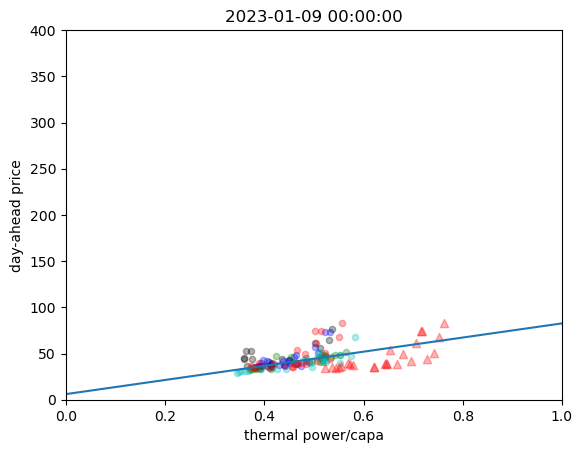

239.8577138157895
180.8301233552632
148.05709703947363
110.33483938939769
72.64728277823367 72.64728277823367 72.64728277823373


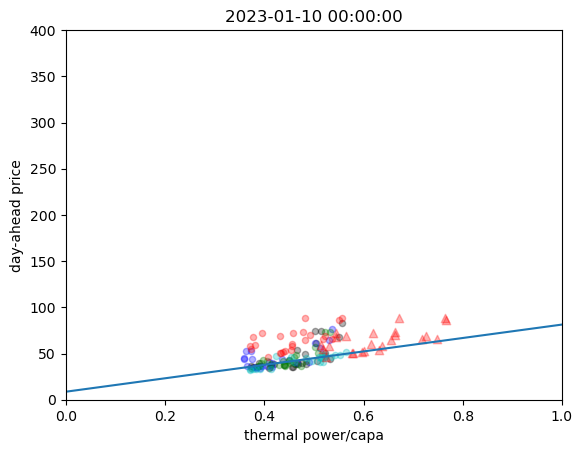

227.97494243421056
239.8577138157895
180.8301233552632
148.05709703947363
0.0 168.551100815731 168.55110081573102


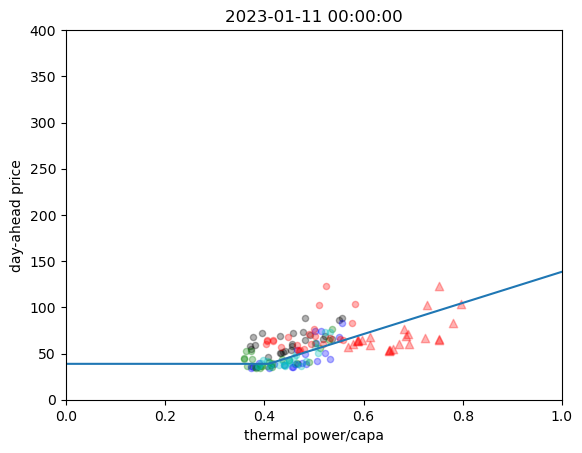

256.21192434210525
227.97494243421056
239.8577138157895
180.8301233552632
18.455724920020426 144.0515154542043 144.05151545420424


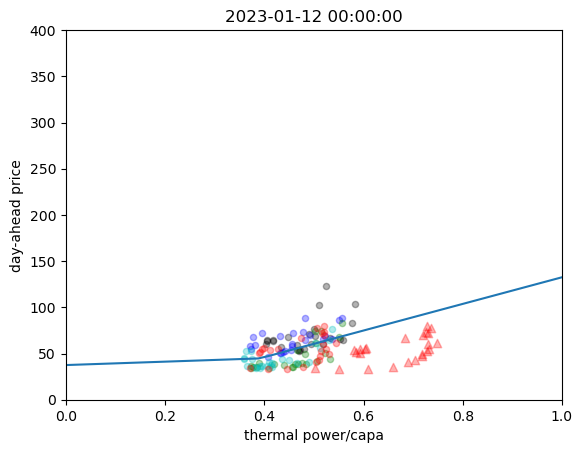

258.36393914473683
256.21192434210525
227.97494243421056
239.8577138157895
80.64400921146971 80.6440092114698 80.6440092114699


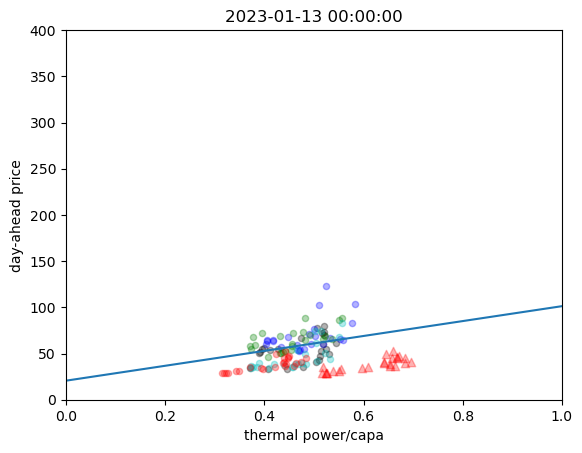

134.4231344497492
258.36393914473683
256.21192434210525
227.97494243421056
134.0476284116264 134.04762841162633 134.04762841162625


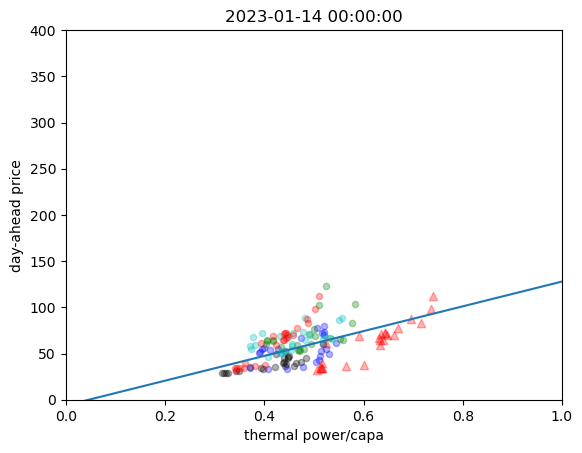

313.49779699438204
134.4231344497492
258.36393914473683
256.21192434210525
169.62052115529363 169.62052115529374 169.62052115529374


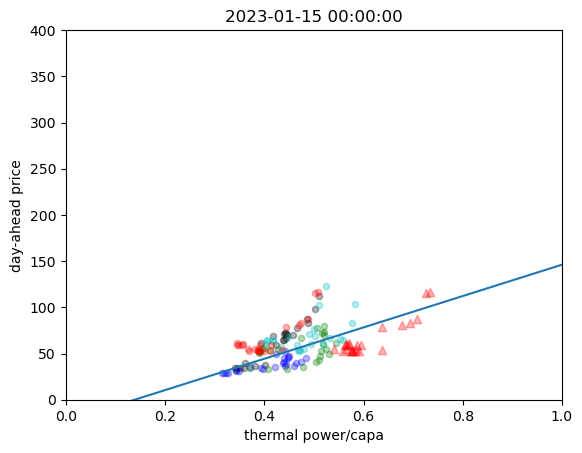

275.39578125
313.4977969943821
134.4231344497492
258.36393914473683
57.167350116658625 57.16735011665859 57.167350116658625


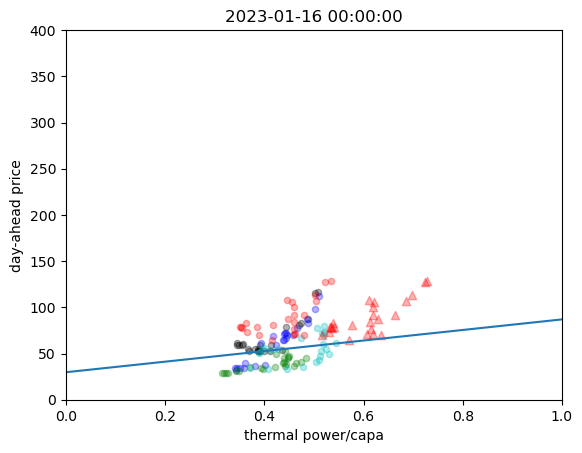

338.5169654605263
275.39578125
313.4977969943821
134.42313444974928
310.1771283786647 310.1771283786648 310.17712837866446


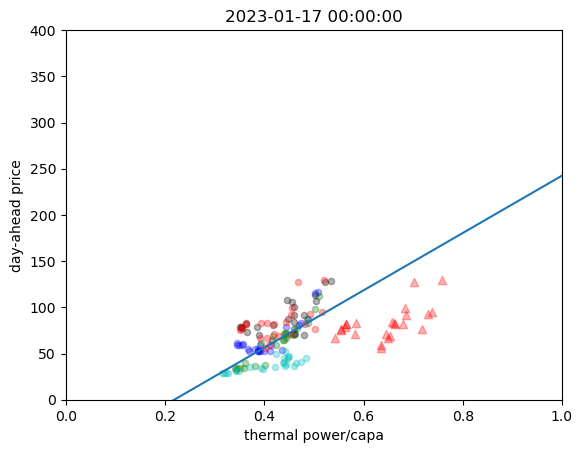

283.0547286184211
338.5169654605263
275.39578125
313.4977969943821
2.8601436226642325 270.9690333275877 270.9690333275876


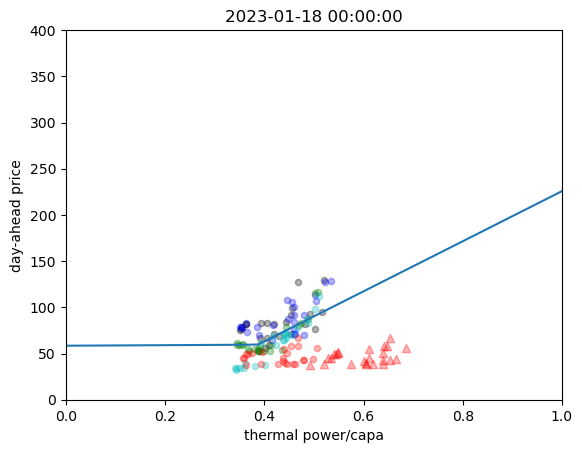

147.1038322368421
283.0547286184211
338.5169654605263
275.39578125
107.76608283343509 107.76608283343518 107.76608283343509


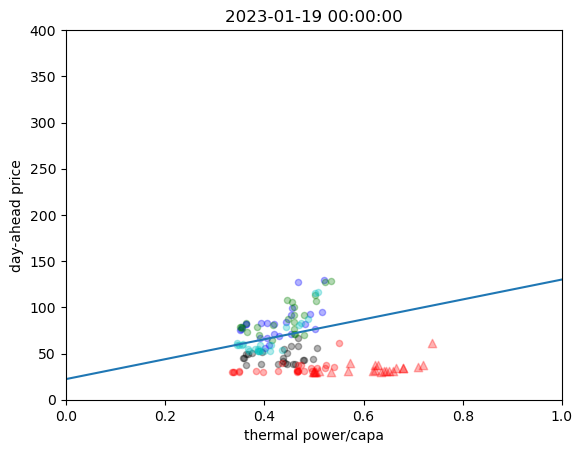

81.9949917763158
147.1038322368421
283.0547286184211
338.5169654605263
0.0 0.0 0.0


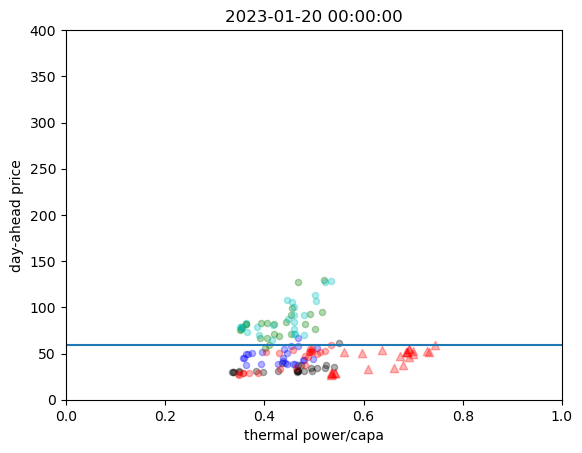

221.86873355263162
81.9949917763158
147.1038322368421
283.0547286184211
0.0 0.0 0.0


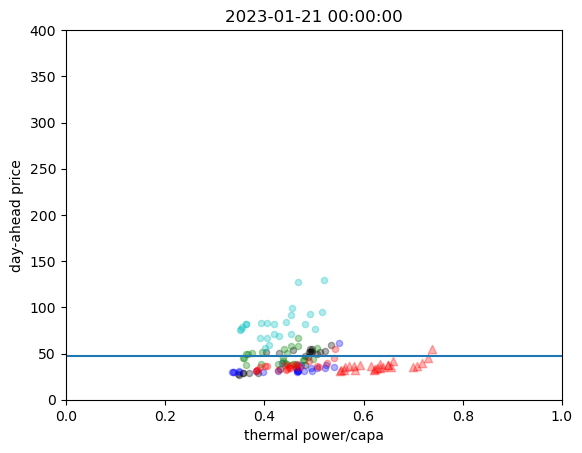

78.43305921052635
221.86873355263162
81.9949917763158
147.1038322368421
49.009862616735816 49.009862616735845 49.00986261673576


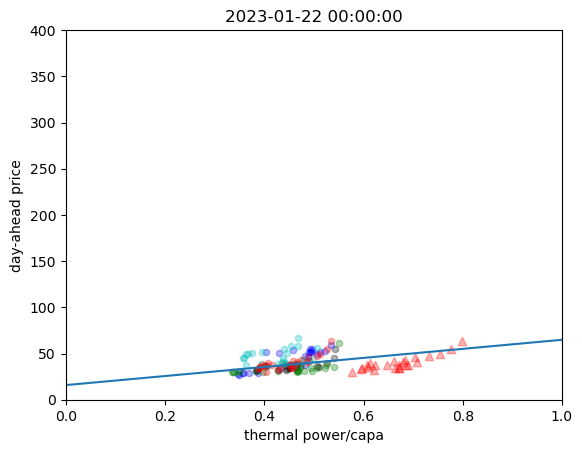

127.69261513157895
78.43305921052635
221.86873355263162
81.9949917763158
61.92406077109199 61.92406077109206 61.92406077109206


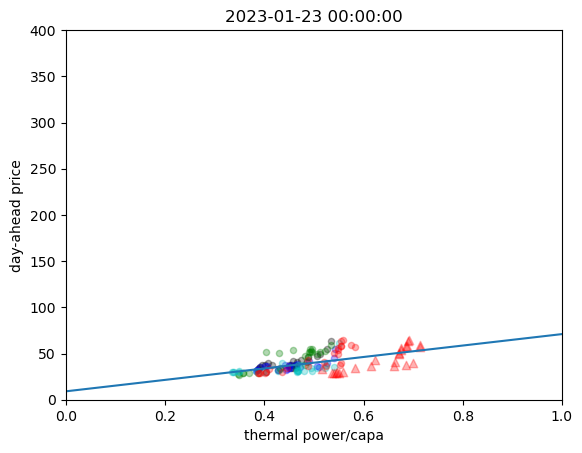

143.4020340179124
127.69261513157895
78.43305921052635
221.86873355263162
108.53102487625189 110.76338109638534 110.76338109638546


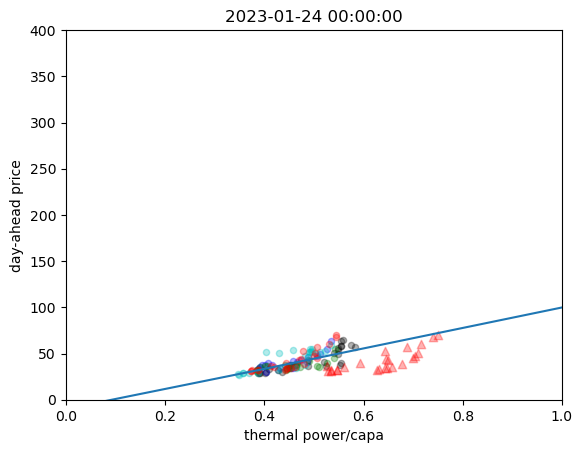

176.10935650337348
143.4020340179124
127.69261513157895
78.43305921052635
59.27253827128514 137.3238304116801 137.32383041168023


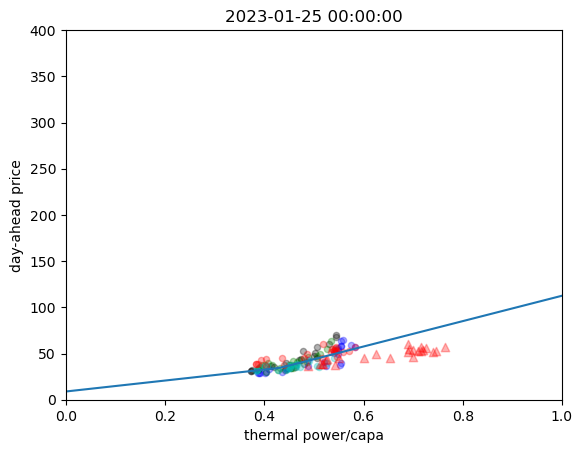

77.52718263776956
176.10935650337348
143.40203401791246
127.69261513157895
111.91899377020013 129.27791957881024 129.27791957881016


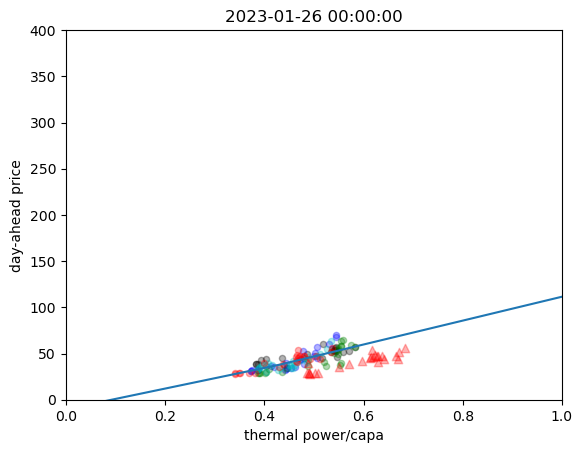

128.5634142654978
77.52718263776956
176.10935650337348
143.40203401791257
112.08417640930487 127.66626631709363 127.6662663170936


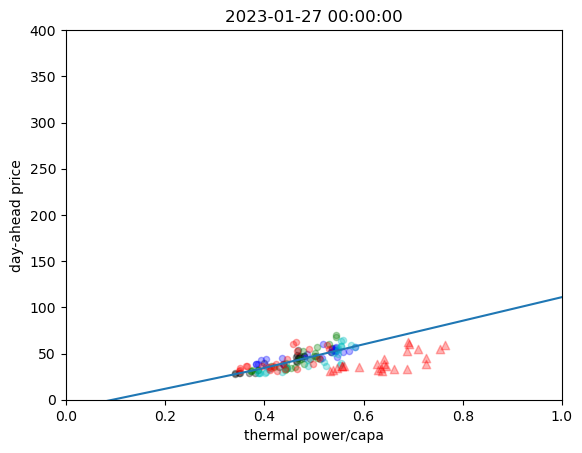

179.4133388157895
128.5634142654978
77.52718263776956
176.10935650337348
121.34709348475215 121.34709348475221 121.34709348475215


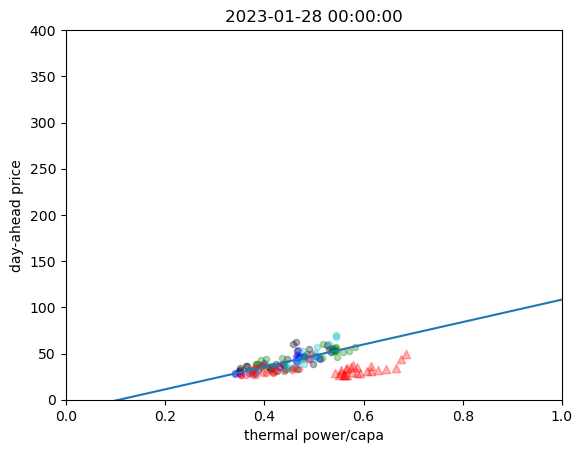

95.67254111842107
179.4133388157895
128.5634142654978
77.52718263776956
118.52548307351145 118.52548307351142 118.52548307351132


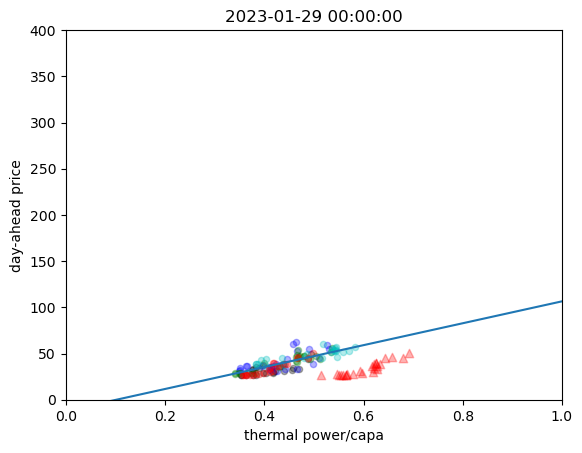

146.89891447368421
95.67254111842107
179.4133388157895
128.5634142654978
124.42130343960261 124.42130343960251 124.42130343960261


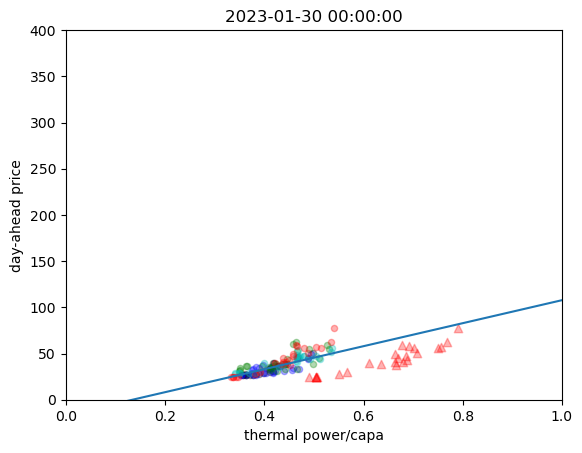

93.84287247008209
146.89891447368421
95.67254111842107
179.4133388157895
113.23875901216307 170.38394180370977 170.3839418037099


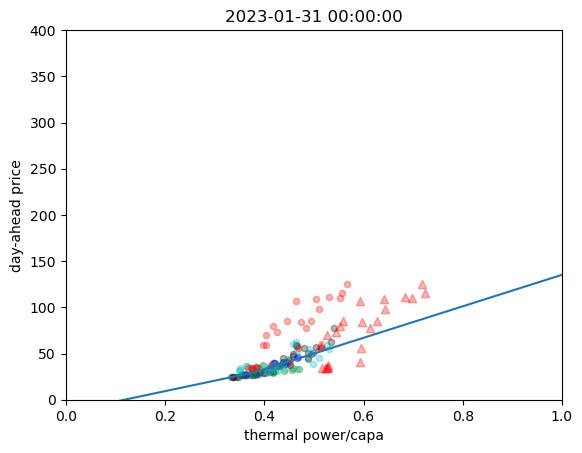

424.9010012123811
93.84287247008204
146.89891447368421
95.67254111842107
144.88542450119613 190.79263798160736 190.7926379816075


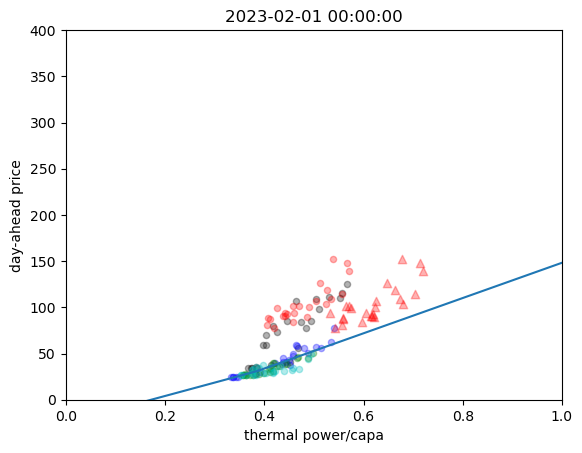

333.291159398199
424.90100121238095
93.84287247008209
146.89891447368421
164.75063023489756 484.19337743884506 484.19337743884466


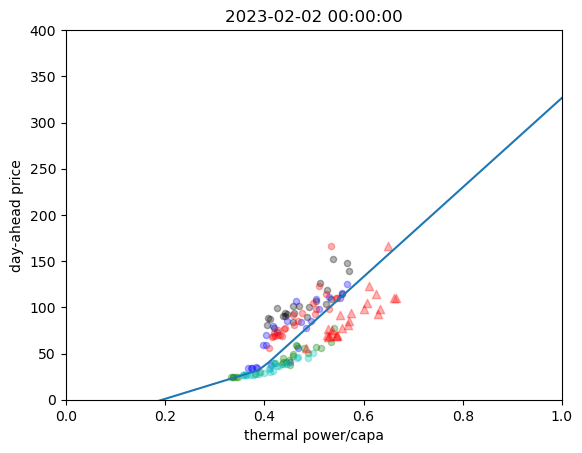

436.528552631579
333.291159398199
424.901001212381
93.84287247008204
357.0025907890641 357.00259078906424 357.0025907890638


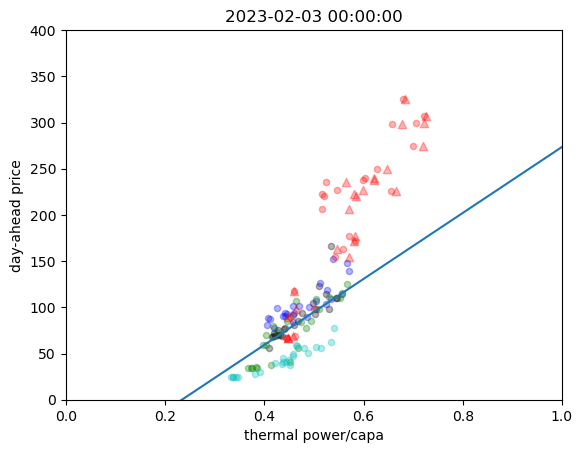

844.336422089669
436.528552631579
333.291159398199
424.90100121238146
623.1515969072921 623.1515969072921 623.151596907291


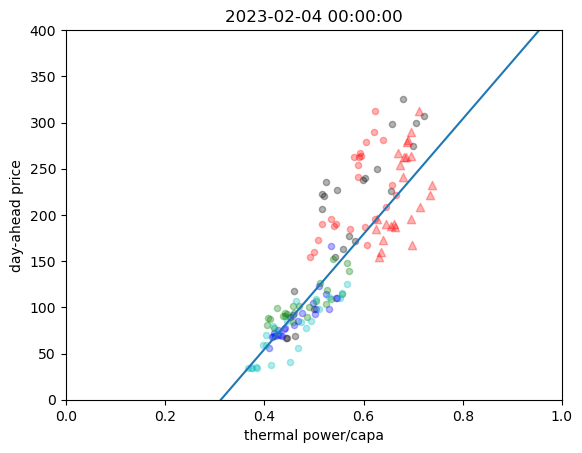

972.1097944078946
844.3364220896681
436.528552631579
333.291159398199
525.9149307366828 757.2561585960959 757.2561585960965


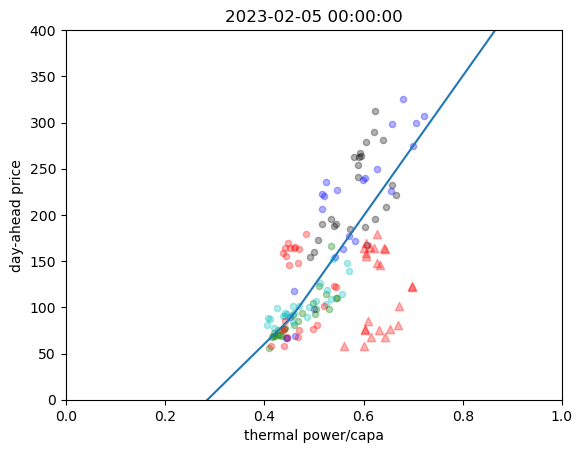

955.4328618421052
972.1097944078946
844.3364220896686
436.528552631579
771.4288266688861 771.428826668886 771.4288266688867


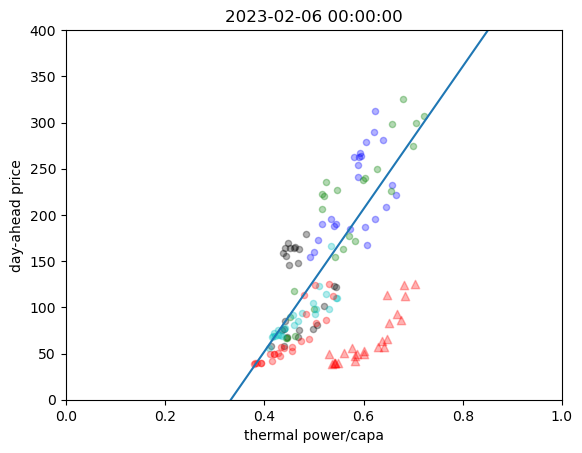

433.4728956011238
955.4328618421052
972.1097944078946
search 2 days for 3 part
255.36708834503548 255.36708834503577 255.36708834503577


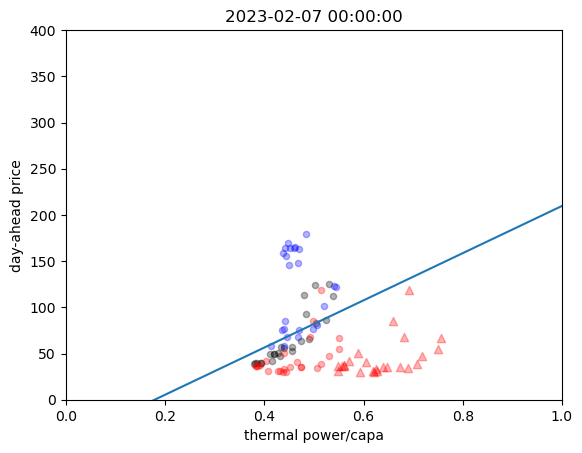

284.9759703947368
433.4728956011238
955.4328618421052
972.1097944078946
search 3 days for 3 part
318.49649490859457 318.49649490859434 318.4964949085949


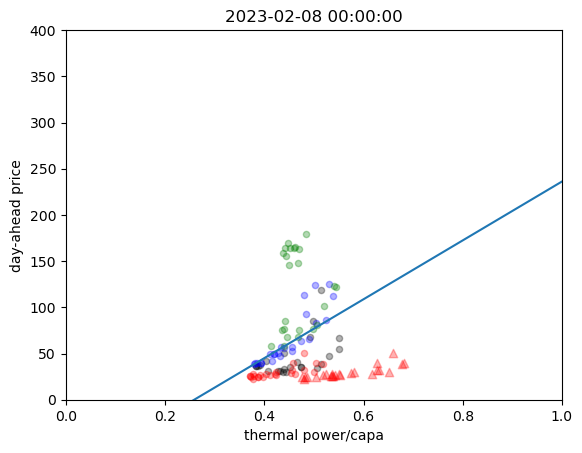

101.00178453947368
284.9759703947368
433.4728956011238
955.4328618421052
277.95807971016126 277.95807971016126 277.95807971016137


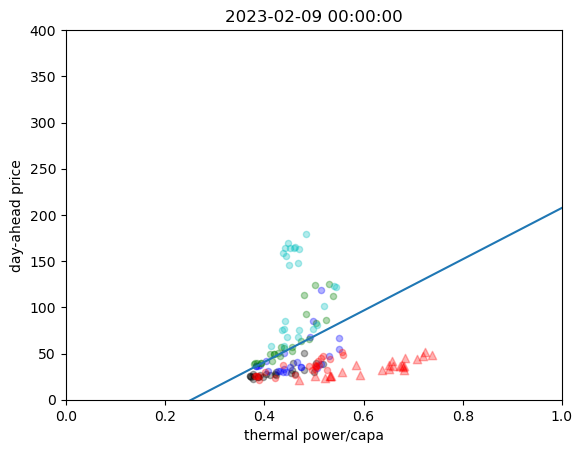

111.95649307619968
101.00178453947368
284.9759703947368
433.4728956011238
106.55629784726482 106.55629784726477 106.55629784726476


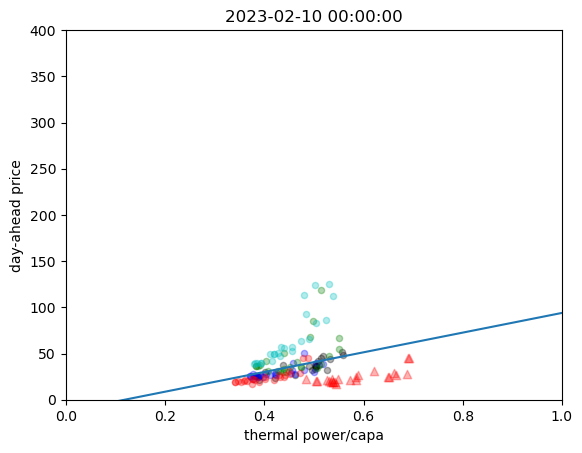

110.71373355263157
111.95649307619968
101.00178453947368
284.9759703947368
112.30137923887955 112.30137923887959 112.30137923887956


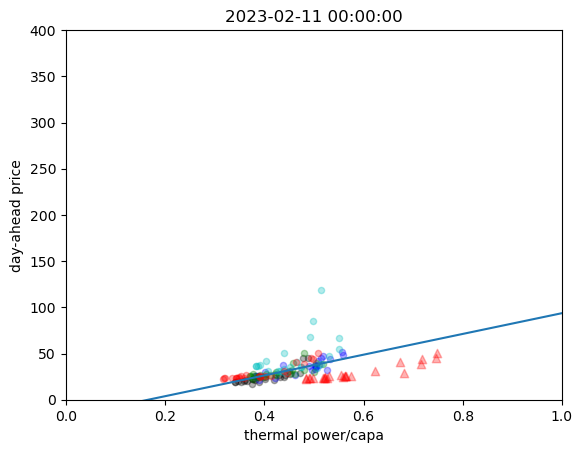

91.92353753212879
110.71373355263157
111.95649307619968
101.00178453947368
2.060646104442888 97.3837196068797 97.38371960687977


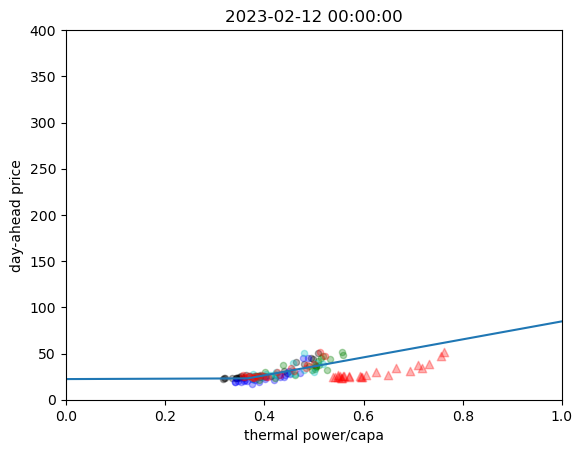

114.59323190789475
91.92353753212873
110.71373355263157
111.95649307619968
20.146079678580673 105.30425306126655 105.30425306126664


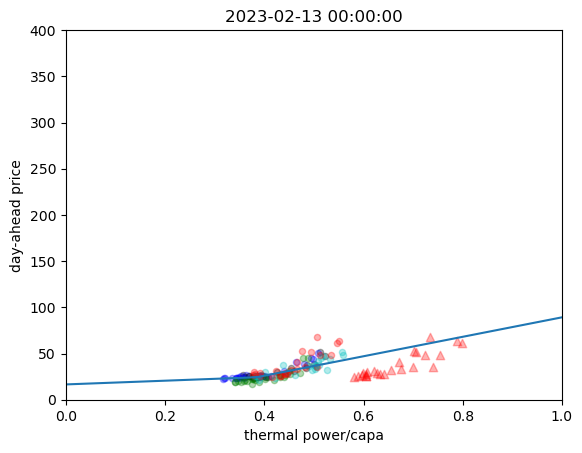

207.97662269045586
114.59323190789475
91.92353753212879
110.71373355263157
38.73896992559139 177.10020434981976 177.10020434981982


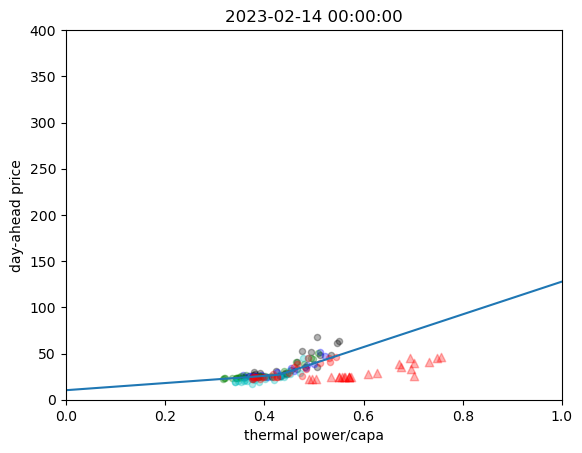

128.56844660801332
207.97662269045577
114.59323190789475
91.92353753212868
25.726499396631997 141.20433436978217 141.20433436978234


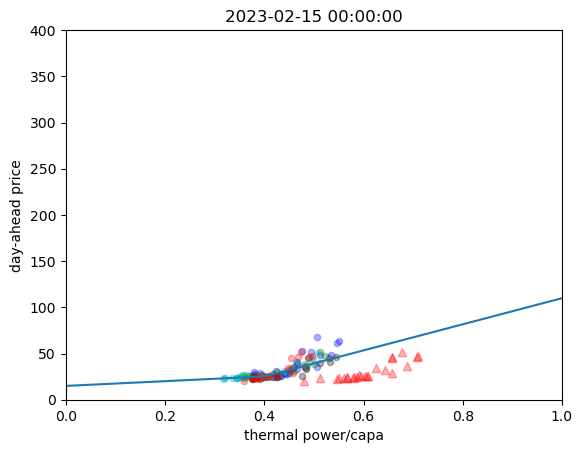

160.21671874999998
128.56844660801332
207.97662269045588
114.59323190789475
35.318417319363775 144.5335642062105 144.53356420621034


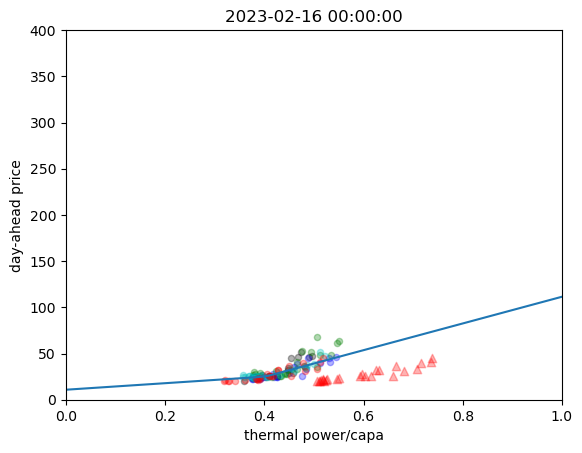

86.99564832054101
160.21671874999998
128.56844660801332
207.9766226904559
3.8773752531509524 123.99900029555901 123.99900029555897


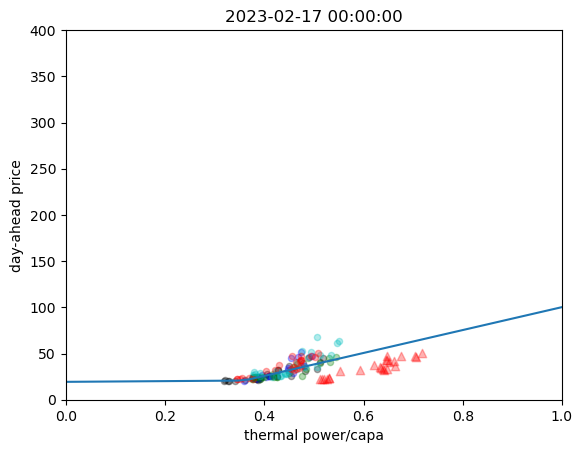

181.37285361842106
86.99564832054101
160.21671874999998
128.56844660801332
64.27079338255244 143.40897755895952 143.4089775589597


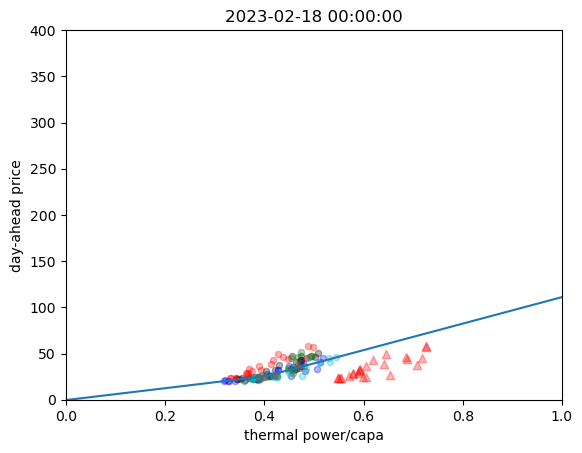

207.08528782894737
181.37285361842106
86.99564832054101
160.21671874999998
60.517722493858464 149.8073867495889 149.8073867495889


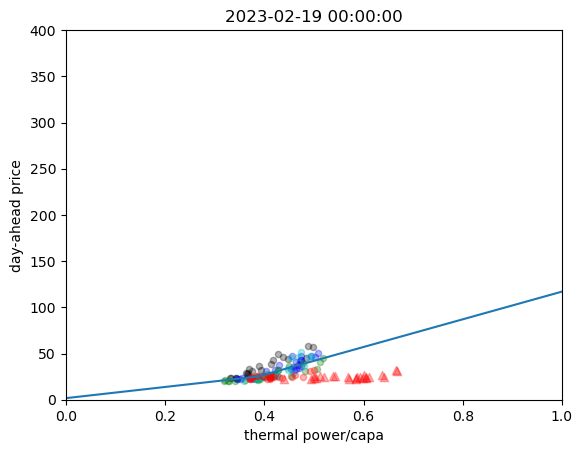

37.42939144736842
207.08528782894737
181.37285361842106
86.99564832054101
66.63739208400698 98.20045632956808 98.20045632956794


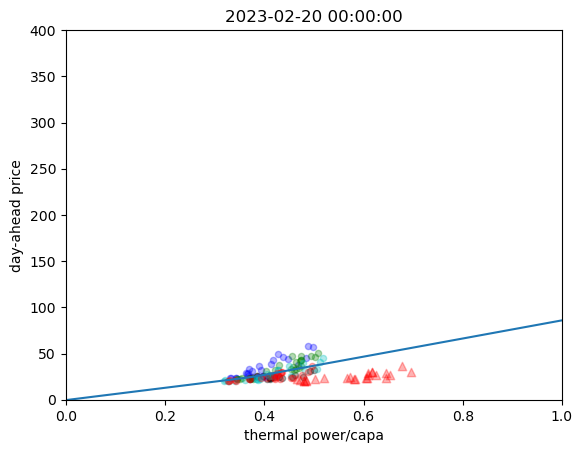

71.8437582236842
37.42939144736842
207.08528782894737
181.37285361842106
72.59553779346868 72.59553779346865 72.59553779346861


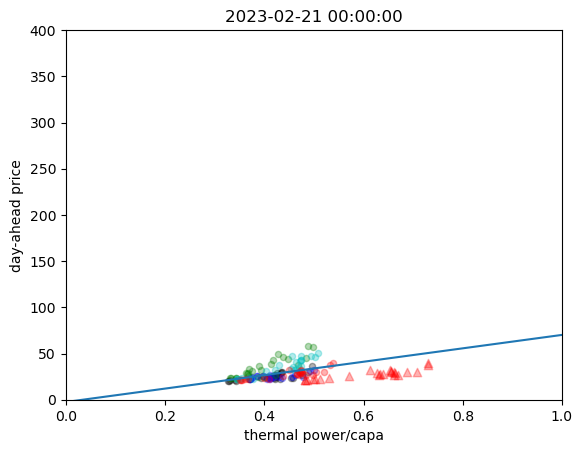

50.608037545215666
71.8437582236842
37.42939144736842
207.08528782894737
40.14509274392666 40.145092743926625 40.14509274392666


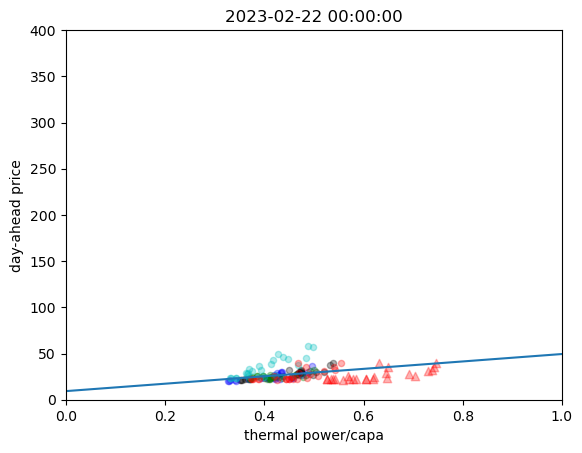

102.42324835526315
50.608037545215666
71.84375822368419
37.42939144736842
44.360220484356184 50.406393732949525 50.40639373294954


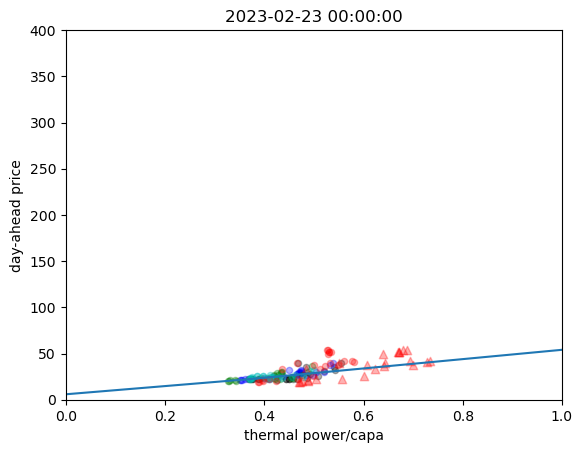

189.8925745223933
102.42324835526315
50.608037545215666
71.84375822368419
51.52031404512584 103.21427090858427 103.21427090858441


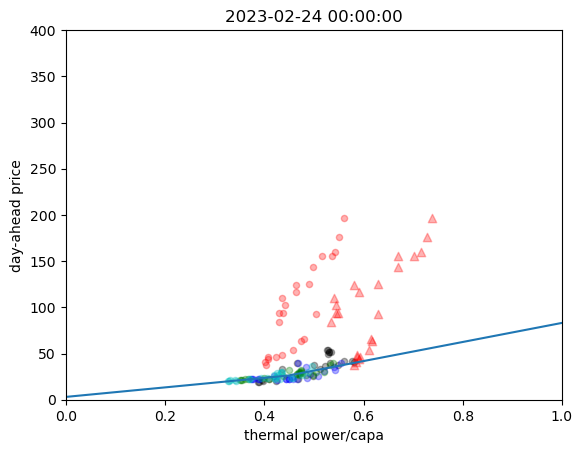

946.075209531635
189.89257452239332
102.42324835526315
50.608037545215666
90.33164115989771 90.33164115989776 90.33164115989754


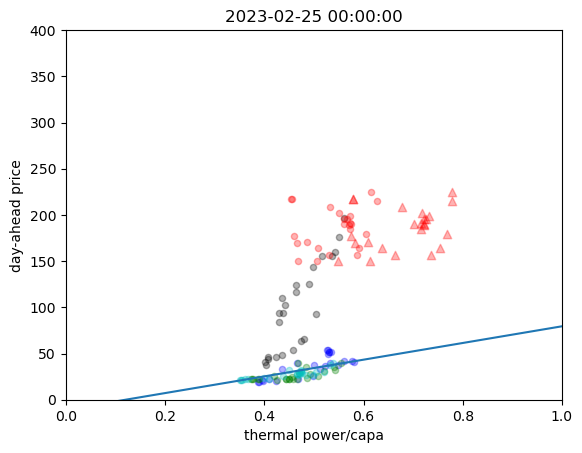

434.51096959737066
946.075209531635
189.89257452239343
search 2 days for 3 part
624.0829021182673 624.0829021182674 624.0829021182668


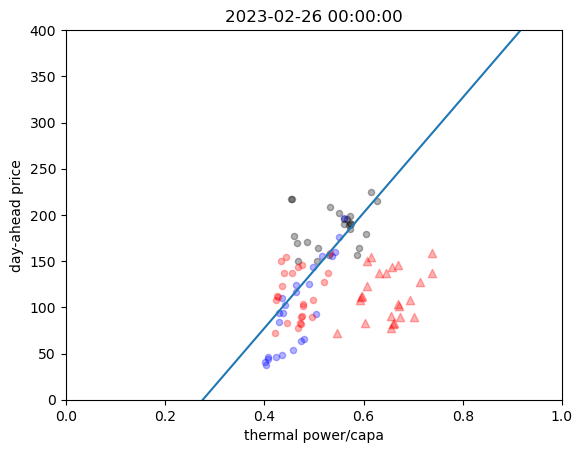

548.186992604766
434.51096959737066
946.075209531635
189.89257452239332
581.9473696358374 581.9473696358374 581.9473696358369


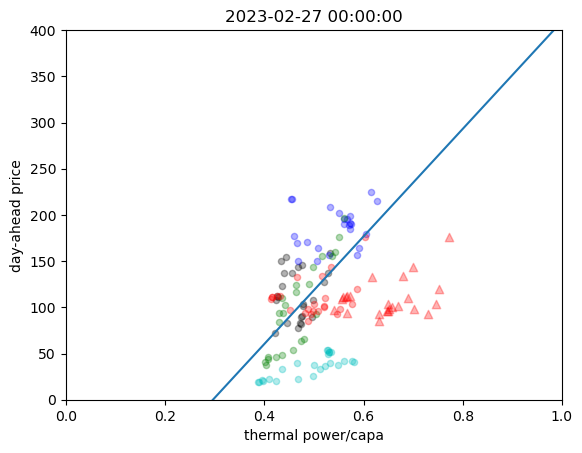

320.1265242399342
548.186992604766
434.51096959737066
946.075209531635
349.7805146334199 349.7805146334198 349.78051463341984


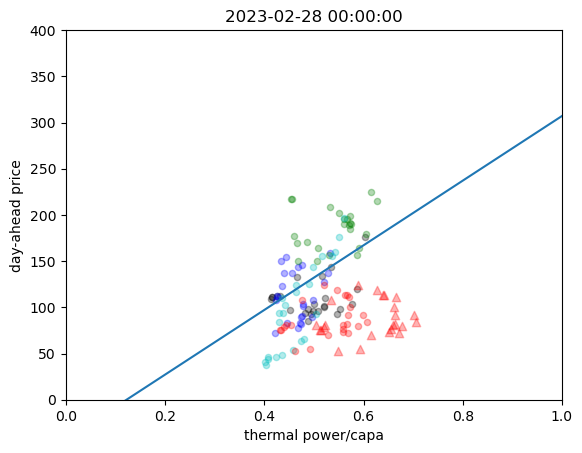

348.8426294165982
320.1265242399342
548.186992604766
434.51096959737066
0.0 0.0 0.0


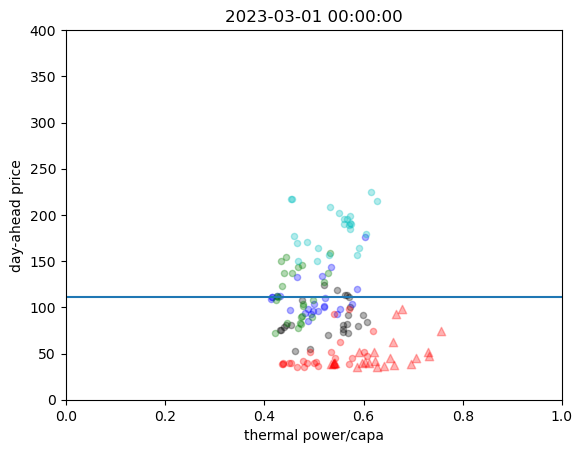

244.56252259654892
348.8426294165982
320.1265242399342
548.186992604766
0.0 0.0 0.0


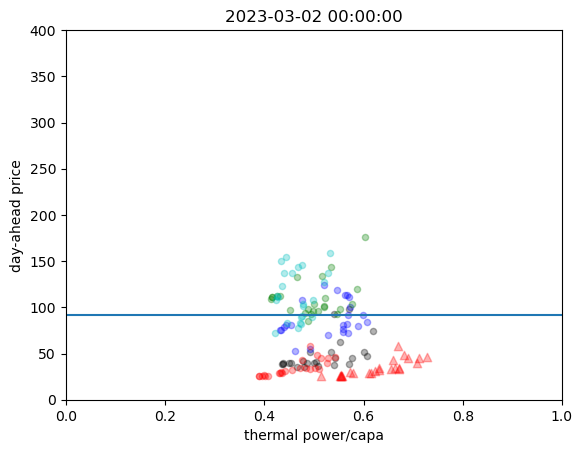

119.17930293388024
244.56252259654892
348.8426294165982
320.1265242399342
268.72001247787836 268.7200124778784 268.72001247787813


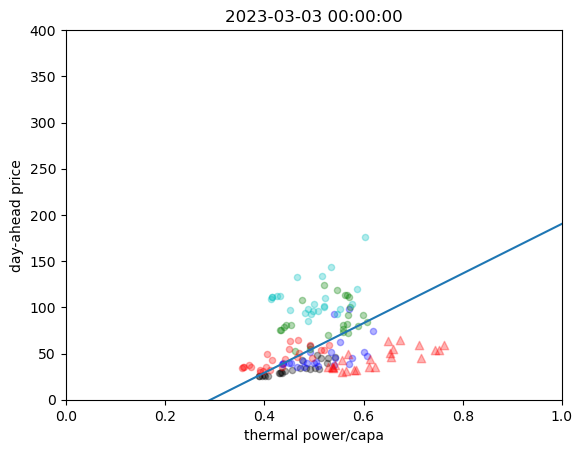

169.50350118179264
119.17930293388031
244.56252259654892
348.8426294165982
0.0 191.0702008297479 191.07020082974782


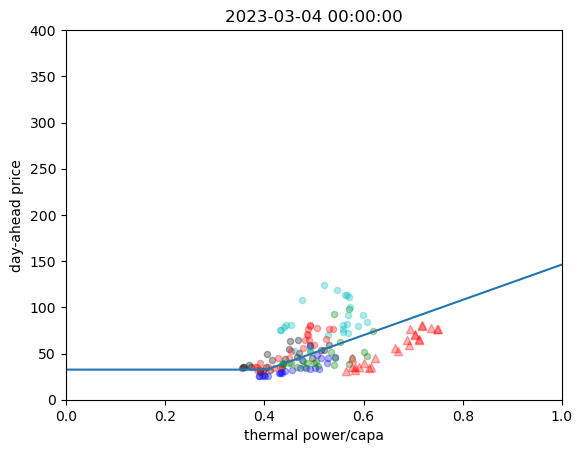

196.3619336767208
169.50350118179264
119.17930293388028
244.56252259654892
6.794891220786434 74.45103690557711 74.45103690557723


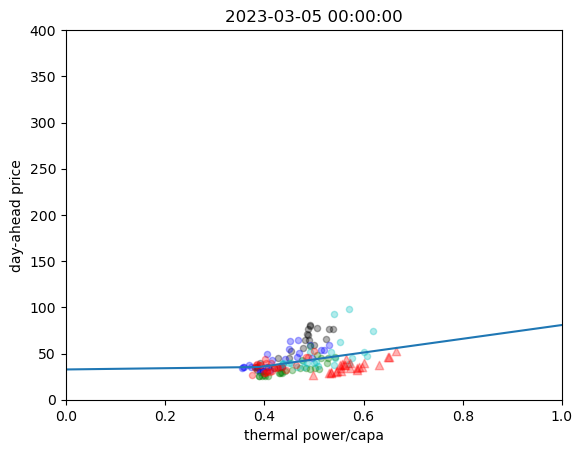

113.82938373048482
196.36193367672075
169.50350118179264
119.17930293388025
0.0 125.41985707998973 125.41985707998978


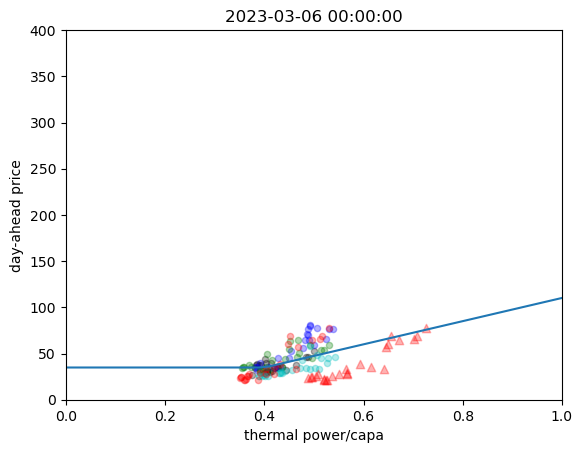

277.9513520861443
113.82938373048482
196.36193367672092
169.50350118179264
219.7015570461903 219.7015570461903 219.70155704619023


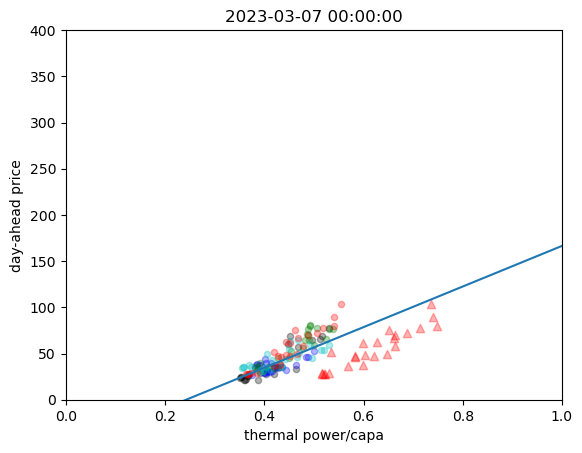

207.81520725470614
277.95135208614414
113.82938373048482
196.36193367672092
234.89666650842426 300.233186105814 300.2331861058141


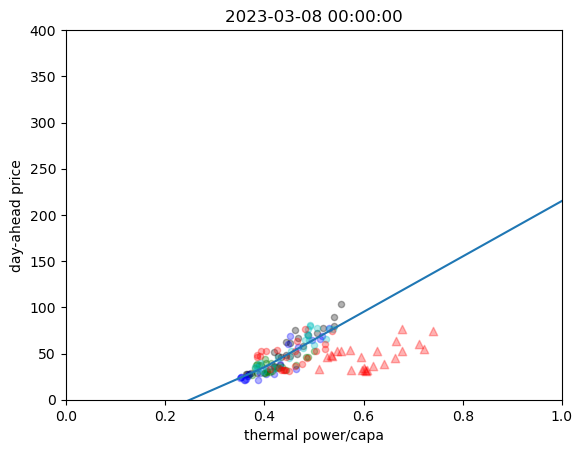

250.32244864420716
207.8152072547061
277.95135208614425
113.82938373048482
215.995468127198 215.995468127198 215.99546812719817


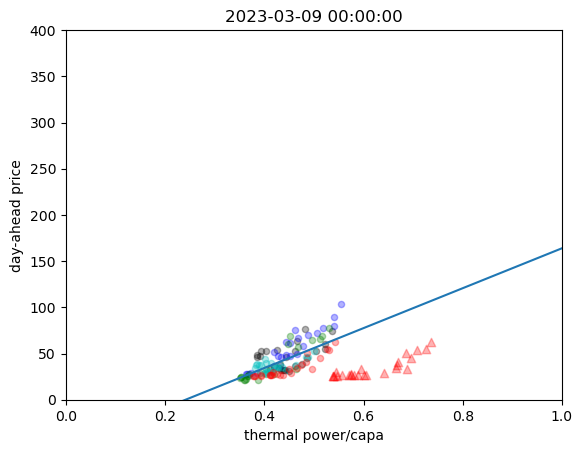

163.2494026677863
250.32244864420716
207.8152072547063
277.9513520861442
195.96434096584963 195.96434096584963 195.9643409658497


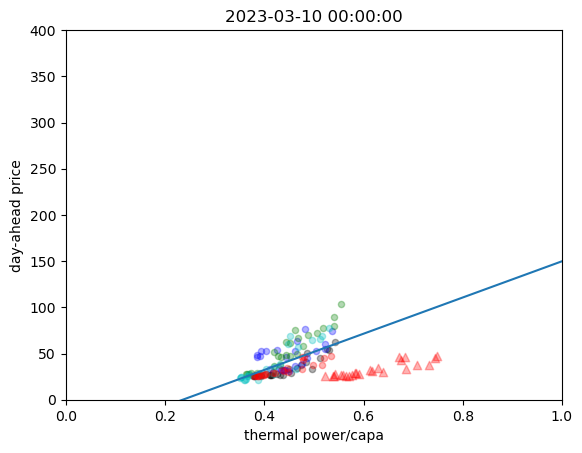

91.2084704575998
163.2494026677863
250.32244864420716
207.81520725470654
159.11391663702287 190.62831651983717 190.6283165198374


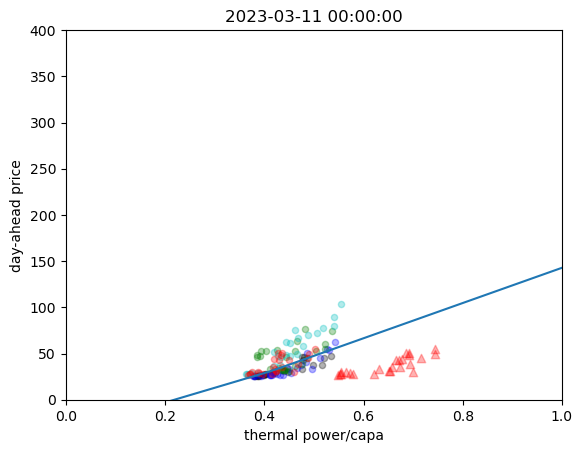

185.93041906327034
91.2084704575998
163.2494026677863
250.32244864420716
136.95343400107018 136.9534340010702 136.9534340010701


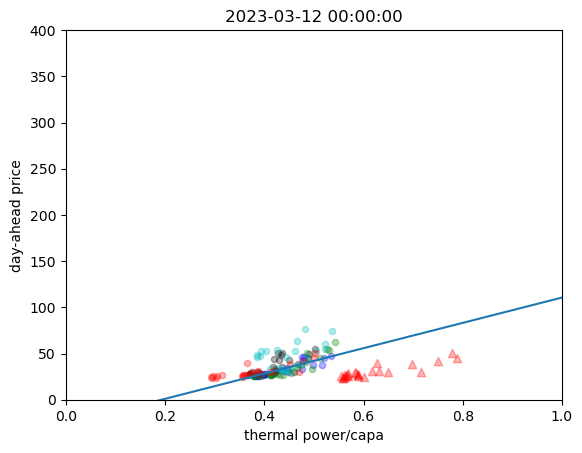

93.85610640229277
185.93041906327034
91.2084704575998
163.24940266778628
0.0 79.83520915223512 79.8352091522351


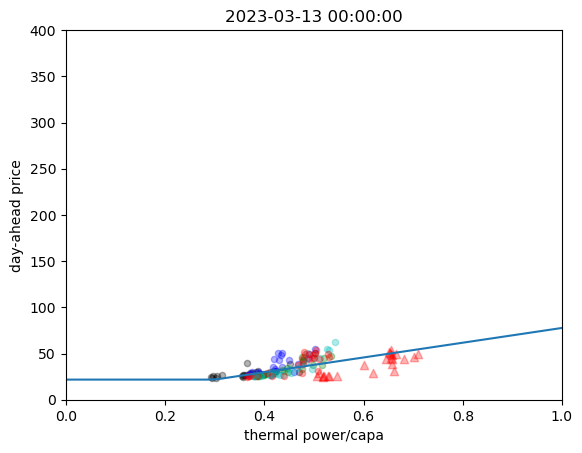

121.09371970944159
93.85610640229277
185.93041906327034
91.2084704575998
30.691696601806 138.72568676436464 138.7256867643646


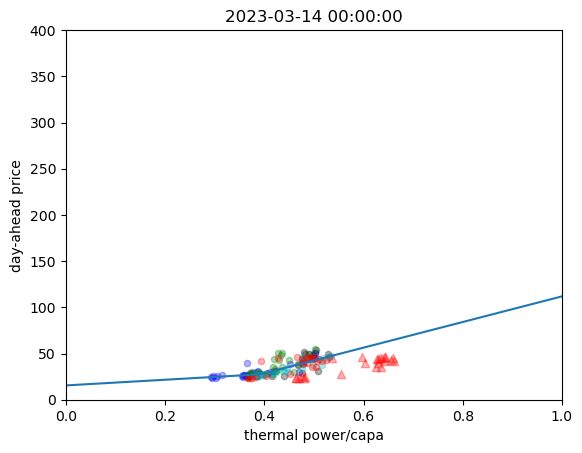

169.84408381265413
121.09371970944159
93.85610640229277
185.93041906327034
19.45635561088228 119.73017945907941 119.73017945907958


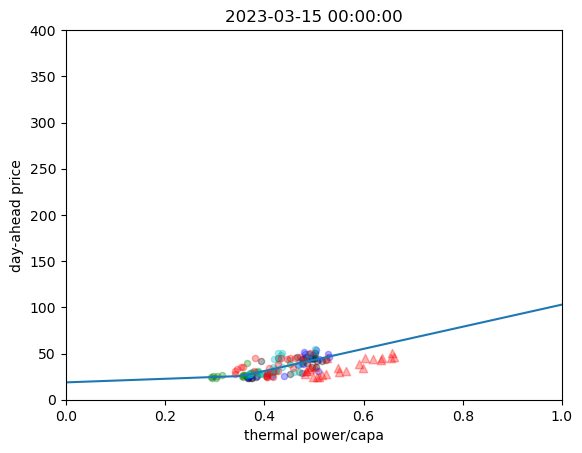

161.030501232539
169.84408381265413
121.09371970944159
93.85610640229277
68.04260566936227 126.04907681899388 126.04907681899394


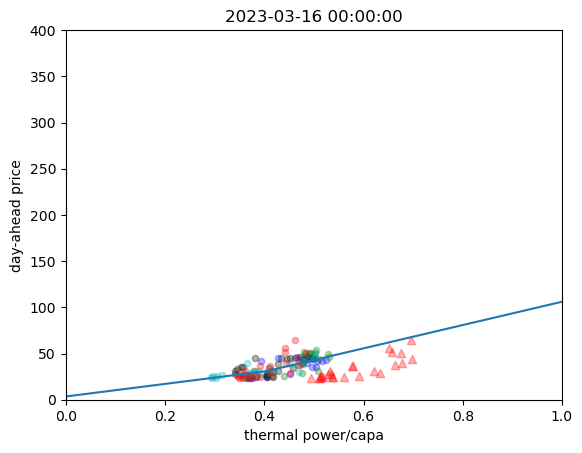

207.16770747740344
161.030501232539
169.84408381265413
121.09371970944159
113.76731579342983 113.76731579342974 113.76731579342976


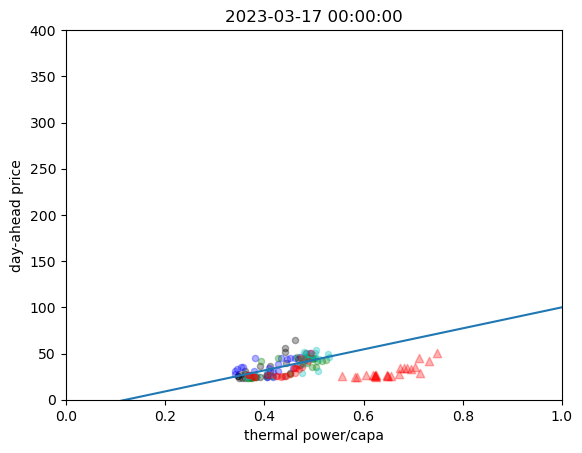

112.78631881676256
207.16770747740344
161.030501232539
169.84408381265413
45.576805736897015 113.06132012317521 113.06132012317522


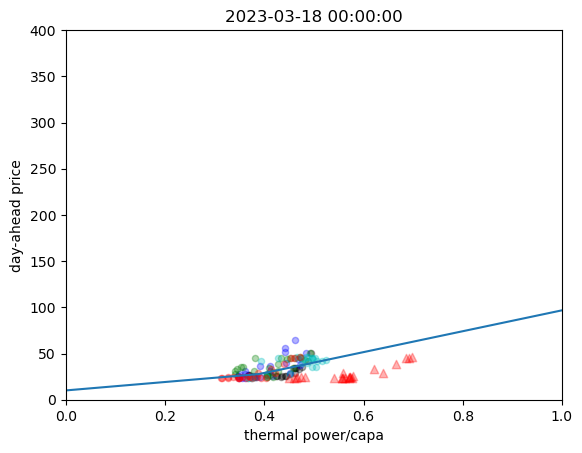

105.2262448644207
112.78631881676256
207.16770747740344
161.030501232539
49.8914150585605 88.05289433184957 88.05289433184954


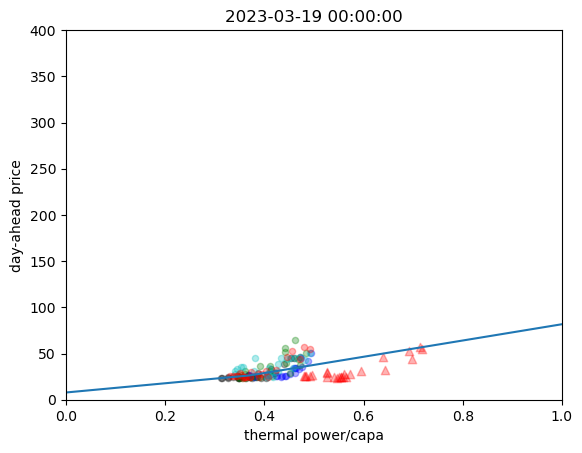

161.42415776499593
105.2262448644207
112.78631881676256
207.16770747740344
22.549278507402164 94.00547811048837 94.0054781104884


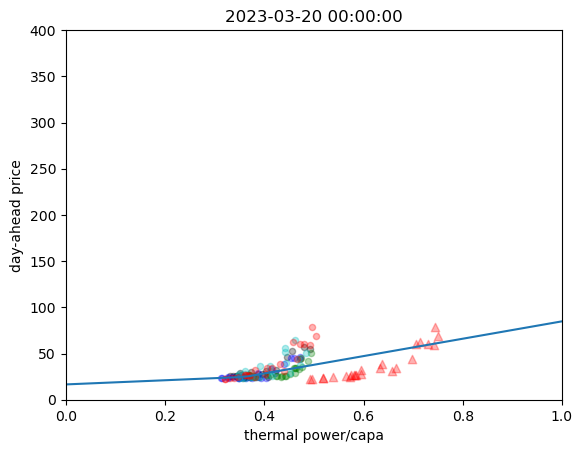

192.08178135073916
161.42415776499593
105.2262448644207
112.78631881676256
32.718636875183535 94.82837655704392 94.82837655704388


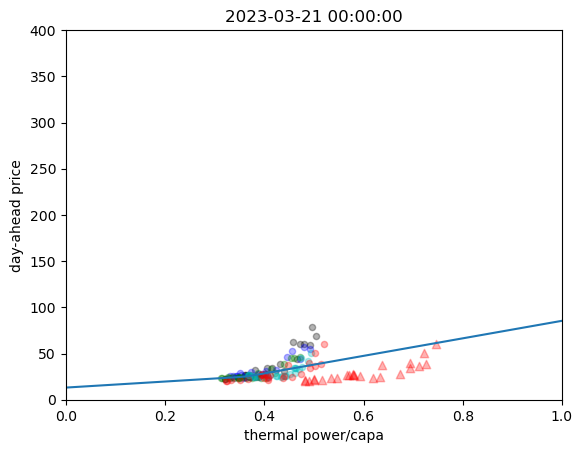

163.65073952341822
192.0817813507384
161.42415776499593
105.2262448644207
22.342599429629683 114.38590005902726 114.38590005902728


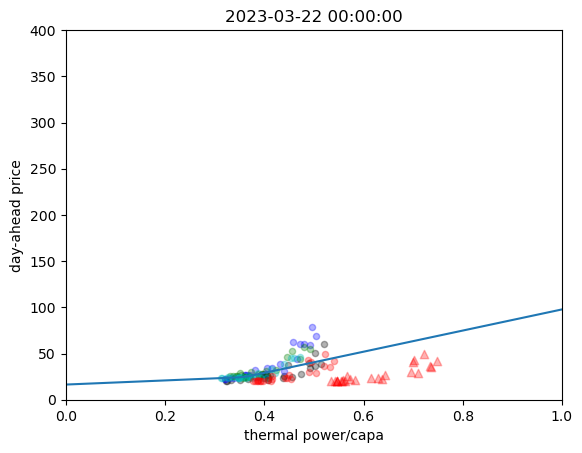

117.40818262526707
163.65073952341822
192.081781350739
161.42415776499593
56.719485975577406 88.26908306753957 88.26908306753965


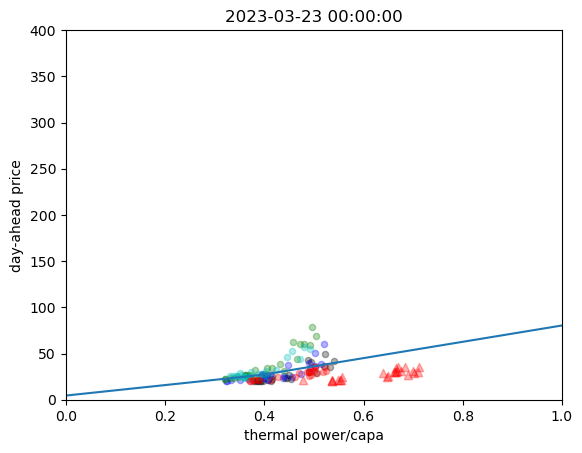

52.21053802847737
117.40818262526702
163.65073952341822
192.0817813507387
0.0 83.25223243073088 83.25223243073084


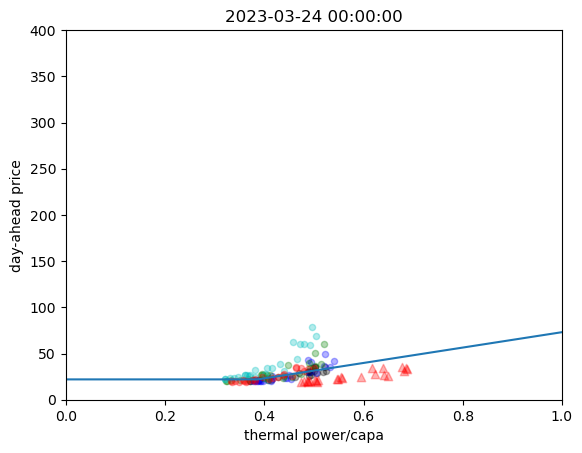

63.60183375160835
52.21053802847737
117.40818262526685
163.65073952341822
16.235238016630063 90.21417695504675 90.21417695504668


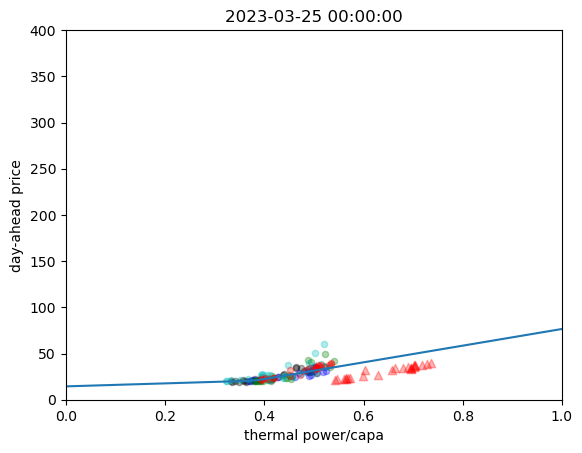

90.68469803062229
63.60183375160829
52.210538028477245
117.40818262526705
26.55391266169949 101.94650328113997 101.94650328114004


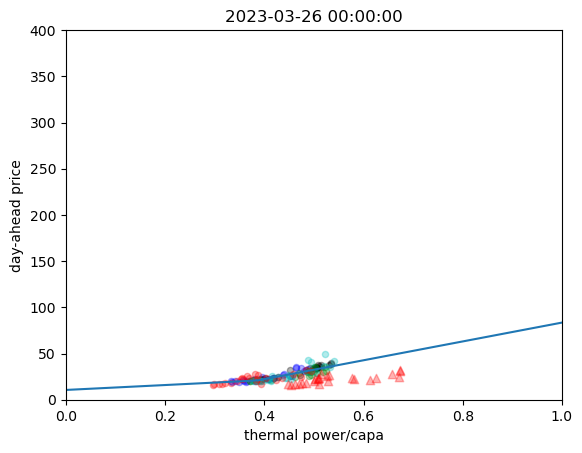

87.33759244042727
90.68469803062227
63.60183375160836
52.2105380284774
78.63569498633275 78.63569498633257 78.63569498633241


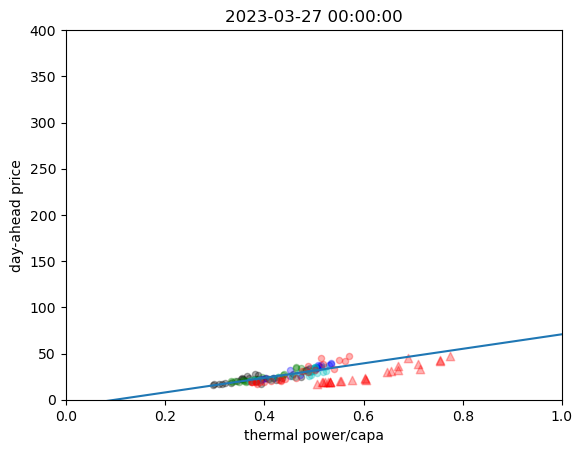

76.18722852333377
87.33759244042727
90.68469803062229
63.6018337516084
56.388843807175725 117.27076505836172 117.27076505836156


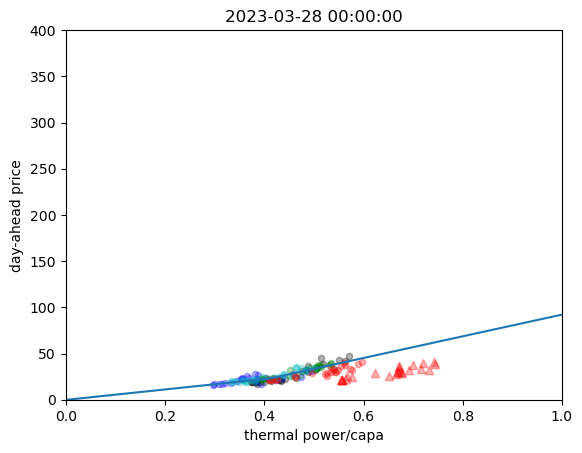

53.44533424290198
76.18722768207172
87.33759244042727
90.68469803062224
58.323125051479884 91.1243189028434 91.12431890284333


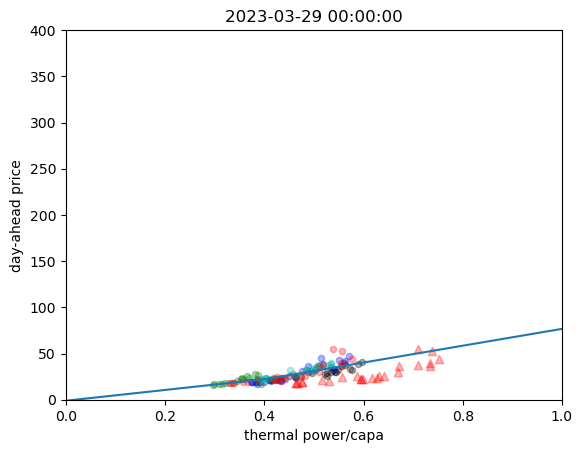

98.69439333791429
53.44533424290198
76.18722687329834
87.33759244042727
66.21814442261628 66.2181444226161 66.21814442261618


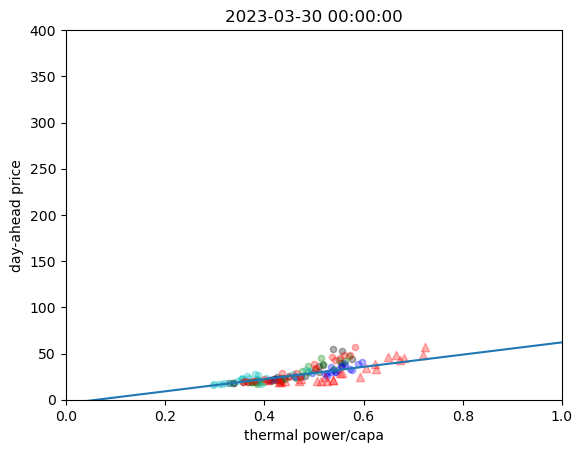

86.08405476313939
98.69439333791514
53.44533424290198
76.18760941763475
30.168015582633785 104.58850387509798 104.58850387509789


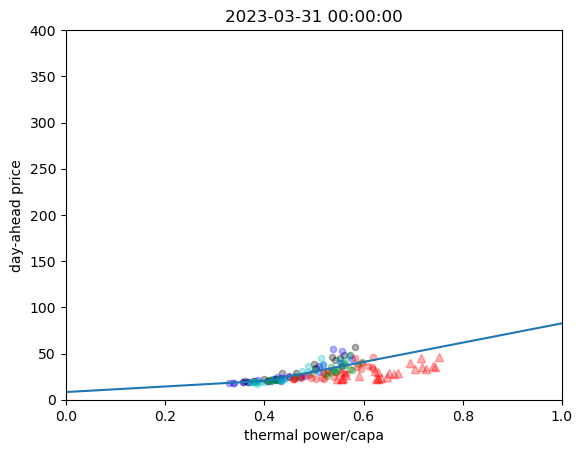

96.76883102174466
86.08397285958512
98.69439333791368
53.44533424290198
47.24054277881401 78.37841255661151 78.37841255661154


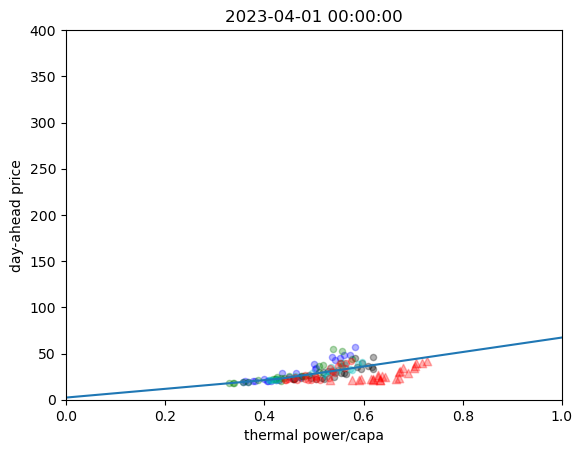

128.07563681183237
96.76883102174466
85.91860346577252
98.69439333791264
47.755692943710244 84.12680245971644 84.1268024597165


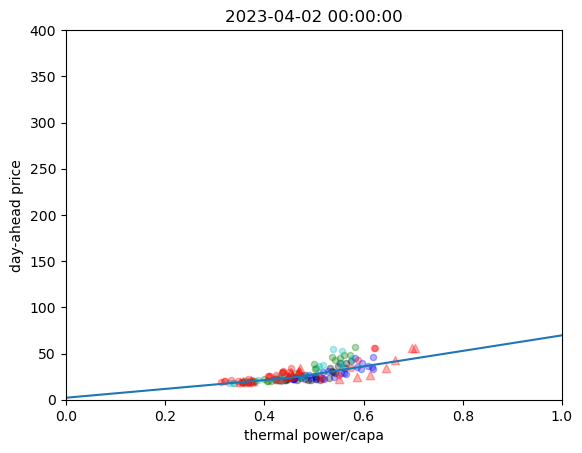

105.3336012816492
128.07563681183237
96.76883102174466
85.91063400509019
33.29622218693656 81.98332832134888 81.98332832134888


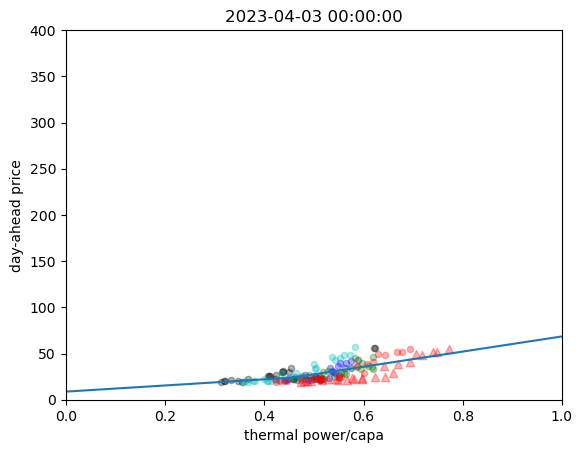

139.6963104134287
105.3336012816492
128.07563681183237
96.76883102174483
6.87974544348263 87.75863906514675 87.7586390651468


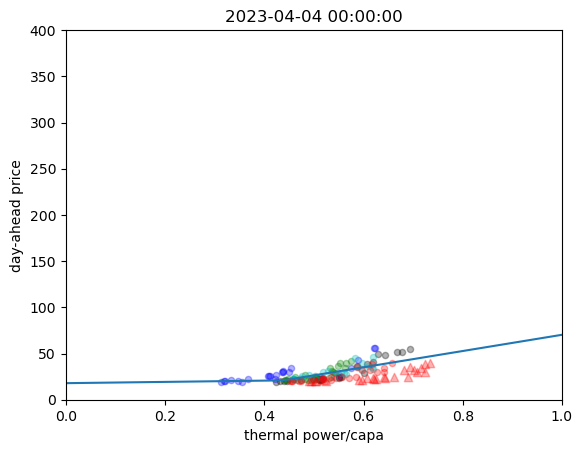

65.27710043092256
139.69630751380603
105.3336012816492
128.07563681183237
13.545217605135514 110.27961599848743 110.27961599848756


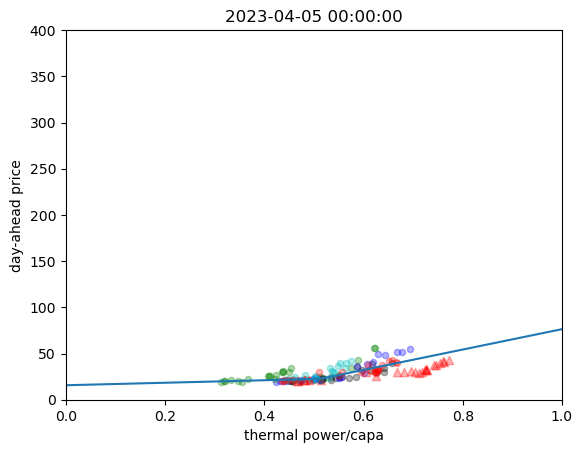

60.8892101318979
65.27710043092256
139.6963127810134
105.3336012816492
14.484654374612754 95.37425591274544 95.37425591274561


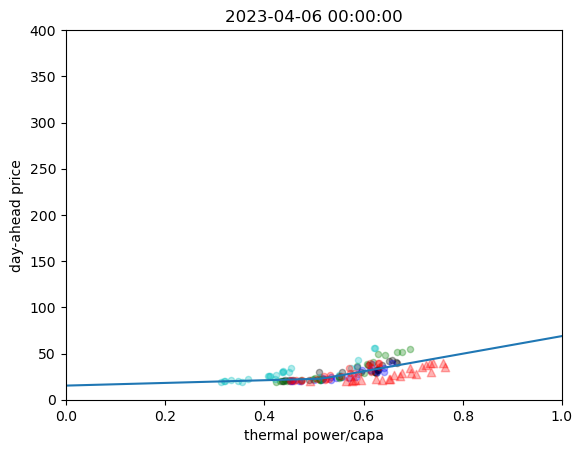

73.72661329572574
60.889210131897954
65.27710043092256
139.69630751537707
53.33354957399896 106.61988068360226 106.6198806836022


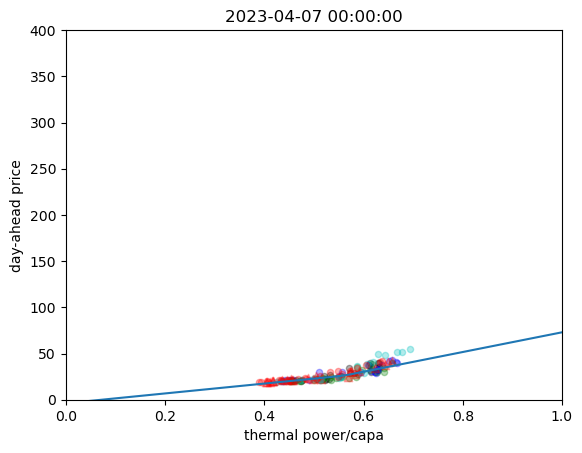

56.2452039872111
73.72661329572571
60.889210131897784
65.27710043092256
43.45340662014033 93.9573011109203 93.95730111092013


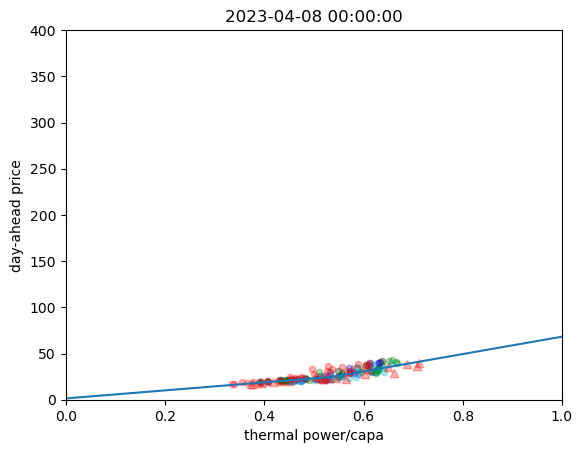

68.88366518990281
56.22983886328069
73.72661329572571
60.889210131897954
37.14065862063511 83.08977531485426 83.08977531485446


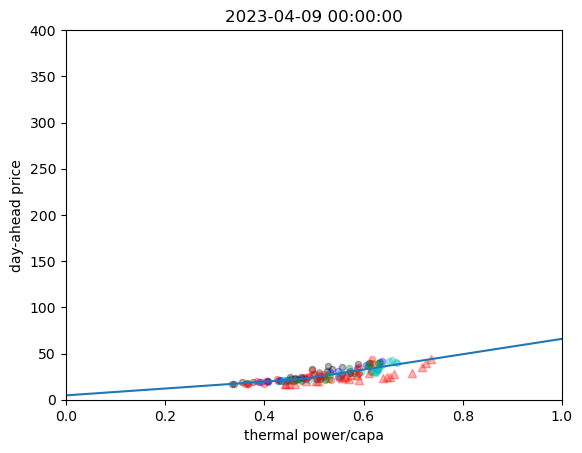

72.7407959437664
68.8836651899029
56.22983886328054
73.7266132957257
39.96652777093471 87.8565764248003 87.8565764248004


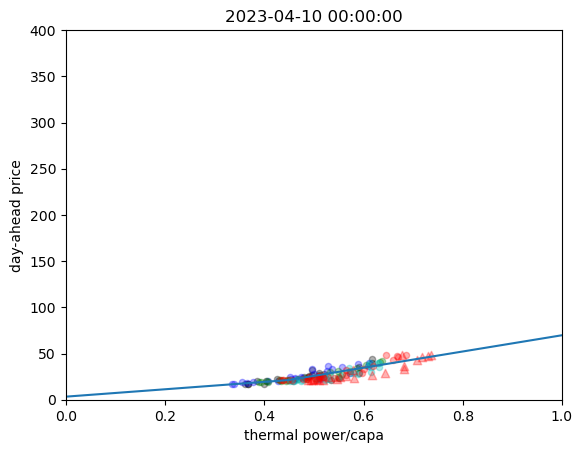

70.64841532958974
72.7407959437664
68.88366518990296
56.229838863280776
51.36205844534877 109.37838618150771 109.37838618150782


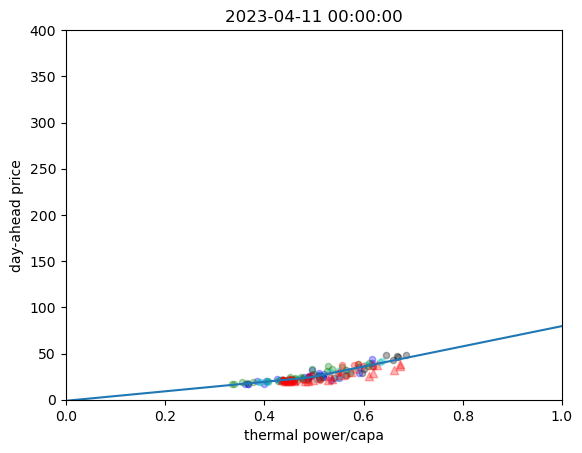

98.70760290097505
70.65090918476437
72.74079594376637
68.88366518990262
46.78810146469415 104.68867180925943 104.68867180925945


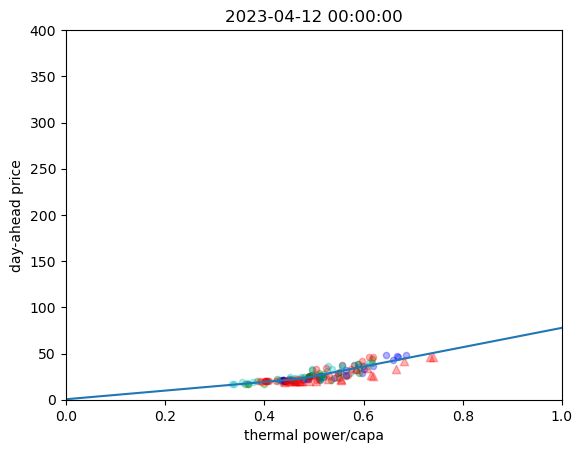

98.14184144048039
98.70760290097505
70.65125656829804
72.7407959437664
27.51433309714857 111.99222315068046 111.9922231506806


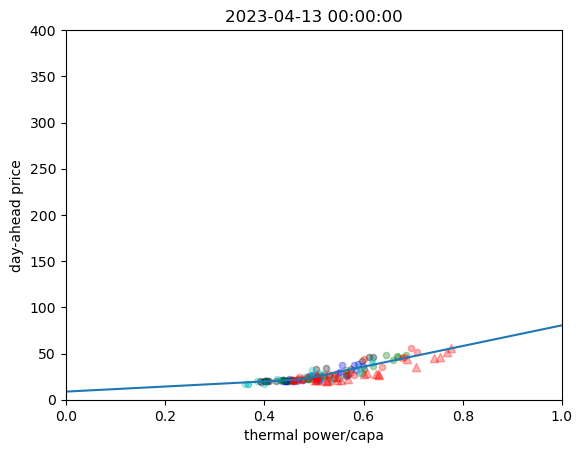

70.71059724031697
98.11160258236607
98.70760290097505
70.71335961574448
30.457448484136474 126.8115422709489 126.81154227094953


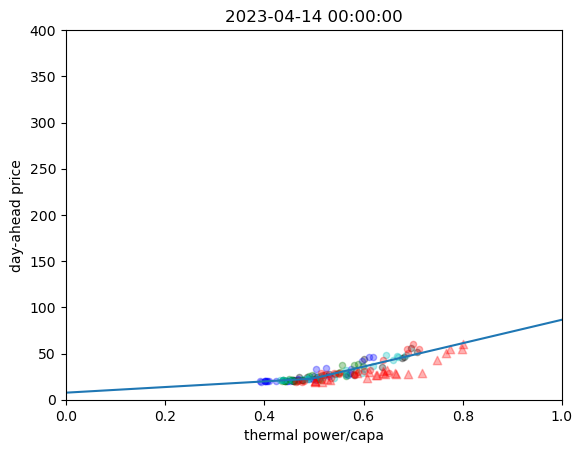

130.4377464190915
70.76141330267285
98.11160258236615
98.70760290097505
61.48509939172455 131.12607944004816 131.12607944004722


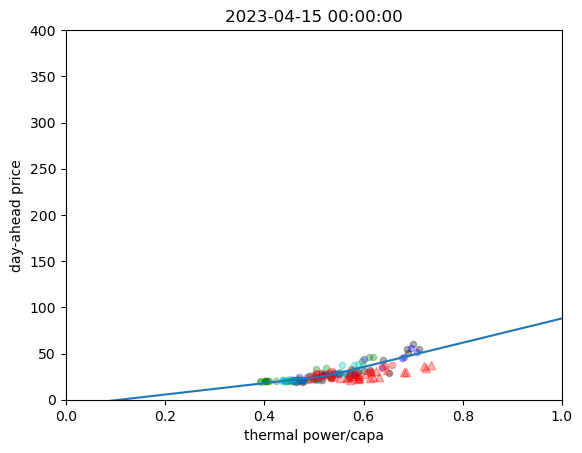

84.68413311421529
130.43774641909175
70.82332973945647
98.14184144048029
15.60951632772875 89.5401330890423 89.54013308904207


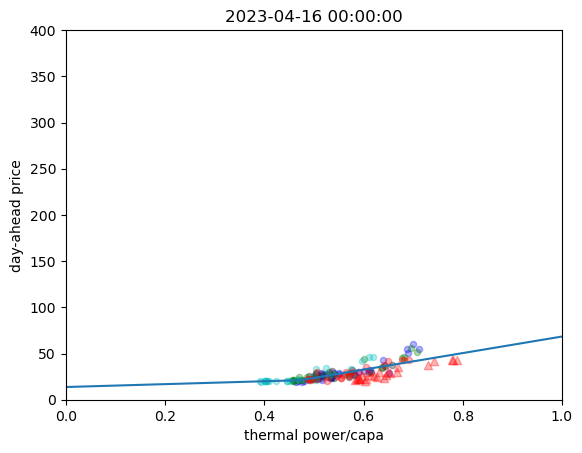

85.70740635120103
84.68413311421529
130.4377464190906
70.70260773118663
67.11208079590904 113.93499781397259 113.93499781397249


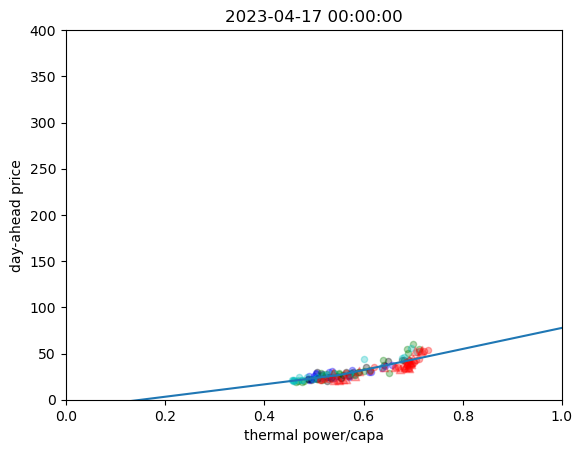

77.42901488582659
85.70740635120106
84.68413311421529
130.43774641909135
76.3234830696976 93.74403579677649 93.7440357967766


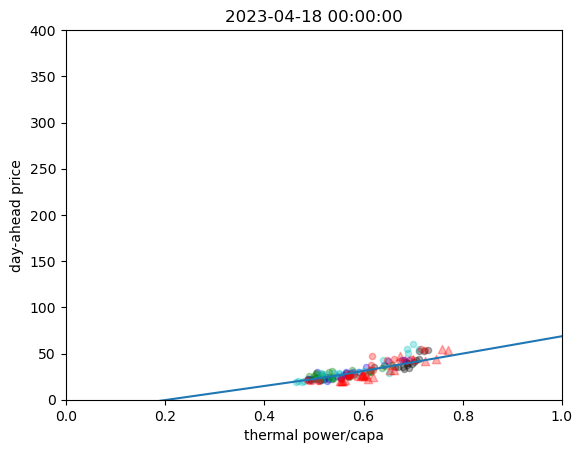

84.90682262268194
77.42901488582653
85.7074063512009
84.68413311421529
66.0463227110499 117.61650562899226 117.61650562899234


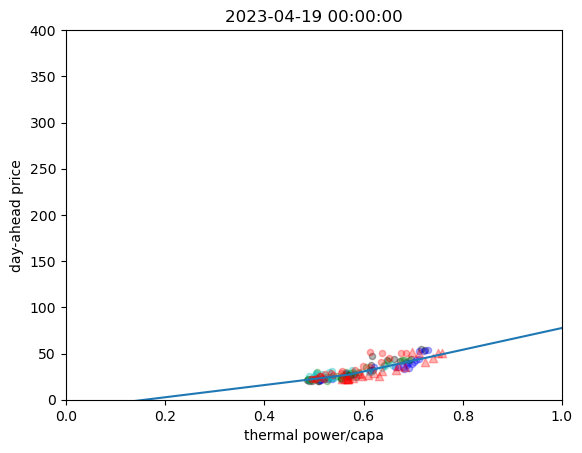

95.37866046862332
84.90684445871557
77.42901488582658
85.70740635120106
77.74496236938448 108.21500853576698 108.21500853576687


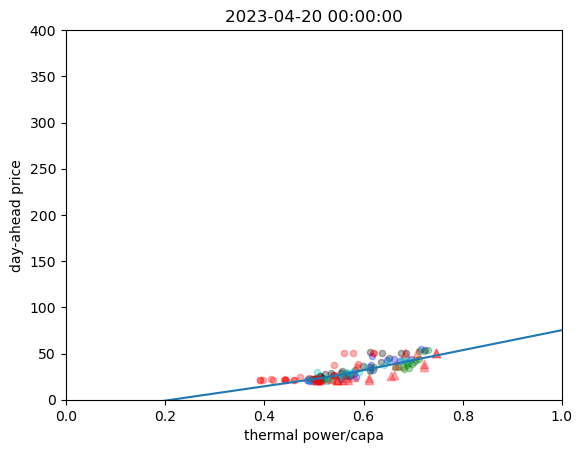

138.36435244436294
95.3786604686232
84.90702647635041
77.42901488582653
1.3589447098740601 101.26246158304762 101.2624615830476


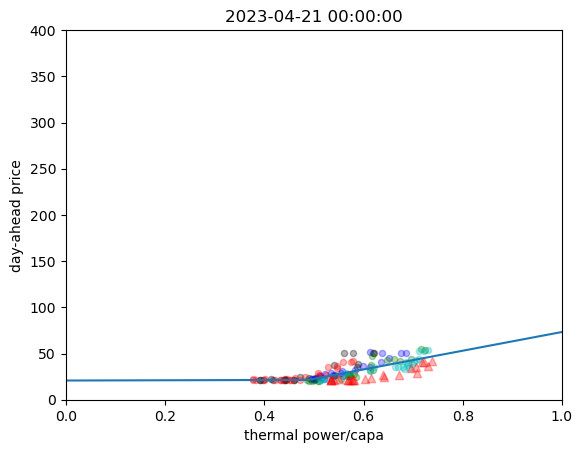

96.72113199667206
138.36438728109286
95.37866046862332
84.90702195503073
18.701487435177253 136.5316260313556 136.531626031356


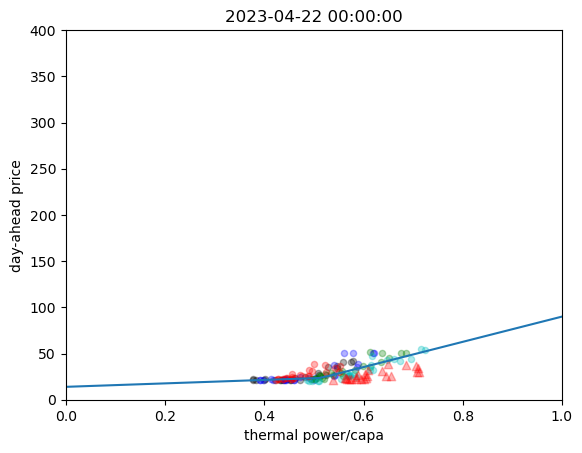

96.89558751027114
96.72113199667206
138.36441123671972
95.37866046862332
27.60876727515526 112.56929282655581 112.56929282655581


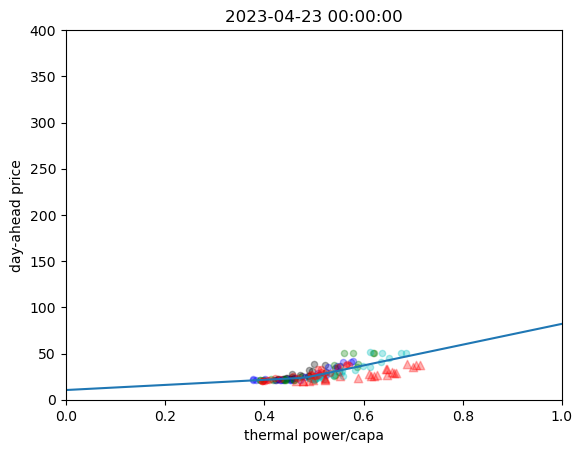

61.12751597687317
96.89558751027114
96.72113199667206
138.36536203473722
15.64421687097091 118.70286913888906 118.70286913888923


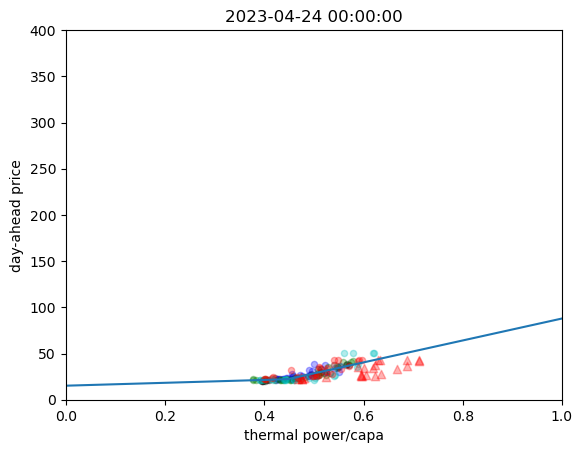

130.72566873749477
61.127515976873156
96.89558751027114
96.72113199667203
4.218575569748406 115.10847810209393 115.10847810209388


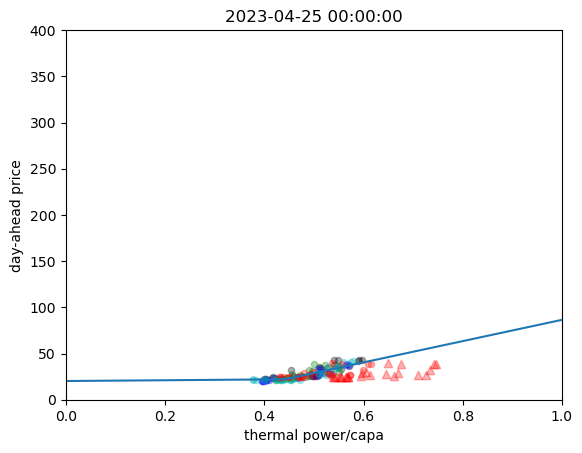

74.2620302410356
130.72566873749477
61.127515976873134
96.89558751027114
72.71890468761734 72.71890468761737 72.71890468761733


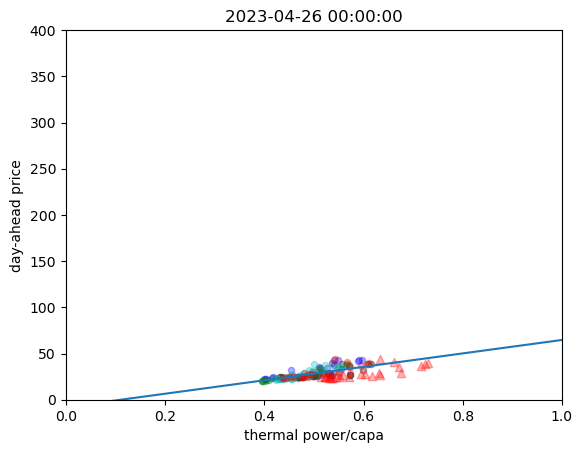

78.02609052970006
74.2620302410356
130.72566873749471
61.12751597687314
43.62435897470037 98.10274646637417 98.1027464663743


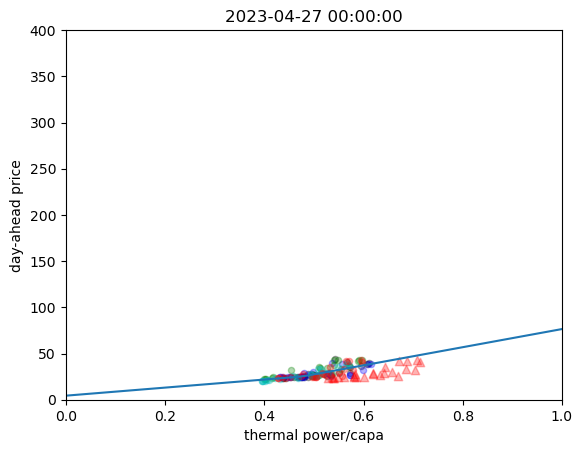

115.94403451109287
78.02609052970095
74.2620302410356
130.72566873749477
27.902605563953113 97.60497815502333 97.60497815502353


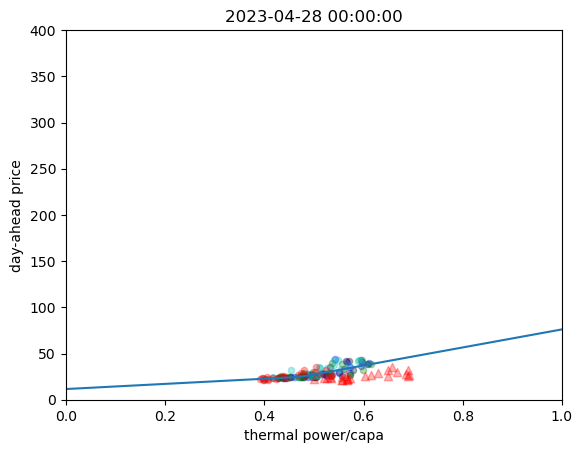

68.90122432210353
115.94403451109287
78.02609052970098
74.2620302410356
39.300752165673444 55.8533419501078 55.853341950107755


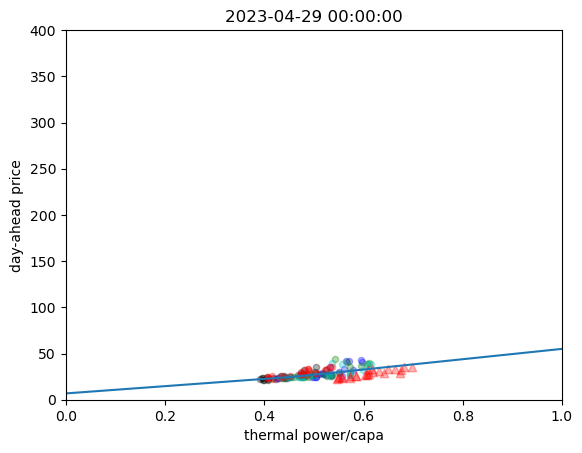

81.6410188989318
68.90122432210353
115.94403451109287
78.02609052970104
49.978333411308085 49.978333411308064 49.9783334113081


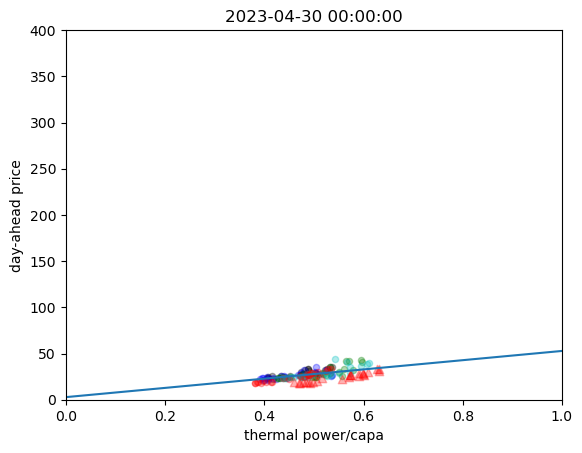

45.331481700011516
81.6410188989318
68.90122432210353
115.94403451109287
64.24755045128913 64.24755045128911 64.2475504512892


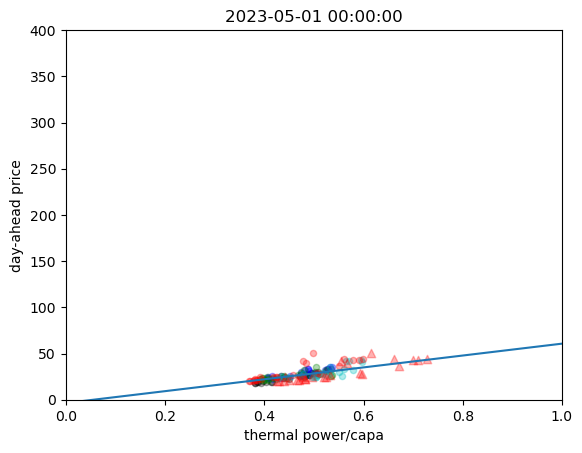

93.67154586315402
45.331481700011516
81.6410188989318
68.90122432210353
69.66868788474231 69.66868788474228 69.66868788474238


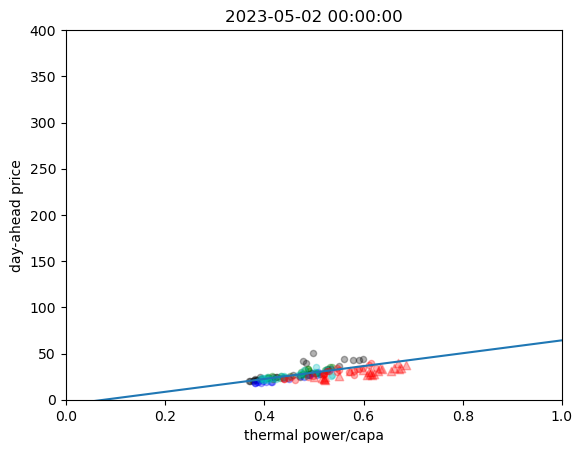

49.418585769354074
93.67154586315392
45.331481700011516
81.6410188989318
62.755049053420194 62.75504905342017 62.75504905342012


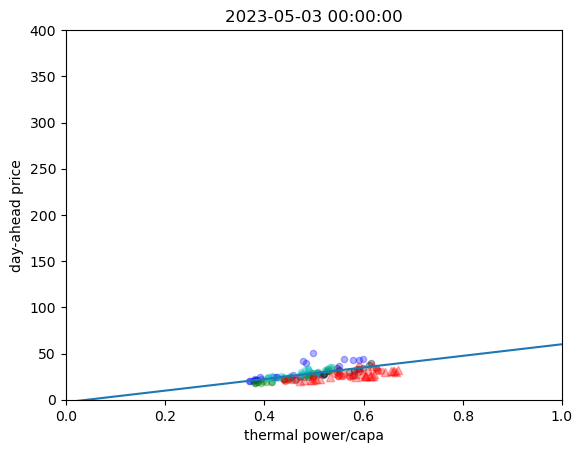

63.09582915512307
49.41858576935411
93.67154586315327
45.331481700011516
47.74071916184547 47.740719161845426 47.74071916184542


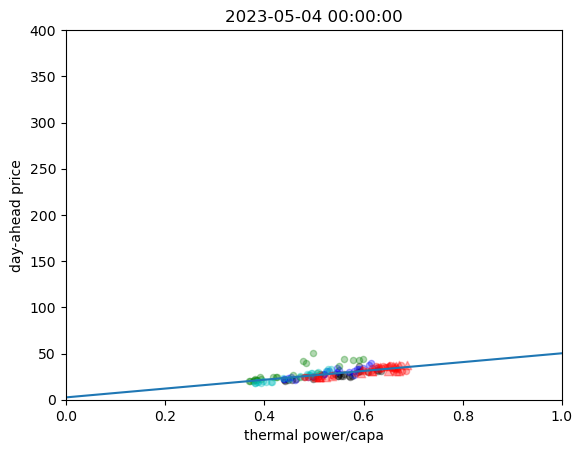

49.31442463356302
63.095829155123155
49.418585769354095
93.6715458631533
33.53206108414185 51.85597757001362 51.85597757001371


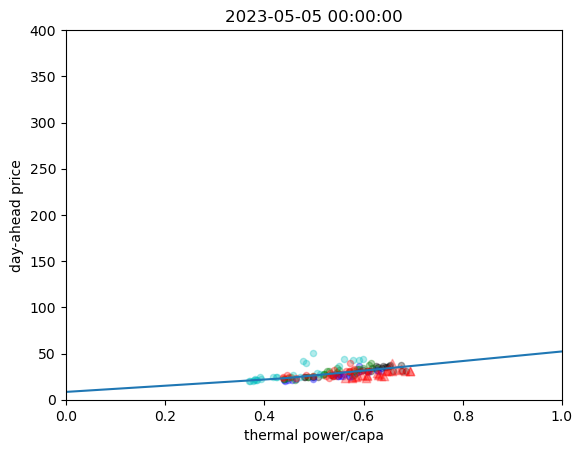

74.78848230707976
49.31442463356301
63.095829155123226
49.41858576935407
56.883496312998325 56.88349631299835 56.88349631299838


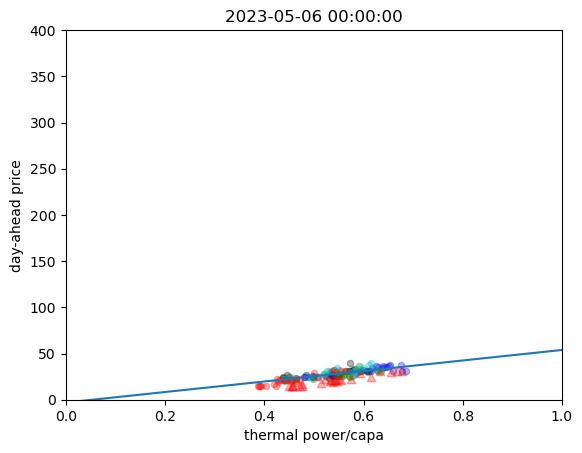

105.34583401807724
74.78848230707976
49.31442463356302
63.095829155123106
61.17911645860944 61.17911645860944 61.17911645860937


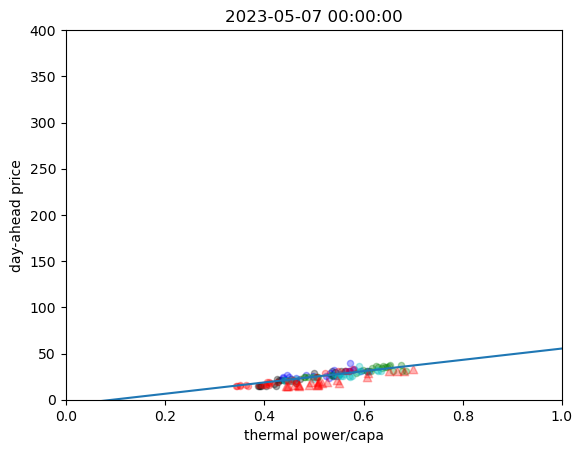

40.514010791168154
105.34583401807724
74.78848230707976
49.314424633562965
12.46082474030288 72.5000685760495 72.50006857604951


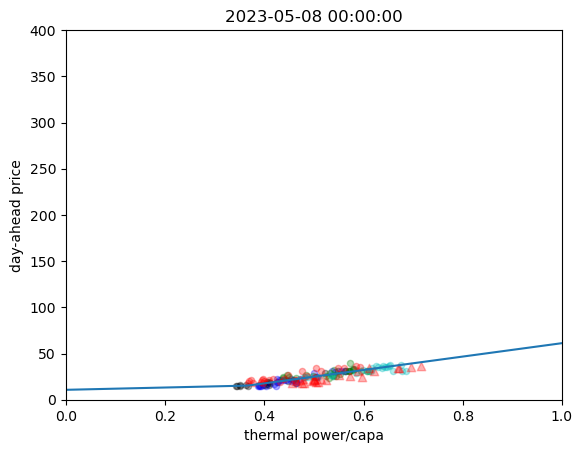

78.51488708451788
40.51401079116823
105.34583401807724
74.78848230707976
55.23488065782597 77.0930805966226 77.09308059662256


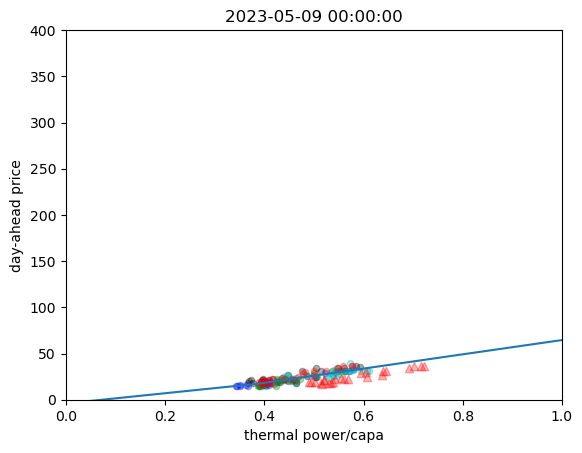

56.613311132756806
78.51488708451771
40.51401079116822
105.34583401807724
59.10685737692197 82.91203139047082 82.91203139047077


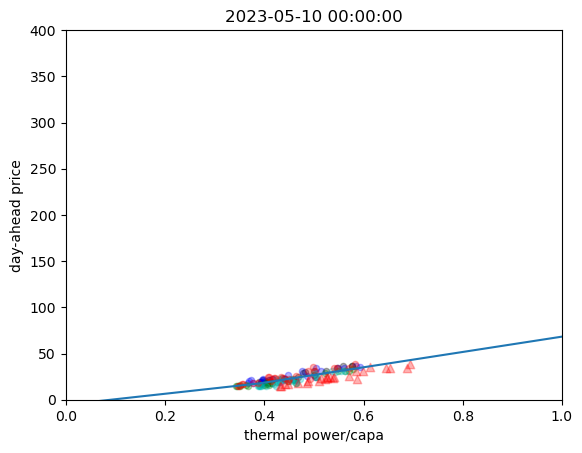

52.45096908582675
56.61331113275675
78.51488708451788
40.4605180676687
85.21339425904655 85.2133942590466 85.2133942590465


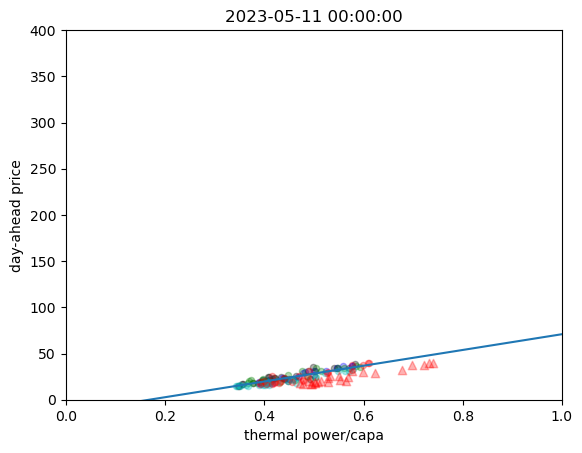

62.673282009726975
52.450969085826884
56.61331113275682
78.51488708451791
76.93832008106358 88.53604470638923 88.53604470638933


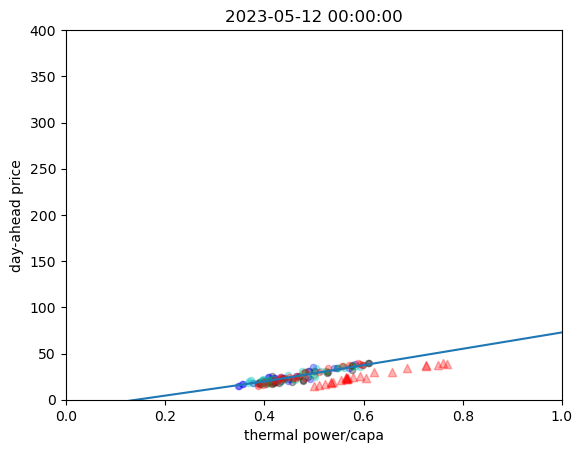

43.50420324739838
62.673282009726975
52.450969085826976
56.61331113275685
77.11733275943845 94.51604458679536 94.51604458679532


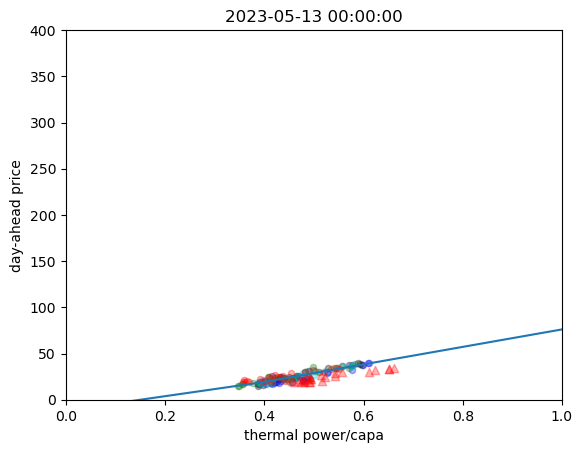

62.711381869563425
43.50420324739841
62.673282009726975
52.450969085826976
63.648080173794895 92.75432839707427 92.75432839707426


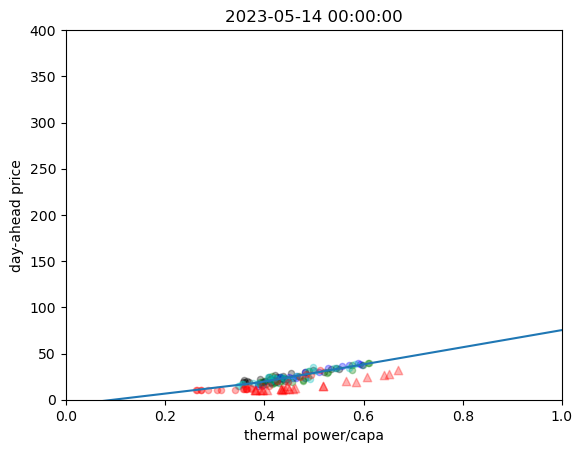

79.13232273019666
62.71138186956357
43.50420324739841
62.673282009726975
15.837840942219918 99.29975753222483 99.29975753222485


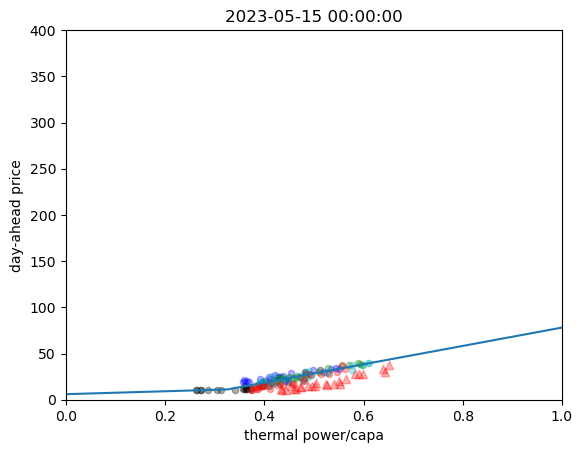

91.37433874596798
79.13232273019666
62.711381869563425
43.50420324739841
53.25693773712441 110.97639152554859 110.97639152554866


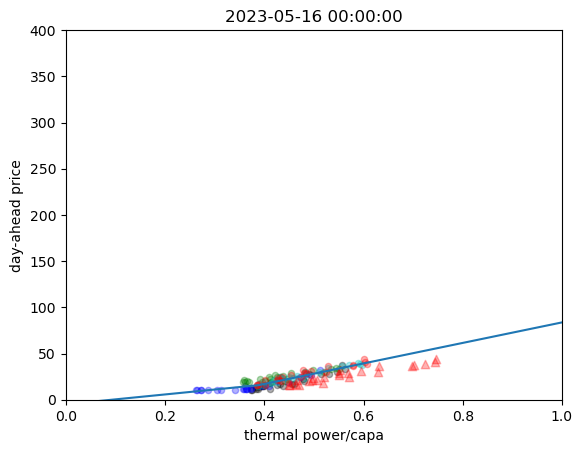

60.59784420003404
91.37433874596798
79.13232273019665
62.71138186956358
5.867880948544404 108.34505175870704 108.34505175870707


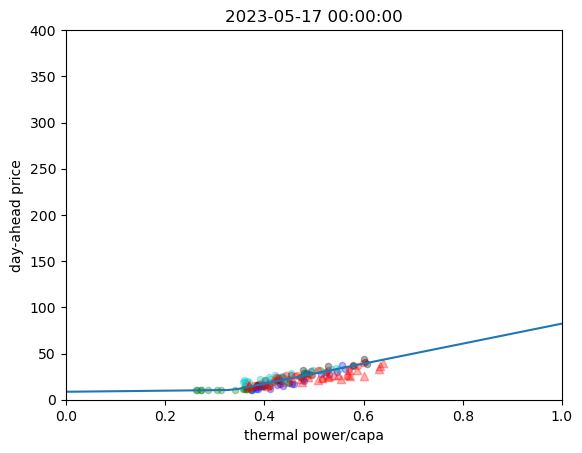

107.81359533537947
60.59784420003403
91.37433874596798
79.13232273019584
51.82735698082277 105.01301193631708 105.01301193631708


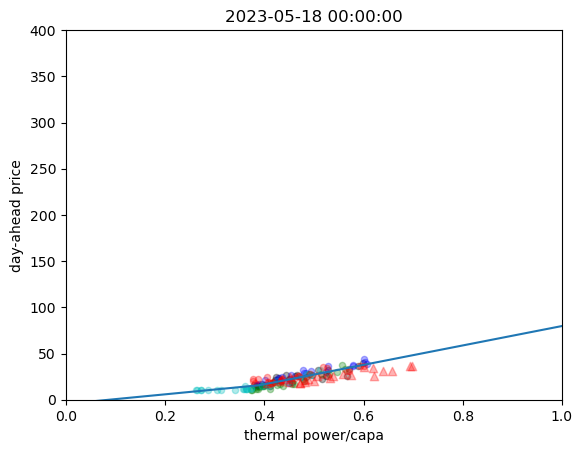

77.66829414614458
107.81359533537947
60.59784420003403
91.37433874596796
99.0515200296772 99.05152002967714 99.05152002967716


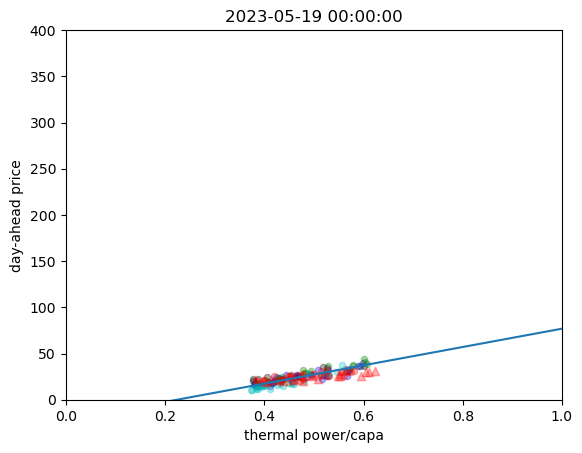

76.11338537387019
77.66829414614458
107.81359533537947
60.59784420003402
81.82972107901863 81.8297210790187 81.82972107901854


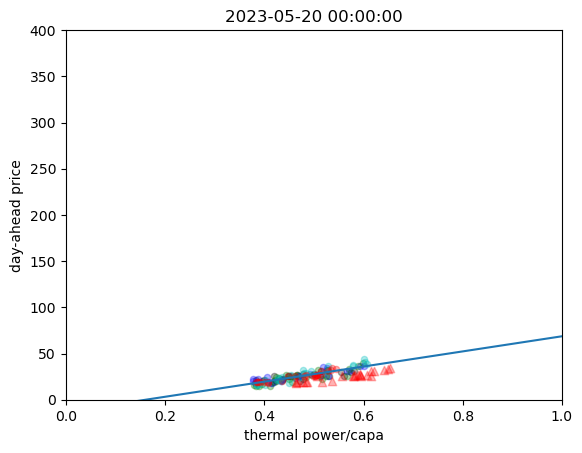

61.92349706106123
76.11338537387019
77.66829414614458
107.81359533537947
65.66549601157293 65.66549601157294 65.66549601157293


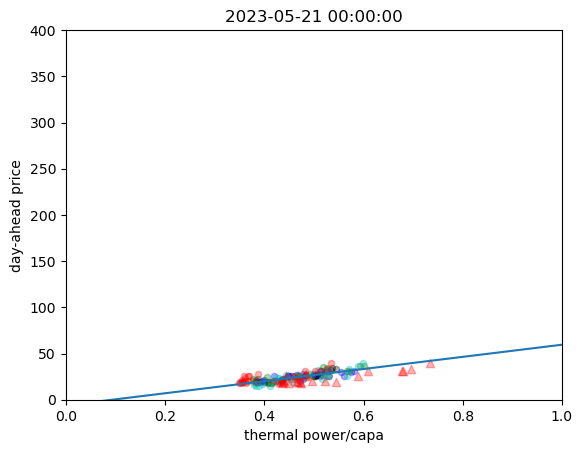

109.69598192276088
61.92349706106123
76.11338537387019
77.66829414614458
37.5491016426994 57.992937483306 57.99293748330607


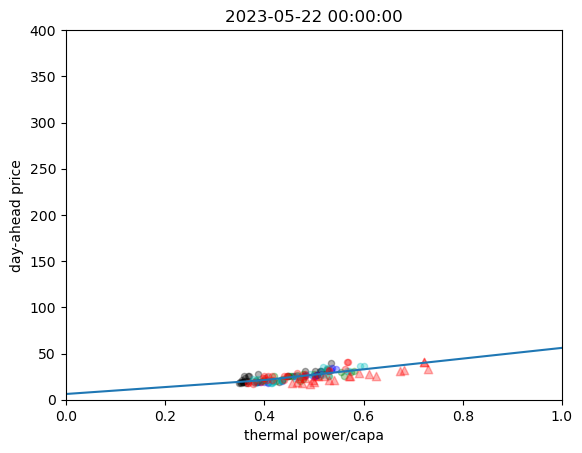

66.62917498049966
109.69598192276088
61.923497061061056
76.11338537387019
54.775440371451595 54.77544037145165 54.7754403714516


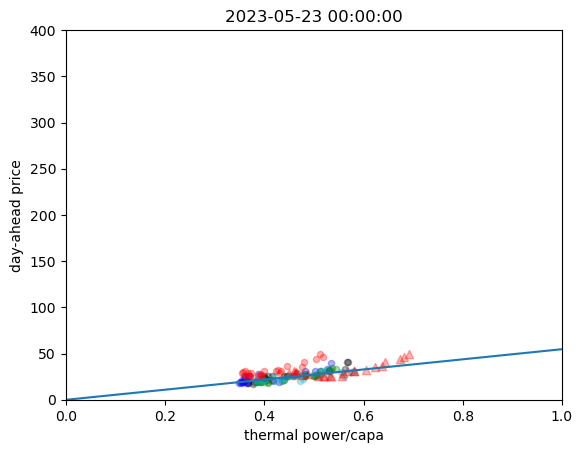

110.8615612161052
66.62917498049966
109.69598192276088
61.92349706106123
61.26230655136369 61.262306551363686 61.262306551363764


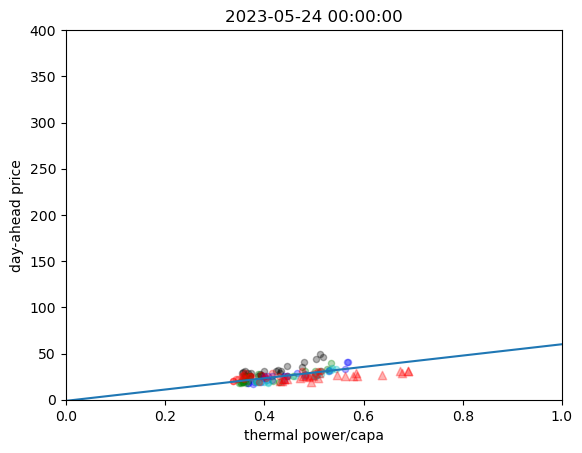

64.36612161051767
110.8615612161052
66.62917498049966
109.69598192276088
48.95992402450575 48.959924024505746 48.95992402450577


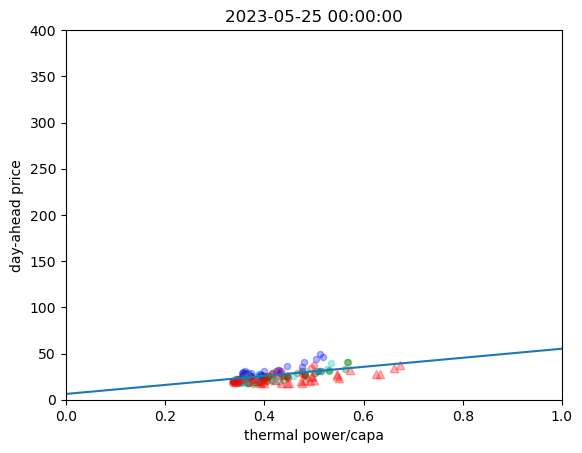

99.13260476581758
64.36612161051767
110.8615612161052
66.62917498049966
48.102473533804414 48.10247353380437 48.10247353380436


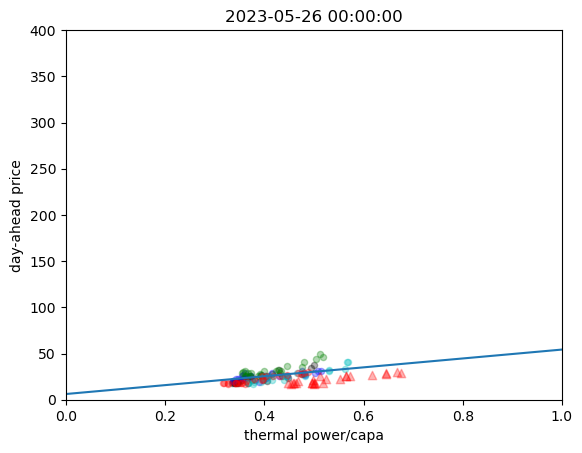

42.8818340353989
99.13260476581758
64.36612161051767
110.8615612161052
58.63823686532585 58.638236865325844 58.63823686532592


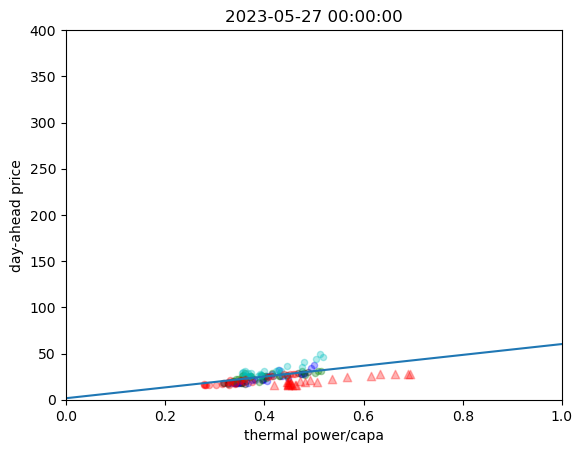

66.42813609083758
42.881834035398896
99.13260476581758
64.36612161051767
68.29525649594262 68.29525649594261 68.29525649594261


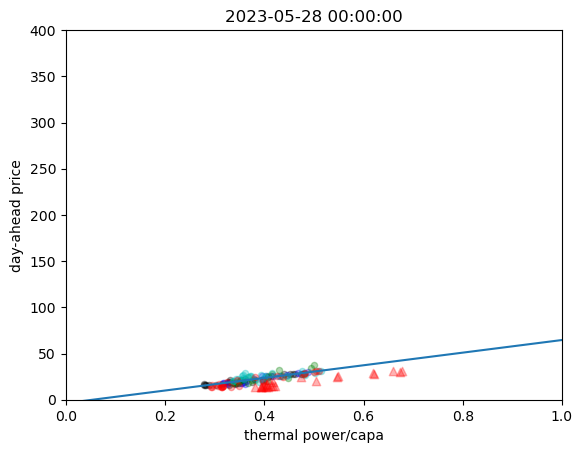

36.67641553548449
66.42813609083755
42.88183403539886
99.13260476581758
8.918952091743861 72.76116090944348 72.76116090944343


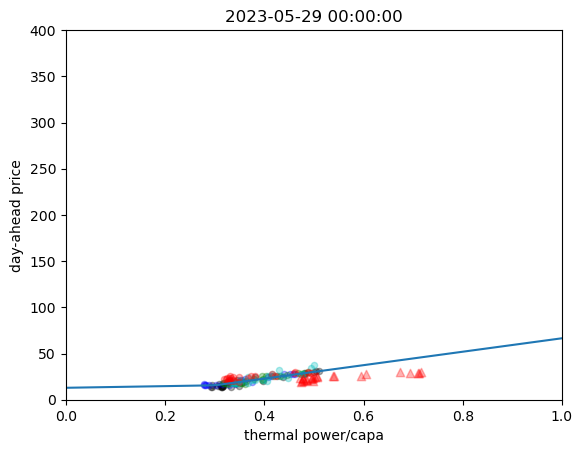

53.852086569672906
36.676415538028536
66.42813609083755
42.88183403539878
67.98193152759056 67.9819315275906 67.98193152759063


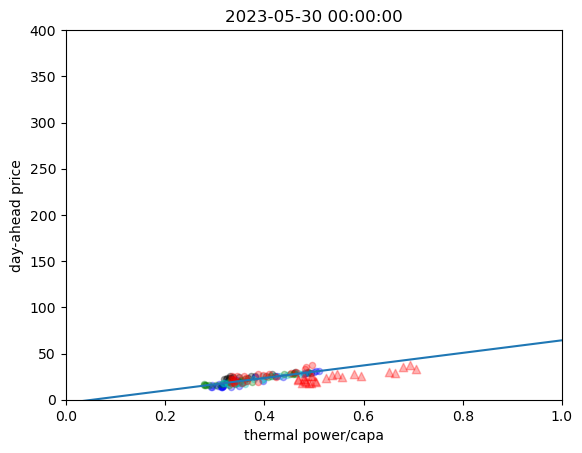

104.15463434675432
53.852086569672906
36.67641559992224
66.42813609083755
65.70833172649377 65.70833172649382 65.70833172649381


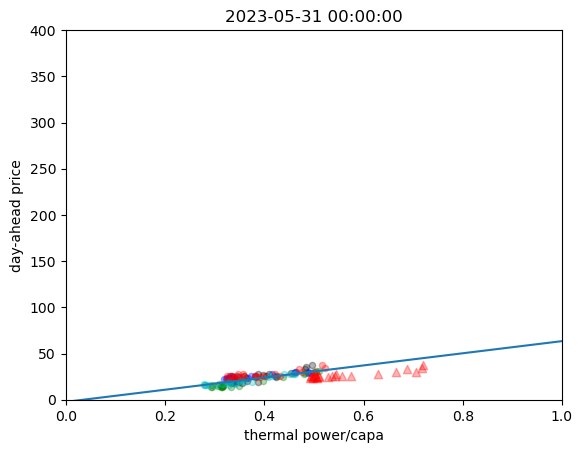

58.336516023007405
104.15463434675432
53.852086569672906
36.67641552149031
50.79747908307336 50.79747908307352 50.79747908307348


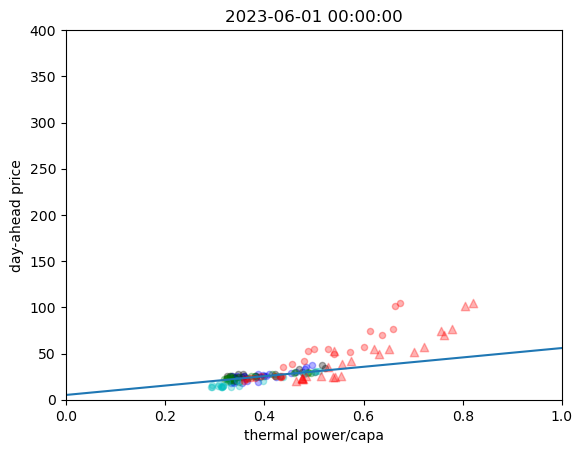

145.23188337502384
58.336516023007405
104.15463434675432
53.852086569672906
37.55977991313239 191.88051083230505 191.88051083230516


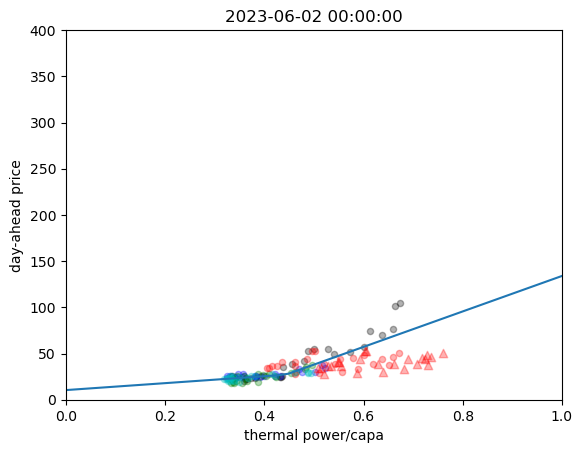

136.71396877567784
145.2318833750239
58.336516023007405
104.15463434675432
11.7033767116654 94.79770551728119 94.79770551728114


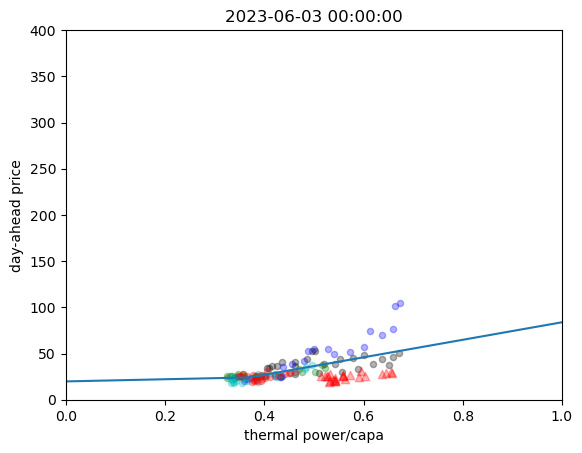

63.145842235004096
136.71396877567784
145.23188337502395
58.336516023007405
0.0 101.9488700307127 101.94887003071264


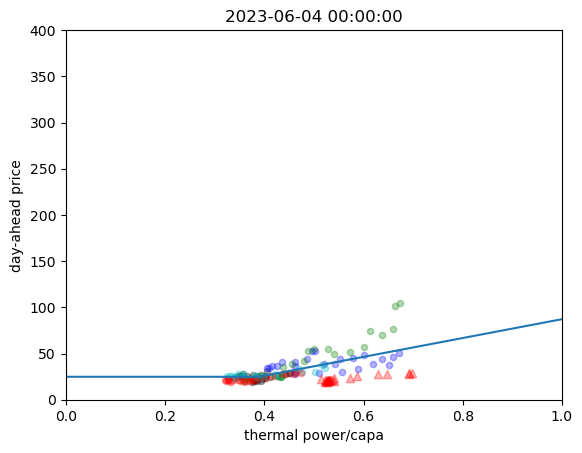

58.8761133935908
63.145842235004096
136.71396877567784
145.23188337502395
13.714568200862901 102.87317830086222 102.87317830086229


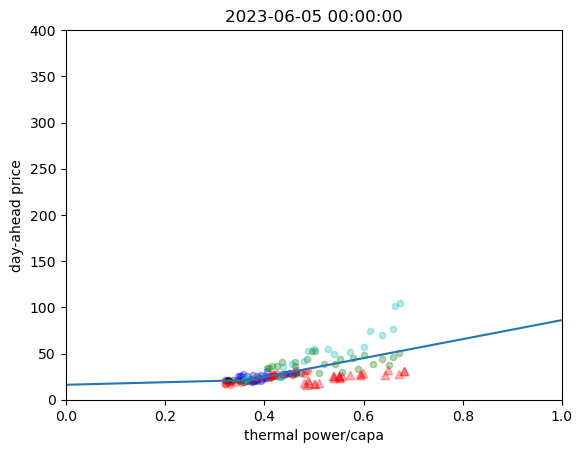

85.84183237469185
58.8761133935908
63.145842235004096
136.71396877567784
80.42049838995192 80.42049838995192 80.42049838995176


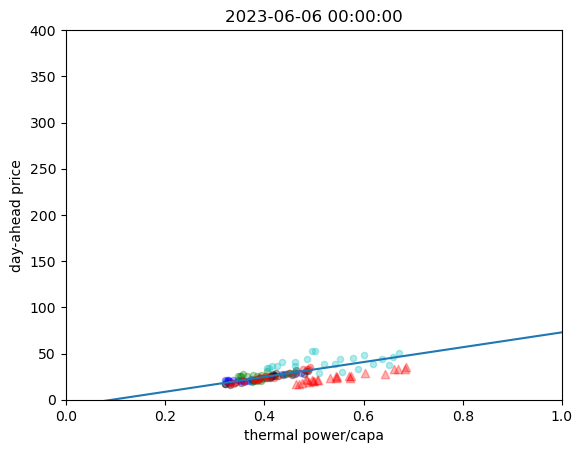

96.9867214461791
85.84183237469185
58.8761133935908
63.145842235004096
74.35250291618411 74.35250291618406 74.35250291618411


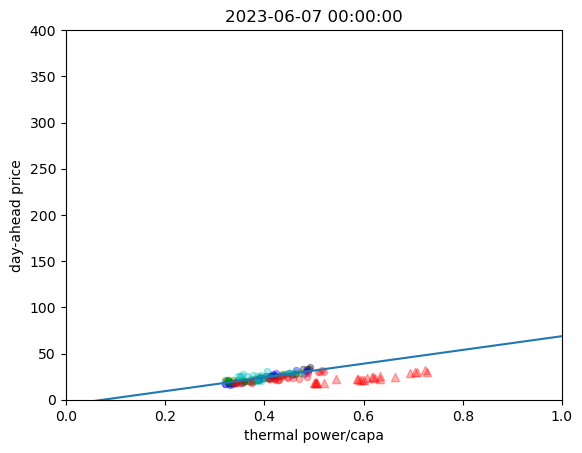

60.45331226963668
96.9867214461791
85.84183237469186
58.8761133935908
60.51122758586709 60.51122758586703 60.51122758586709


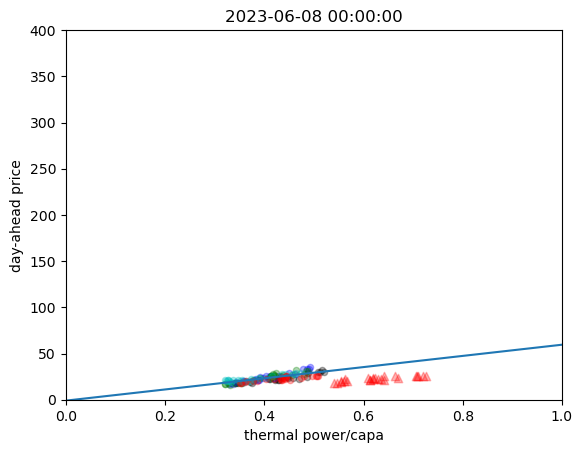

50.0680759702725
60.453312269636676
96.9867214461791
85.84183237469186
60.6272257300669 60.62722573006697 60.6272257300669


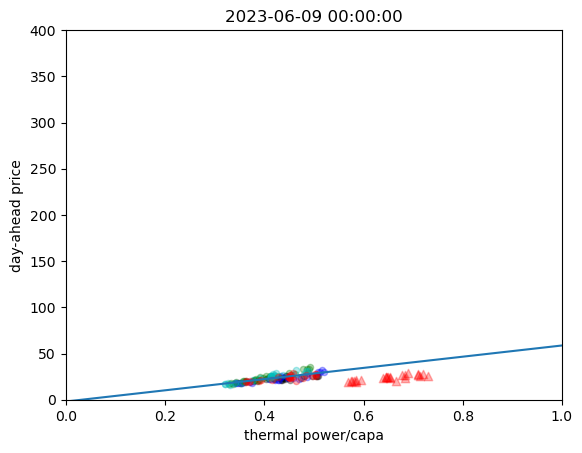

57.596944673823266
50.0680759702725
60.45331226963669
96.9867214461791
52.960567422249 52.96056742224895 52.960567422249


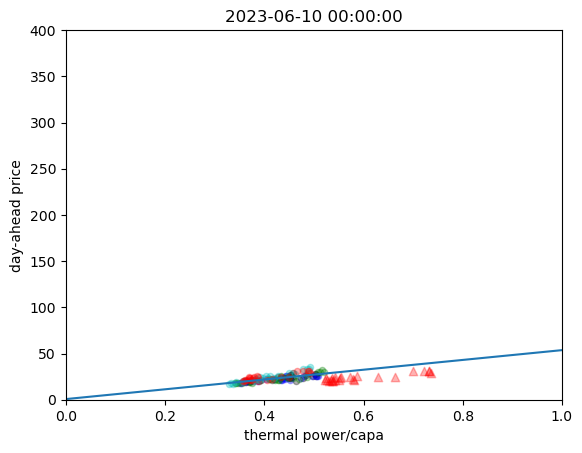

68.564004954583
57.596944673823266
50.0680759702725
60.45331226963669
41.92153458725834 41.92153458725832 41.92153458725827


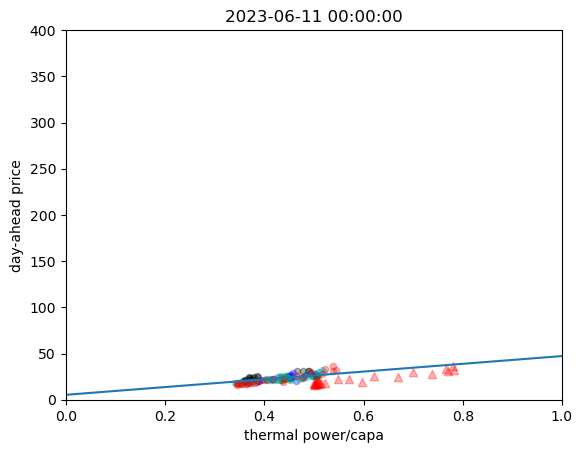

33.81317257291528
68.564004954583
57.596944673823266
50.0680759702725
51.62912684588102 51.62912684588103 51.62912684588102


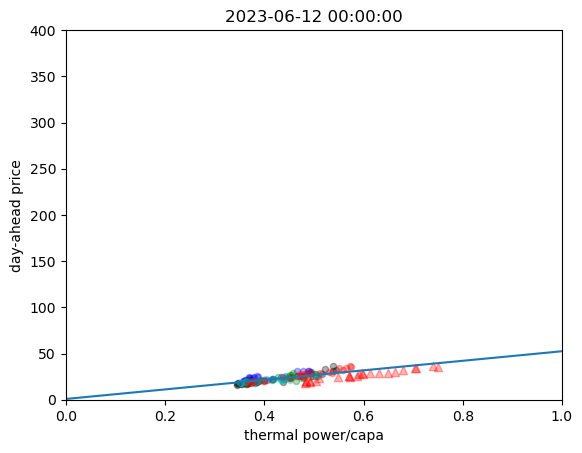

32.92140695045009
33.81310527905342
68.564004954583
57.596944673823266
64.58671812341842 64.58671812341838 64.58671812341842


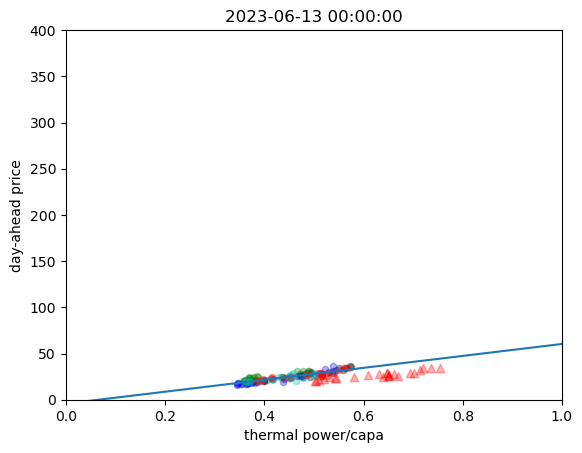

52.27976015505656
32.92140695044998
33.81310570896135
68.564004954583
66.89923648608315 66.89923648608318 66.89923648608308


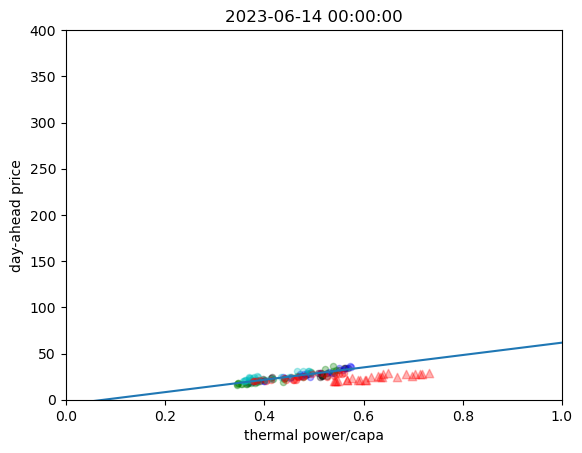

34.28100311843328
52.27976015505654
32.92140695045005
33.81310128542604
62.684970118769826 62.68497011876983 62.6849701187699


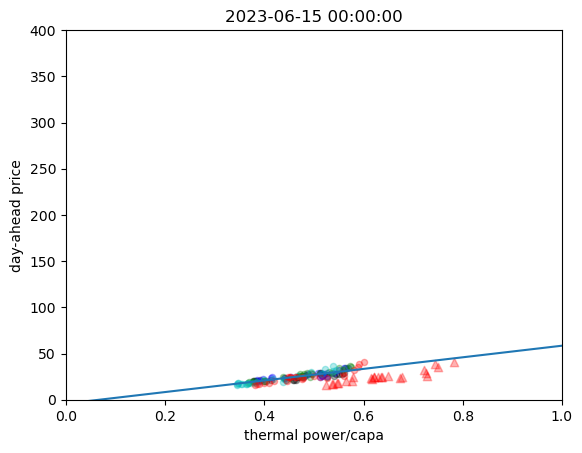

93.88040675402027
34.28100311843328
52.27976015505654
32.92140695044998
57.868181880966404 57.86818188096639 57.86818188096641


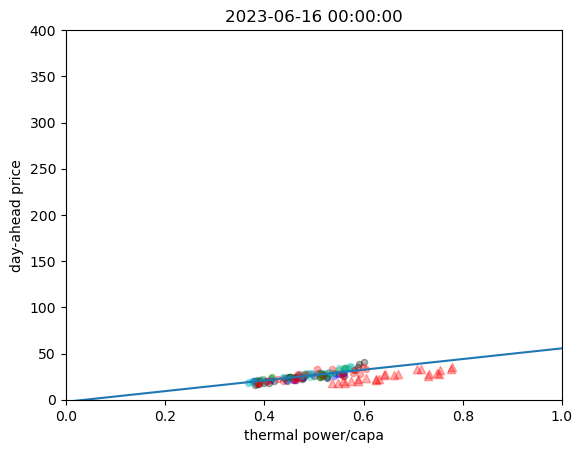

66.83713234261745
93.88040675402027
34.28100311843328
52.27976015505654
53.45705106651111 53.457051066511085 53.45705106651105


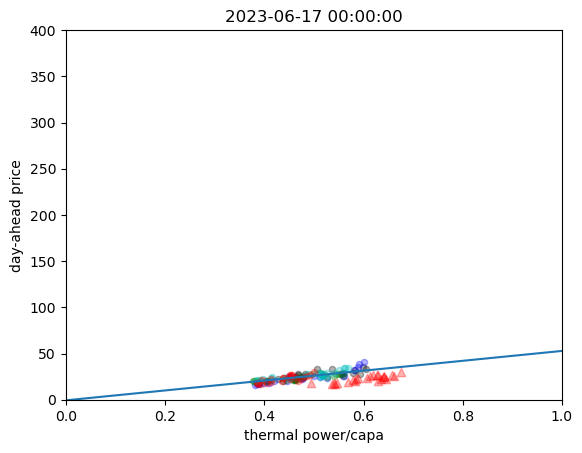

71.53638315441783
66.83713234261747
93.88040675402009
34.28100311843328
55.82434162718117 55.82434162718115 55.824341627181106


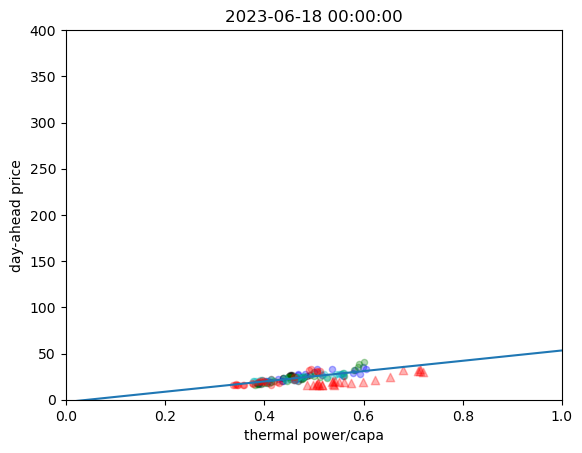

68.07352481889738
71.53638315441783
66.83713234261755
93.88040675402027
38.04300132769828 70.67515252311252 70.67515252311254


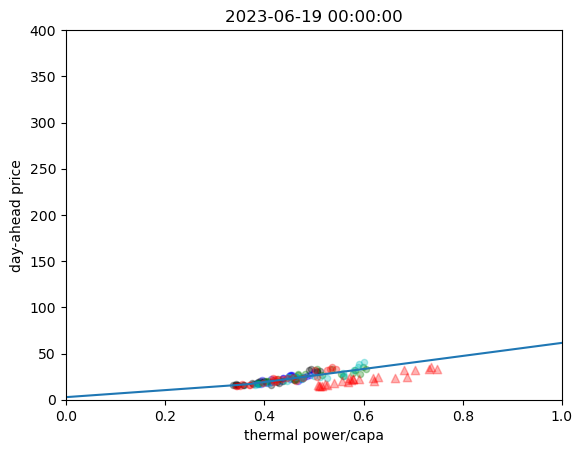

66.46900574716769
68.07352481889723
71.53638315441783
66.83713234261745
69.04721132429893 69.04721132429889 69.047211324299


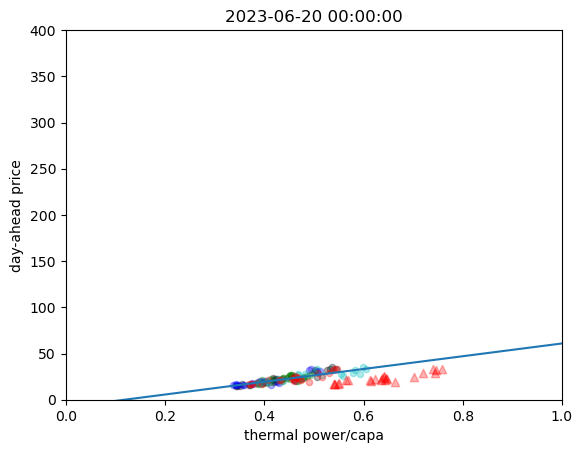

89.58807278920943
66.46900574716767
68.0735248188975
71.53638315441783
28.192068926616987 83.01797175676185 83.0179717567618


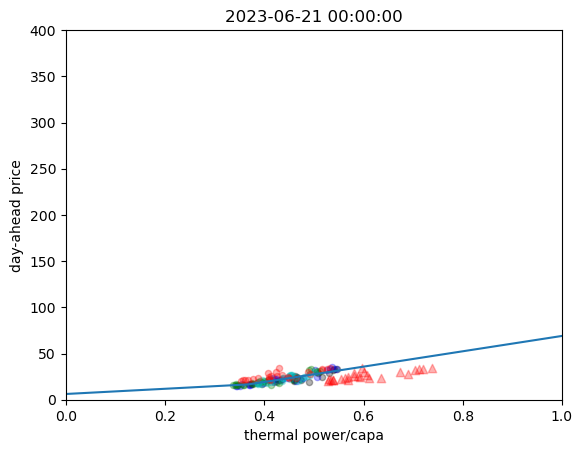

93.25483897605287
89.58807278920942
66.46900574716769
68.0735248188975
77.91434090294051 82.15170057963127 82.15170057963122


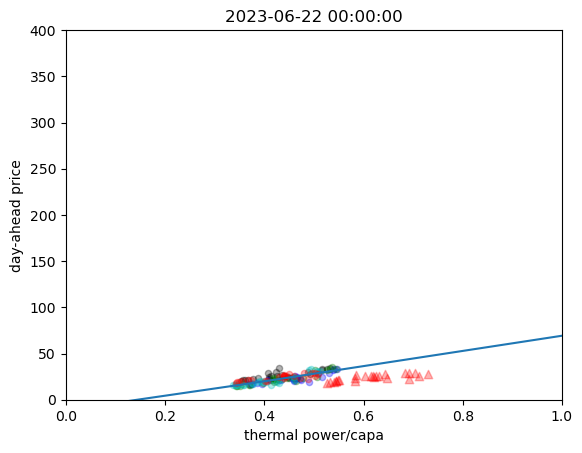

68.14162675474816
93.25483897605287
89.58807278920942
66.46900574716736
57.78315650141879 57.78315650141878 57.78315650141879


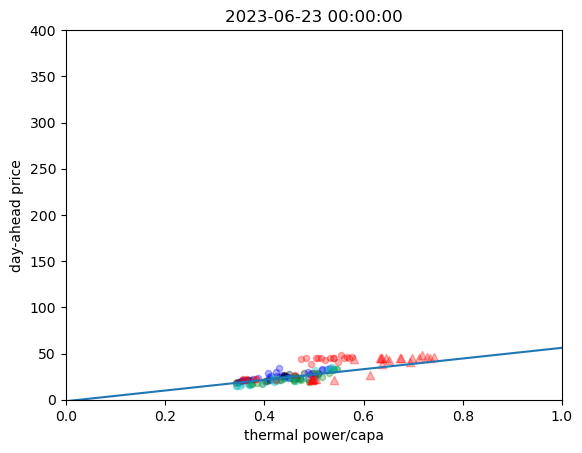

80.06435925915173
68.14162675474816
93.25483897605287
89.58807278920942
64.72743635356109 74.87505820125145 74.8750582012515


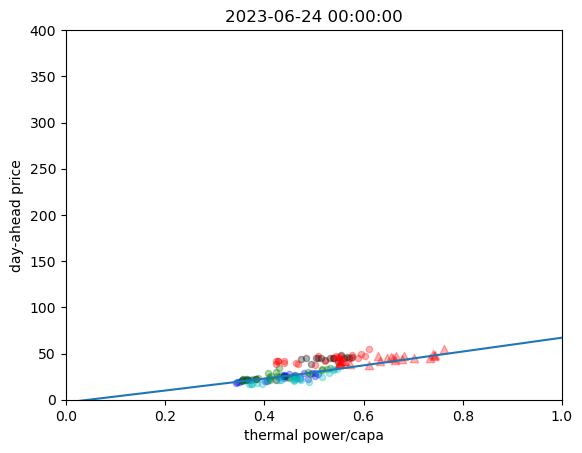

60.38215841147447
80.06435925915173
68.14162675474816
93.25483897605287
99.11057875110575 132.4527491760631 132.45274917606284


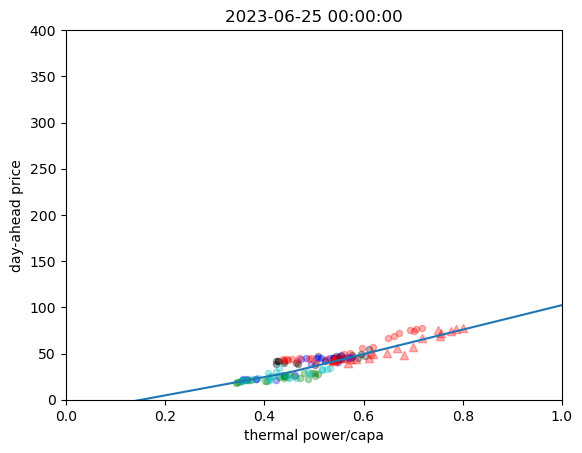

102.16545356732027
60.38215841147447
80.06435925915173
68.14162675474816
137.6923764504107 137.69237645041068 137.69237645041028


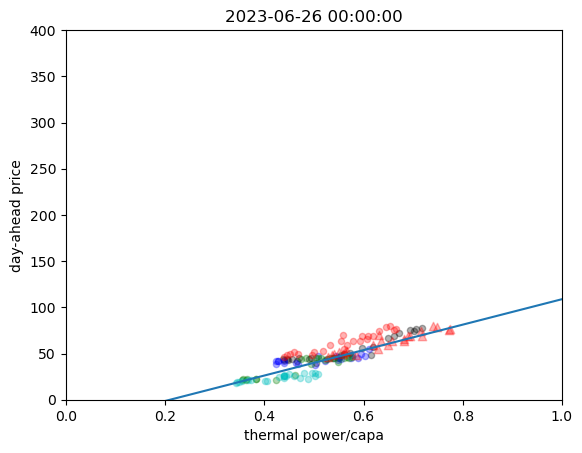

74.64742625637419
102.22161512348401
60.38215841147447
80.06435925915173
141.0867275062414 141.0867275062415 141.0867275062413


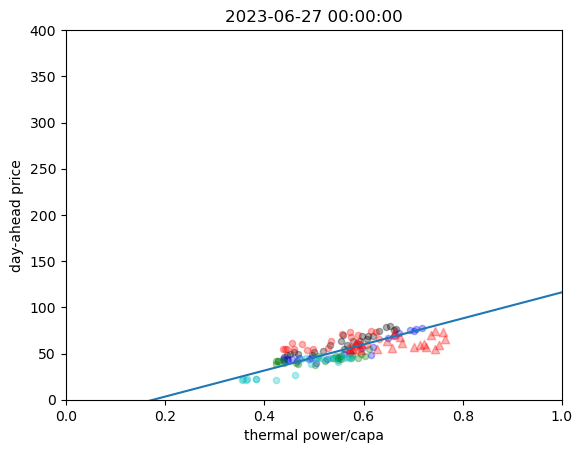

130.03691990090832
74.6474262563743
102.2217104901707
60.38215841147447
94.7061052801375 125.23779536736205 125.23779536736241


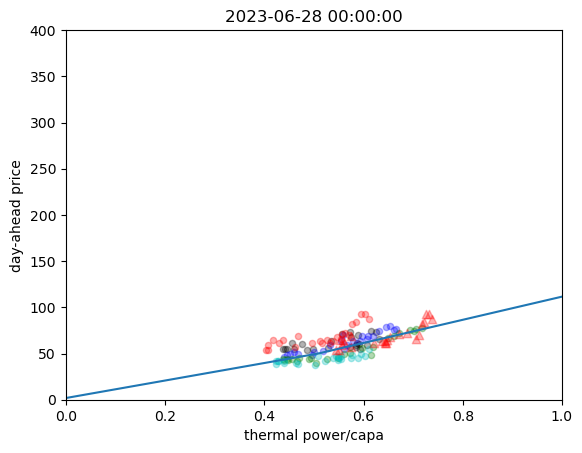

183.71886567298407
130.03691990090832
74.6474262563743
102.22149779249841
0.0 81.58889722780422 81.58889722780387


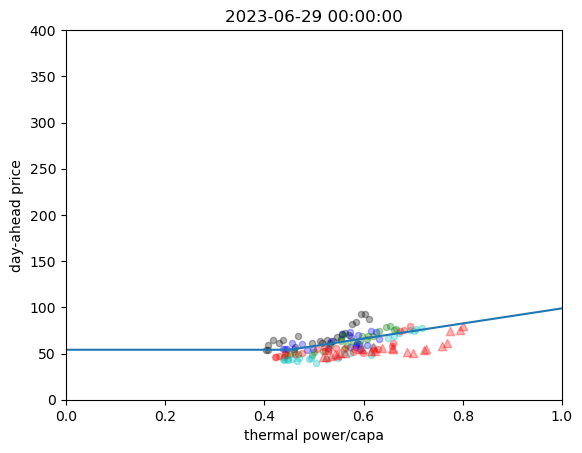

99.37139623943942
183.71886567298407
130.03691990090832
74.64742625637422
8.5225875143022 86.5129047992285 86.51290479922856


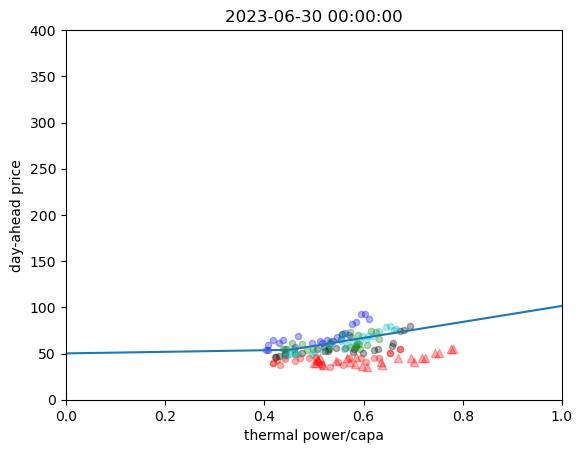

88.74082653718409
99.37139623943939
183.71886567298407
130.03691990090832
15.918524884215376 15.91852488421543 15.9185248842155


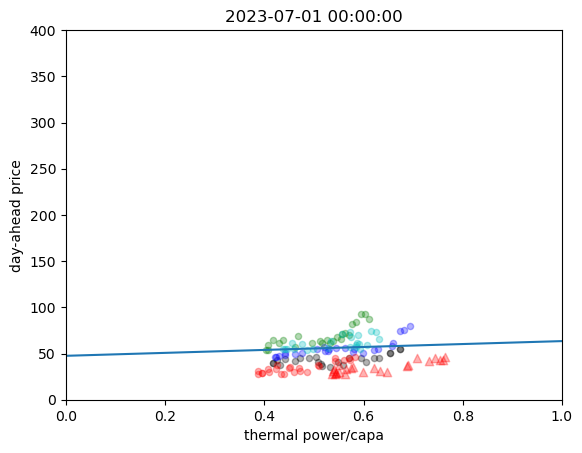

82.80809218927924
88.74082653718409
99.37139623943924
183.71886567298407
51.062884265655995 51.06288426565604 51.06288426565594


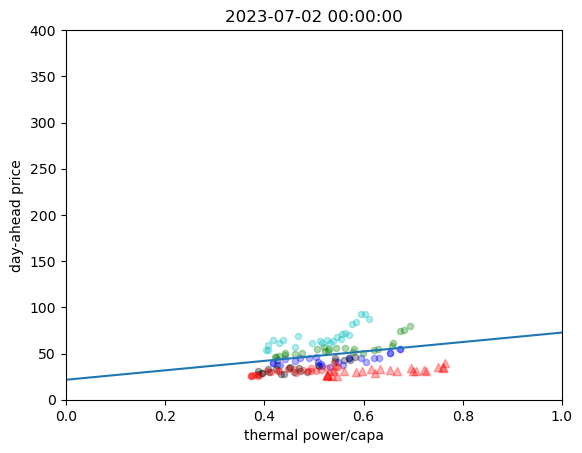

64.4254582989265
82.80809218927924
88.74082653718409
99.37139623943935
91.28615175505162 91.28615175505159 91.28615175505166


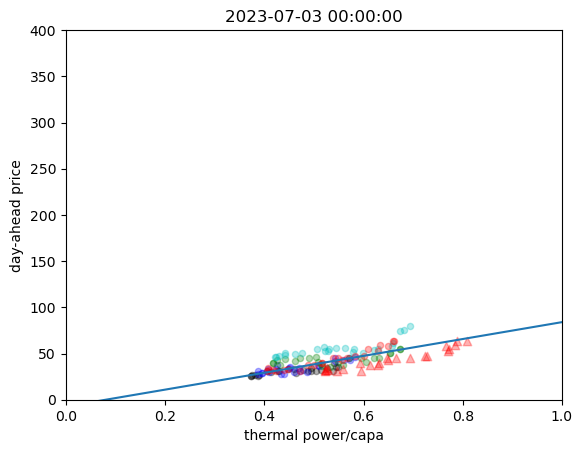

59.10996443358537
64.4254582989265
82.80809218927925
88.74082653718409
84.83293371429178 84.8329337142918 84.83293371429177


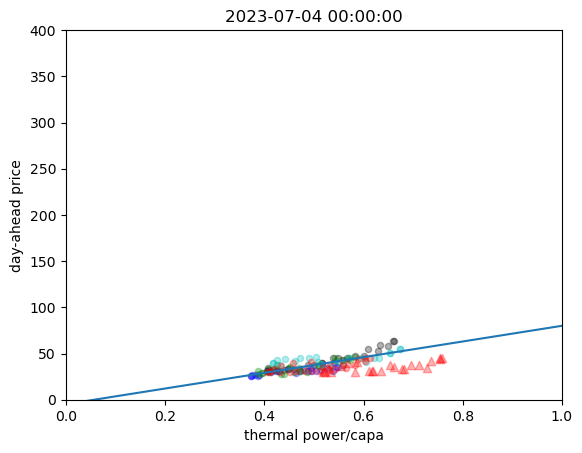

91.55687351667099
59.09760901720354
64.4254582989265
82.80809218927924
76.02489778996458 76.02489778996454 76.0248977899645


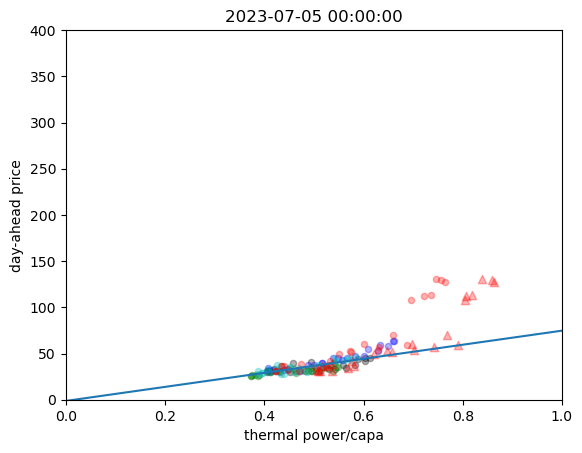

286.10557456438363
91.55687351667099
59.125193225939434
64.4254582989265
38.11514245468927 193.38573561212843 193.38573561212849


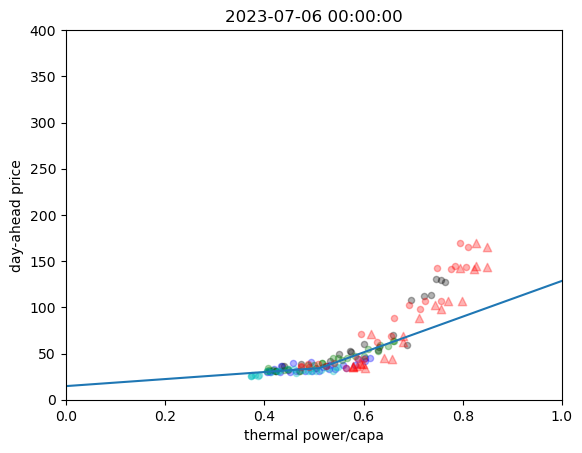

241.53515195029772
286.107675369565
91.55687351667099
59.094213123386474
85.3257715021158 536.2324979193947 536.2324979193944


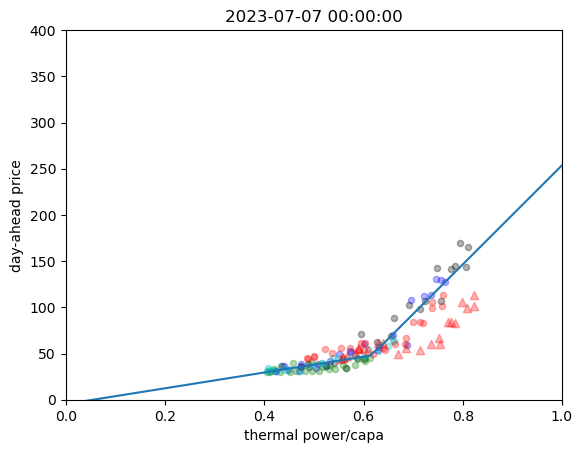

231.75770630291566
241.53490073607773
286.1055743643719
91.55687351667099
89.81056491441318 449.0904840111042 449.0904840111042


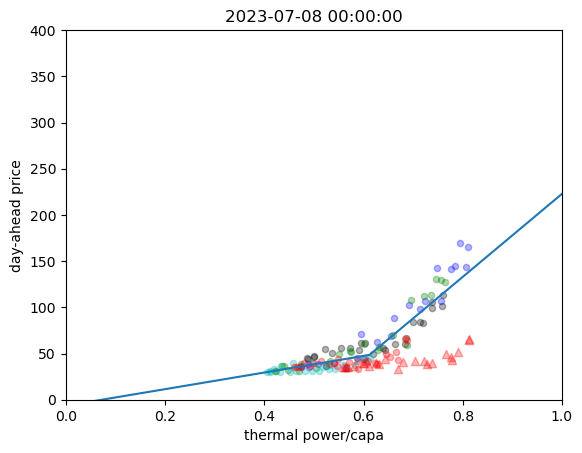

107.24274885327176
231.75770630291555
241.5348798743497
286.10557445332626
98.82408618483757 454.3028014328531 454.302801432853


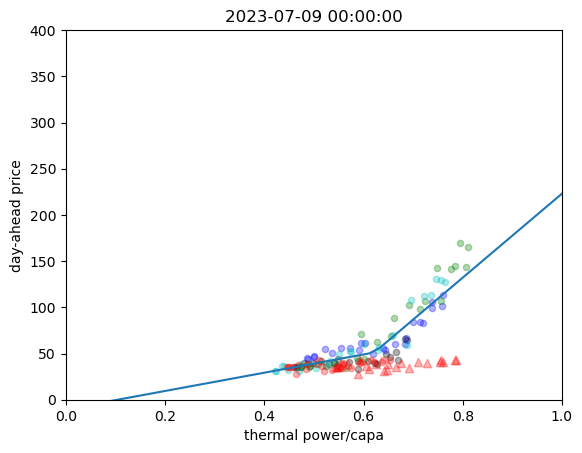

76.62003259729423
107.24274885327183
231.75770630291595
241.5352386187883
73.3055591313576 578.1274783744365 578.127478374436


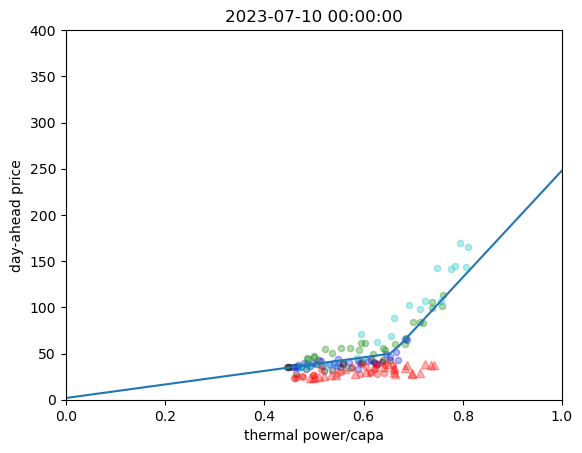

90.34854452914361
76.62003259729423
107.24274885327185
231.75770630291555
42.33807101119283 42.33807101119284 42.338071011192845


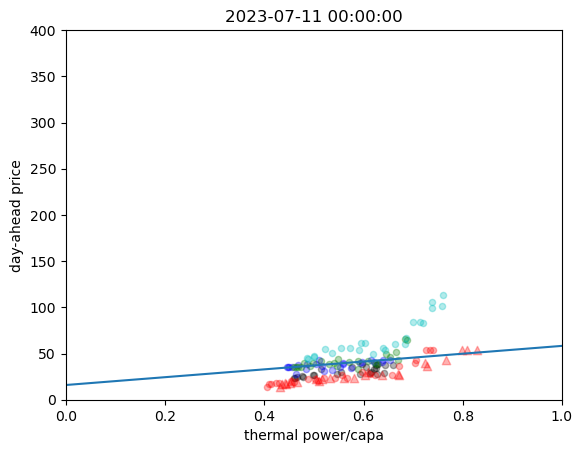

87.27849715695694
90.34854452914364
76.62003259729423
107.24274885327183
53.65877707527177 53.65877707527182 53.65877707527174


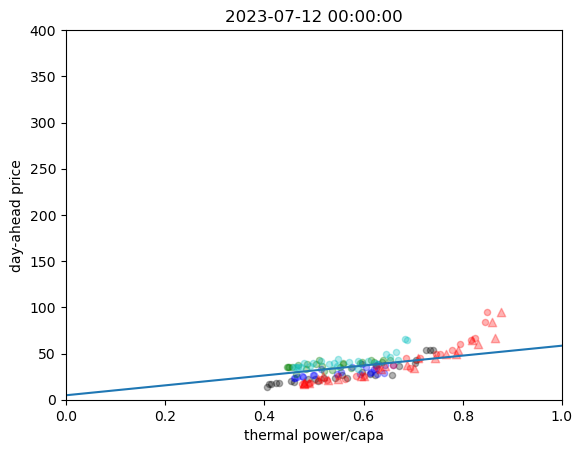

107.49821873286933
87.27849715695702
90.34854452914361
76.62003259729423
95.64857589311538 95.64857589311544 95.64857589311539


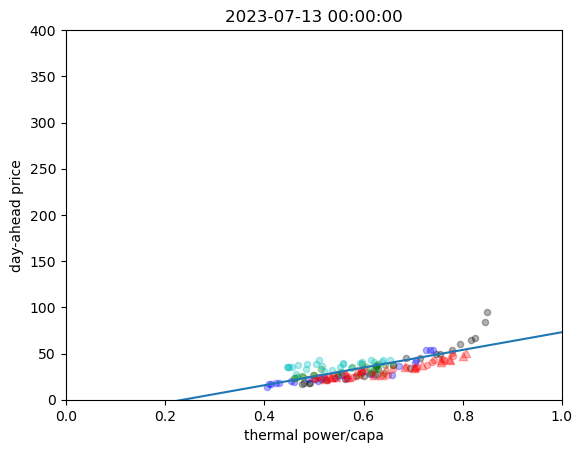

59.62379682388634
107.49824319297016
87.27849715695702
90.34854452914361
65.79888313237883 100.23240171664746 100.23240171664747


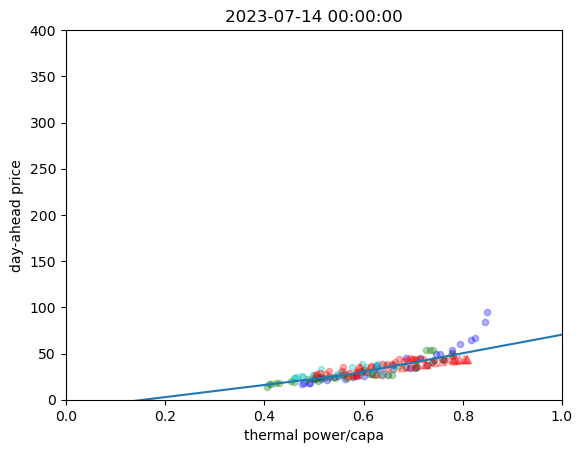

33.10370185657831
59.62379682388634
107.49825145484762
87.27849715695704
90.6912915765118 113.3481589221056 113.34815892210564


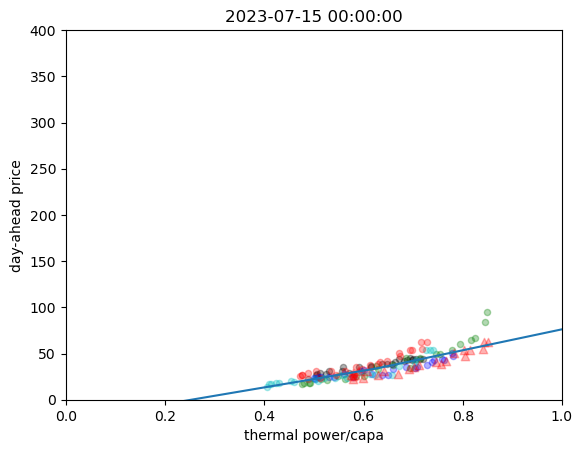

99.71214857477145
33.10370185657844
59.62379682388634
107.49823665567413
100.84233069575706 100.84233069575703 100.84233069575698


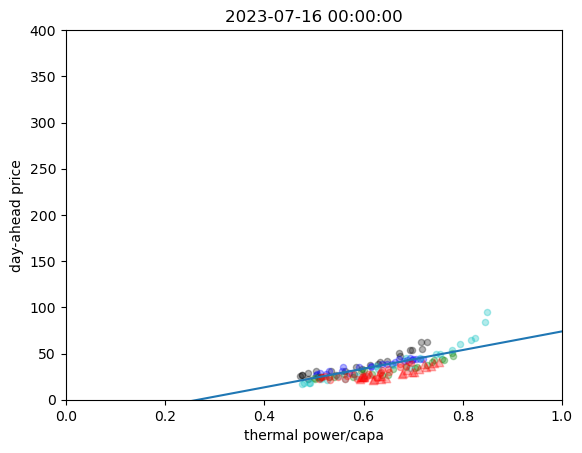

64.96730417004736
99.71214857477153
33.10370185657833
59.62379682388634
0.0 82.34214747764781 82.34214747764783


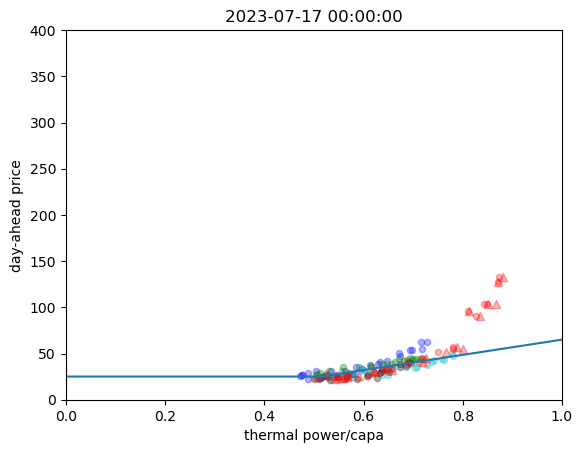

263.6228618625099
64.96730417004736
99.7121485747715
33.10370185657786
0.0 113.87608036063274 125.54589352143428


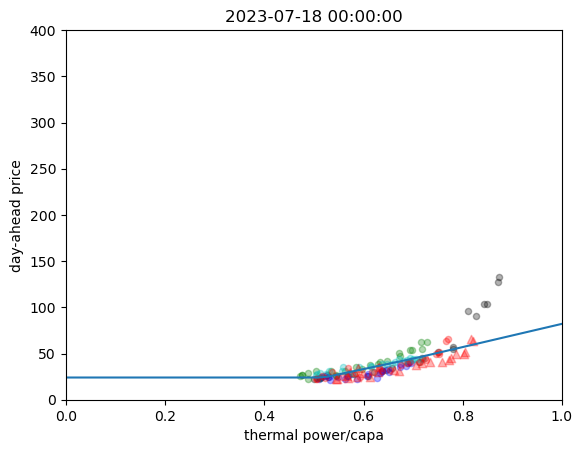

90.5250036031398
263.62216824627285
64.96730417004713
99.71214857477153
68.0008281978917 186.65719060789306 186.65719060789417


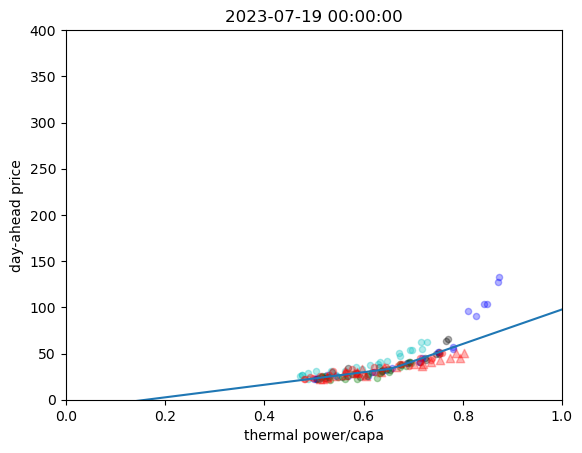

50.98677176671552
90.5250036031398
263.62216715727317
64.96730417004736
65.33254222637919 181.01272029718942 181.01272029718942


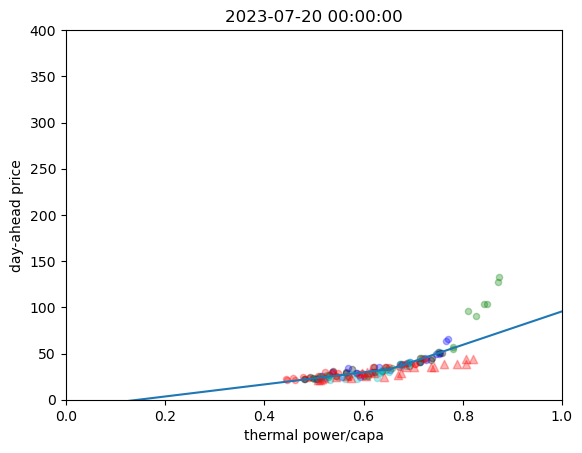

40.69445009091003
50.98677176671548
90.52500360313985
263.6221692558514
24.717507761168356 81.65308974452046 199.67289526757284


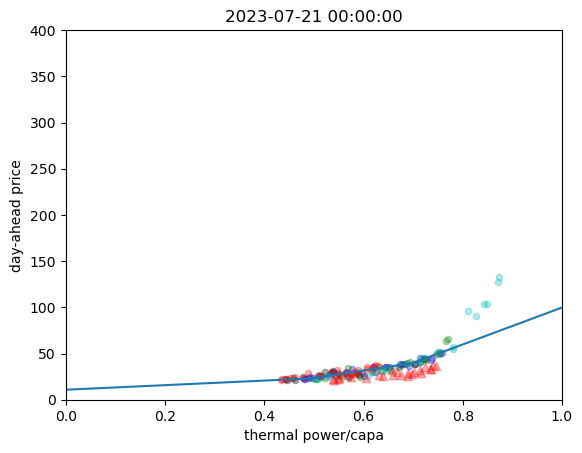

57.00293488174725
40.69445009091008
50.986771766715506
90.52500360313994
26.94180476483198 78.58871145937432 78.58871145937432


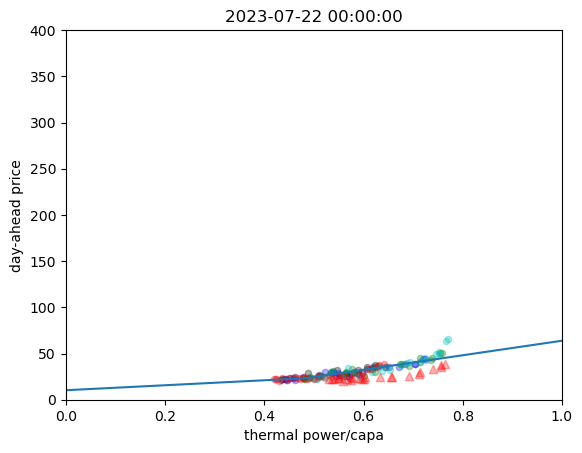

54.926983334360905
57.00293488174725
40.69445009091008
50.986771766715506
53.811568861182 85.16995460776349 85.16995460776354


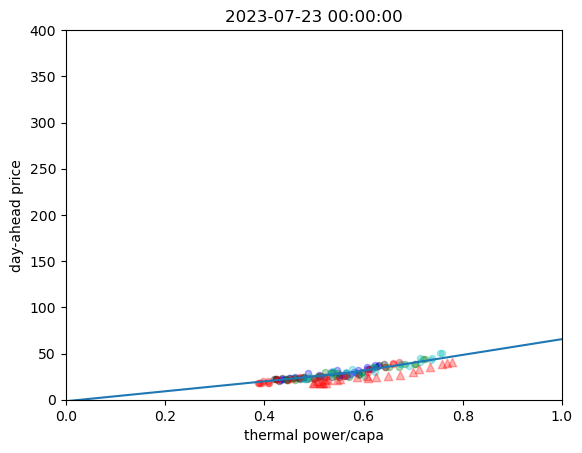

45.89002191349137
54.926983334360955
57.00293488174724
40.69445009090997
64.85124563458159 64.85124563458159 64.85124563458135


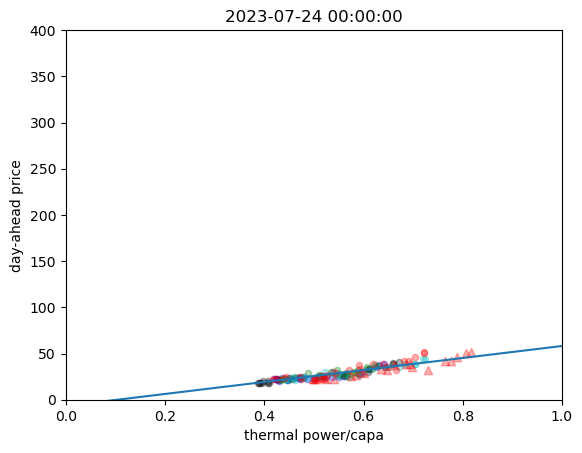

68.02679999227908
45.89002191349144
54.926983334360834
57.00293488174722
66.42585795301473 66.42585795301473 66.42585795301487


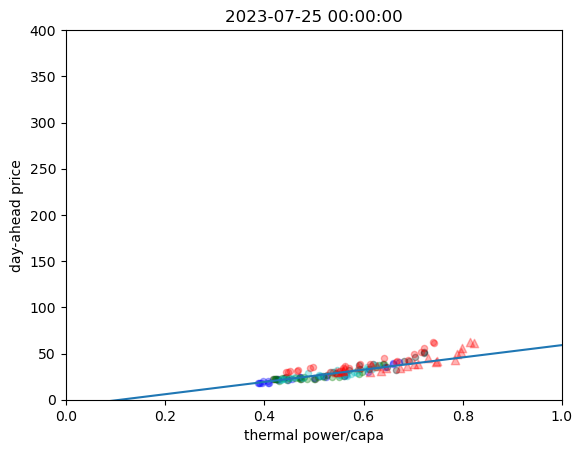

89.66399586922012
68.16188969049477
45.89002191349143
54.926983334360905
80.53872502158528 80.53872502158528 80.53872502158525


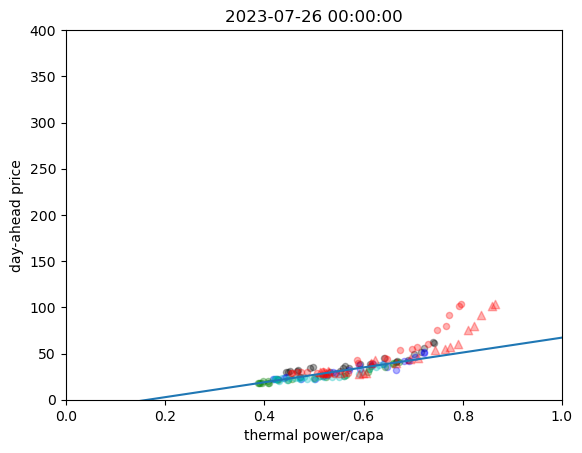

156.03442291010504
89.6639958692201
68.16188969049492
45.89002191349141
92.10437107026537 92.10437107026536 92.10437107026534


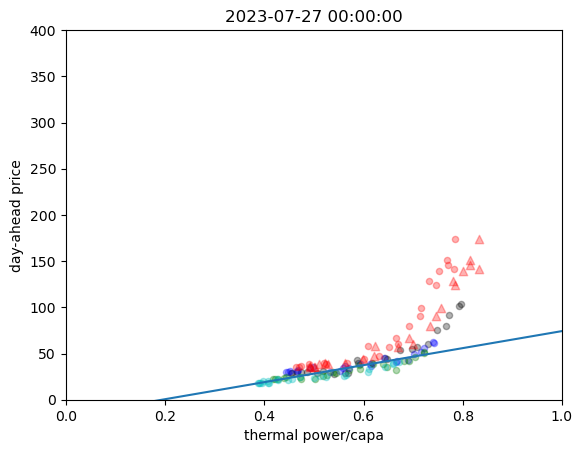

358.7864802142984
156.03442336258544
89.66399586922014
67.93522965568945
117.66490175698709 117.66490175698706 117.66490175698705


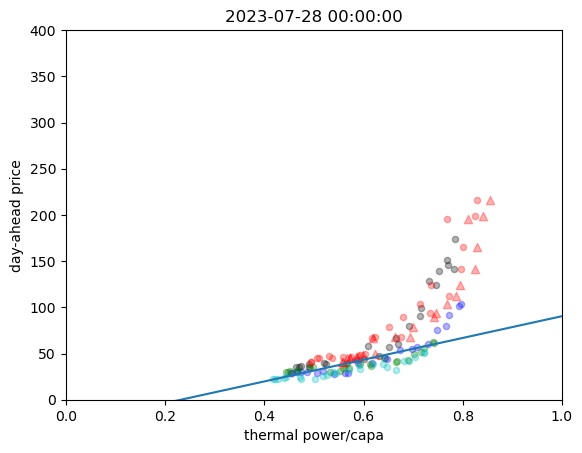

349.6592528974341
358.7853182510556
156.034423524297
89.6639958692201
43.38878940259566 299.36560552415045 299.36560552415057


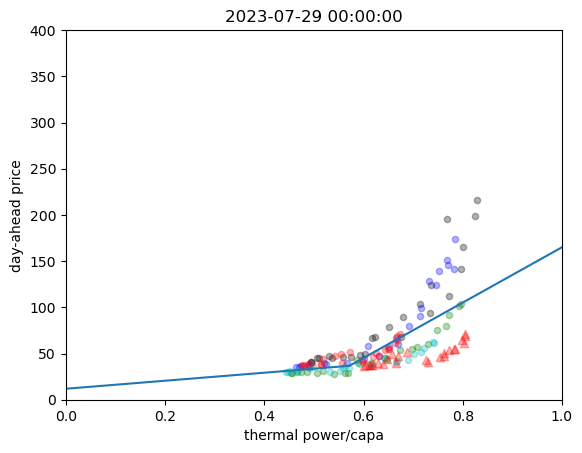

131.88381164772196
349.6596158713676
358.7878759787019
156.0344237875406
102.66390550490367 460.16072402695687 460.1607240269569


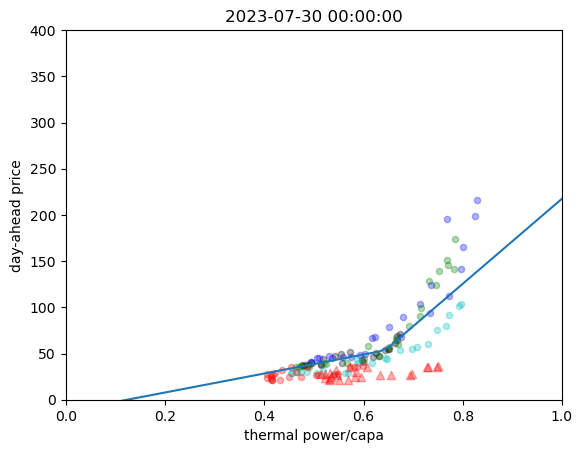

96.1937737407101
131.8838116477222
349.6592794875463
358.7853189298919
50.259253297482715 109.80597044655616 626.1606423187839


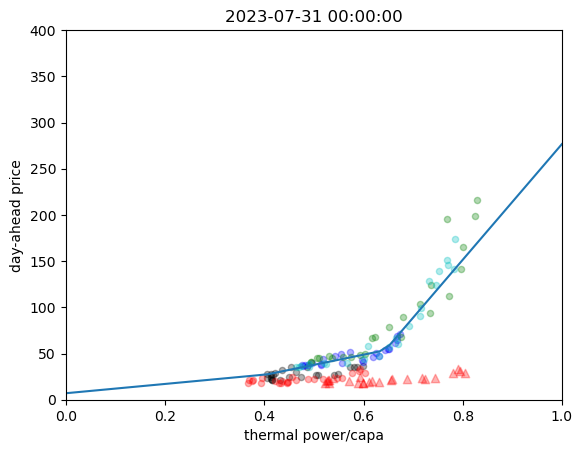

61.25515314695099
96.1937737407101
131.88381164772224
349.66036102761814
103.64918945311054 420.8910698519384 420.89106985193837


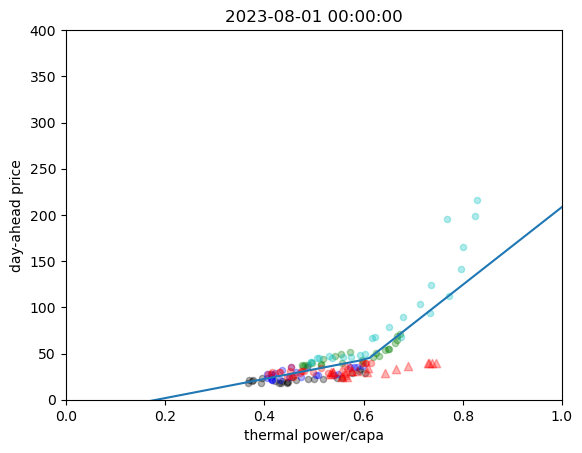

82.59766095670153
61.25515314695102
96.1937737407101
131.8838116477222
79.23108145690905 79.23108145690905 79.23108145690911


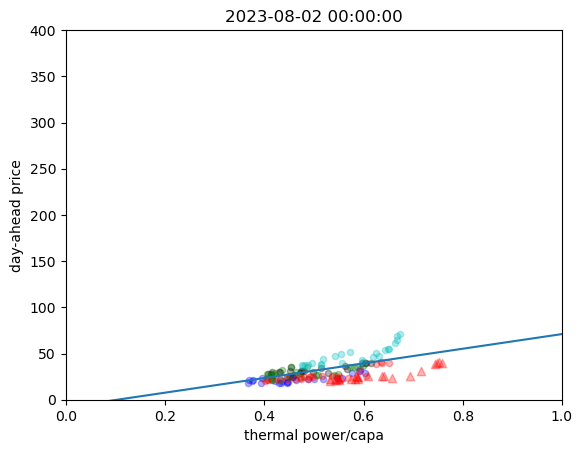

68.52857475179599
82.59766095670153
61.255153146951
96.1937737407101
46.773449836338024 46.77344983633802 46.773449836337974


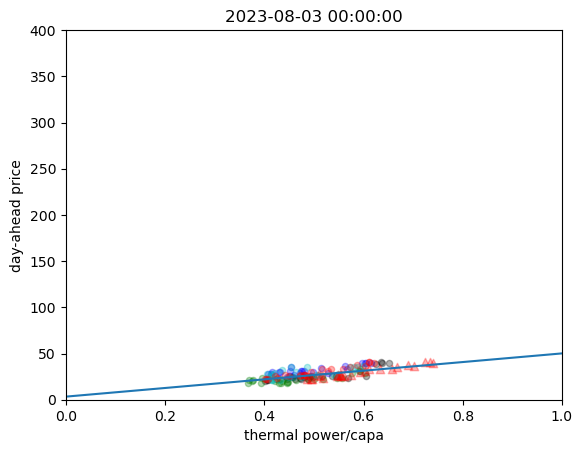

34.358124933568575
68.52857475179599
82.59766095670153
61.255153146950974
65.84833405357179 74.99653037223811 74.99653037223815


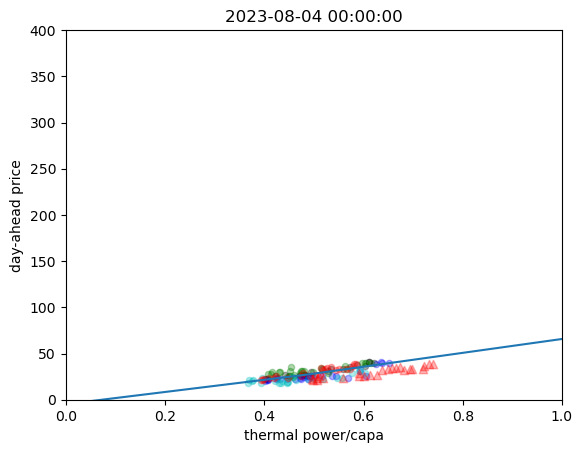

52.67817008418878
34.358124933568604
68.52857475179609
82.59766095670153
68.43673523476718 72.58083280739415 72.5808328073942


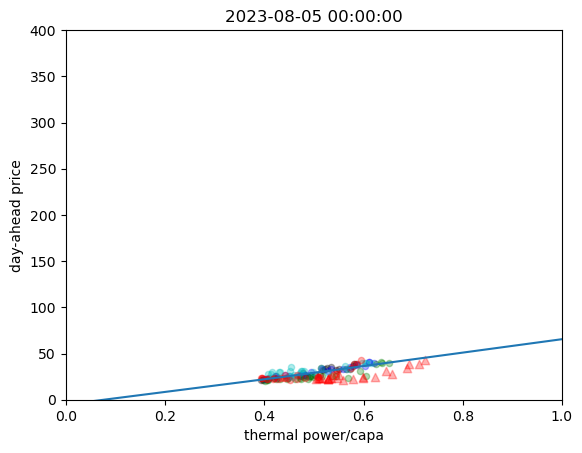

82.6766999427544
52.67817008418882
34.35812493356859
68.52857475179607
22.70055023009889 83.27772459104152 83.27772459104146


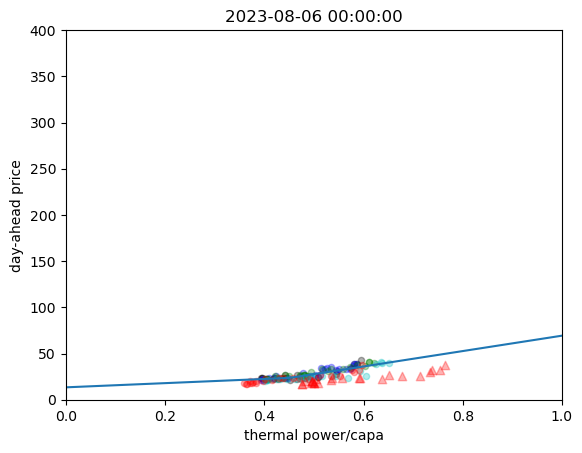

46.019238729355806
82.71290978381121
52.67817008418878
34.35812493356856
70.6778924109029 70.67789241090288 70.6778924109029


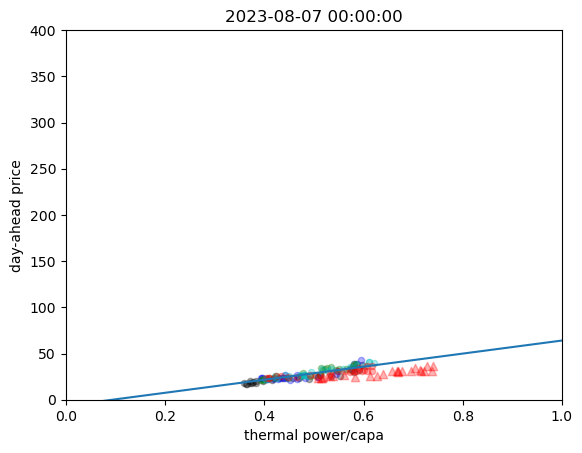

31.903530770307306
46.019238729355806
82.67669994275417
52.67817008418878
51.571353464349 51.57135346434896 51.571353464349016


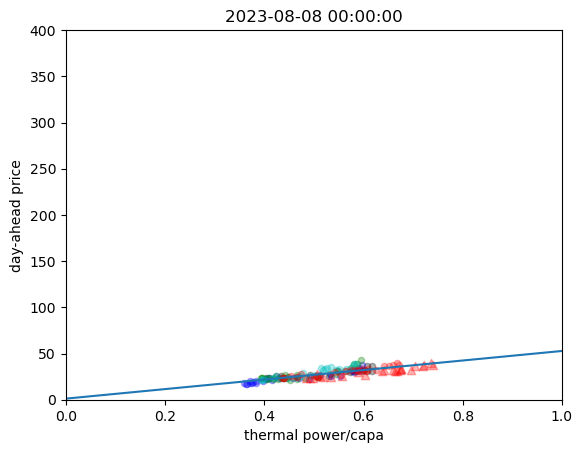

36.40439849193524
31.903530770307295
46.01923872935585
82.67669994275441
55.399656255702624 55.399656255702645 55.39965625570256


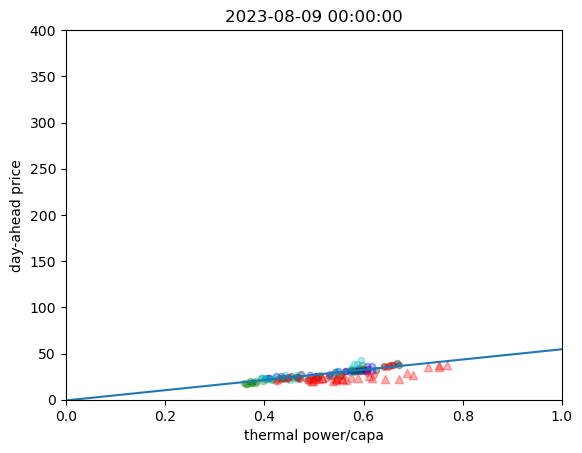

70.4440789056889
36.40439849193524
31.903530770307253
46.01923872935578
59.99900192248292 59.99900192248296 59.999001922483


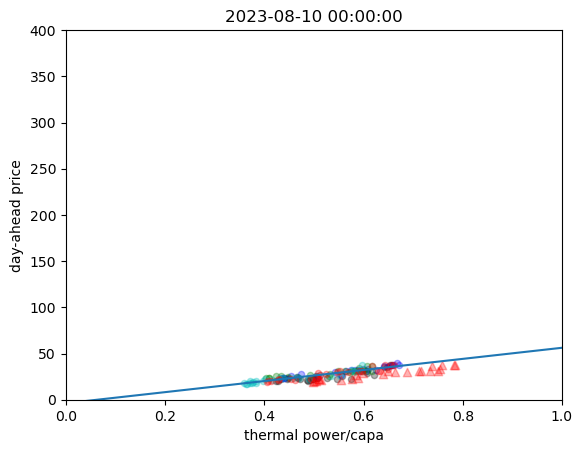

42.28053572091014
70.44407890568893
36.40439849193524
31.903530770307306
60.51055067909354 60.5105506790936 60.51055067909354


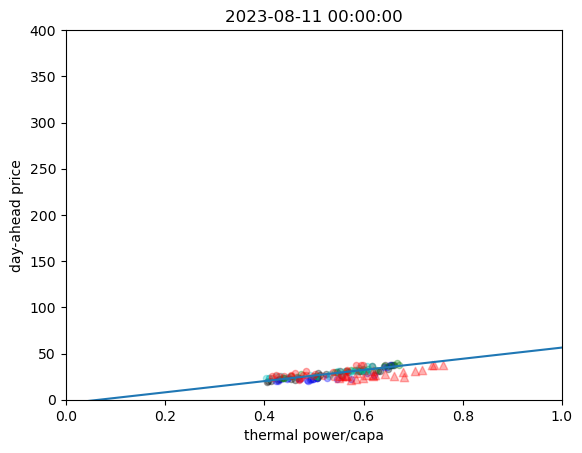

78.34857968620976
42.28053572091014
70.44407890568888
36.40439849193524
62.17942037934621 62.17942037934624 62.17942037934628


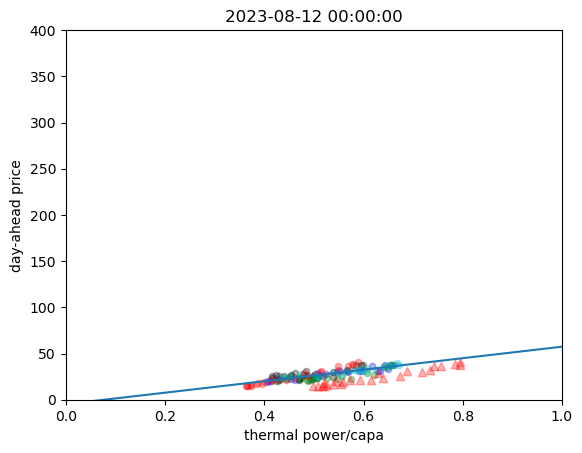

27.003423576703295
78.34857968620976
42.28053572091014
70.44407890568895
66.21590483420769 66.21590483420766 66.21590483420755


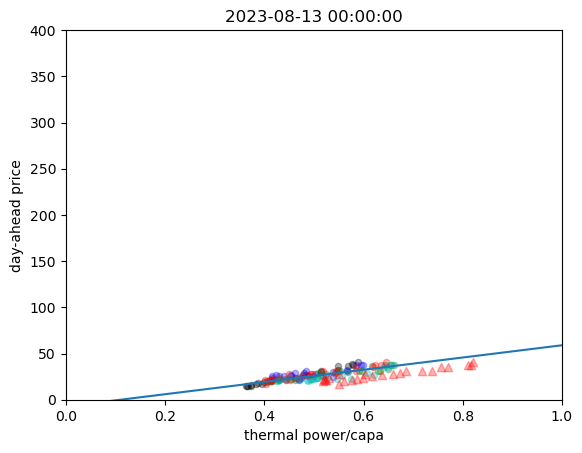

36.60092365310786
27.00342357670364
78.34857968620976
42.28053572091014
72.57604493724175 72.57604493724175 72.5760449372418


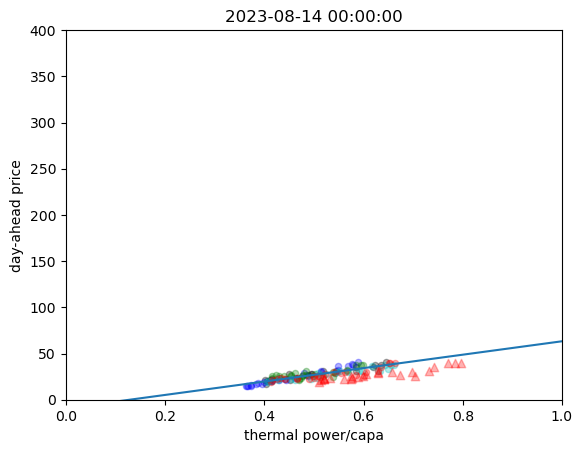

54.50015307223187
36.59820881154158
27.003423576703558
78.34857968620976
74.0994141486872 74.09941414868725 74.09941414868705


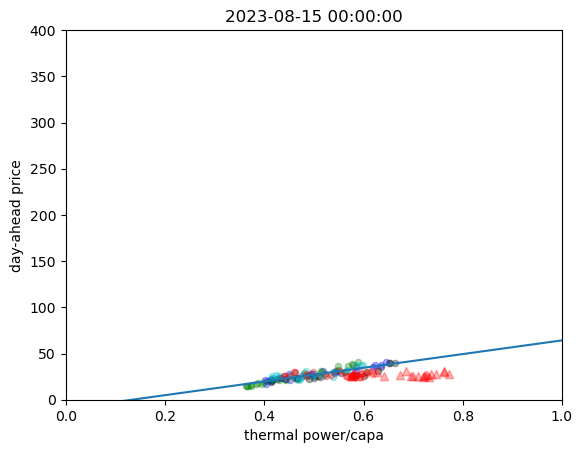

38.47260115606938
54.50015307223181
36.62060151906899
27.003423576703295
60.440812101367825 60.44081210136784 60.440812101367754


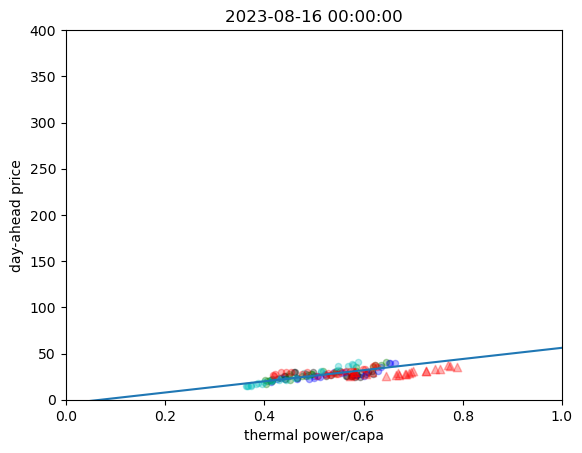

56.81067712634186
38.47260115606938
54.50015307223185
36.66707201386024
43.41502375870825 43.415023758708266 43.41502375870828


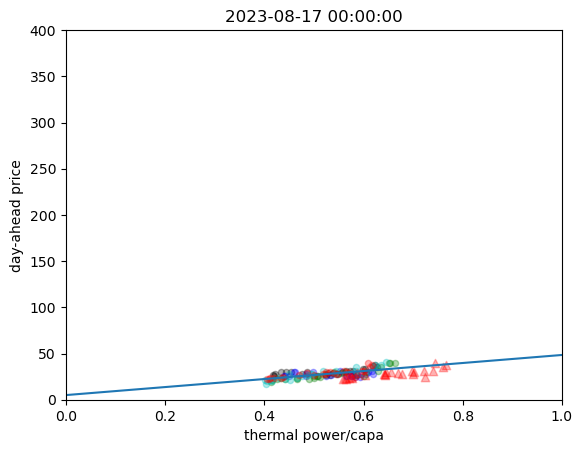

43.79406295009308
56.81067712634186
38.47260115606938
54.50015307223184
32.561126489042 32.561126489041975 32.5611264890419


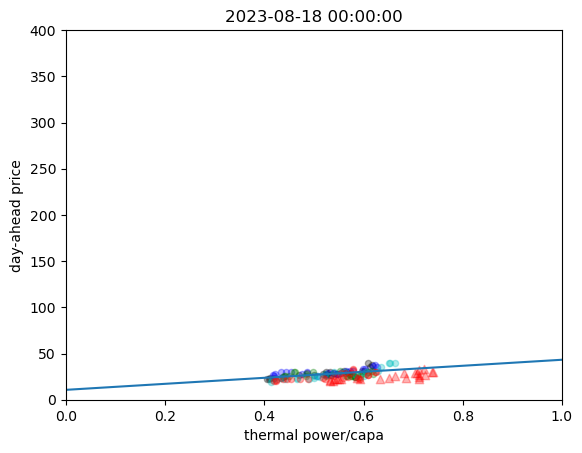

56.164212779501234
43.79406295009322
56.81067712634186
38.47260115606938
23.41245493490867 23.41245493490863 23.412454934908645


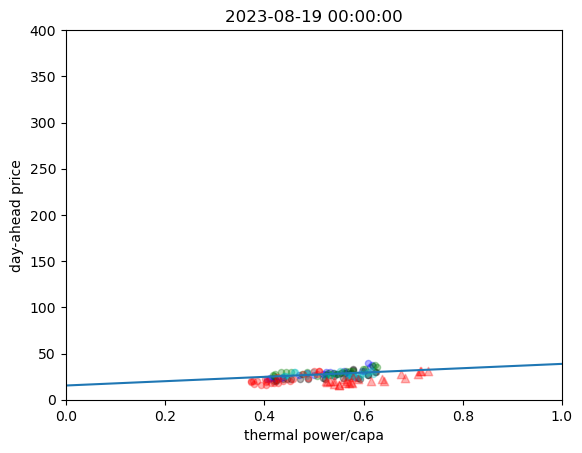

81.40785301403801
56.16421277950127
43.79406295009308
56.81067712634186
48.161063134254235 48.16106313425423 48.16106313425418


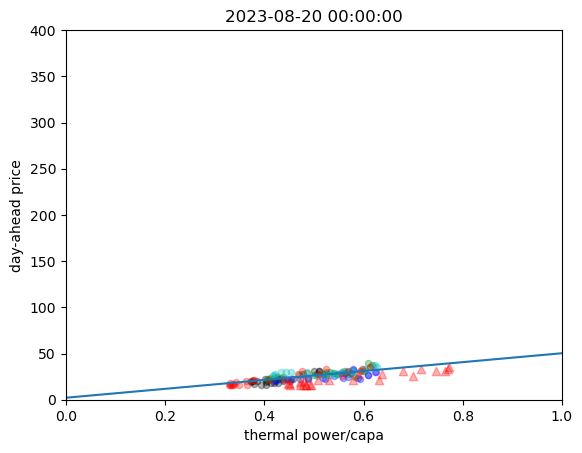

50.82879108124483
81.40785301403801
56.16421277950127
43.79406295009316
51.075543752014255 51.07554375201424 51.07554375201427


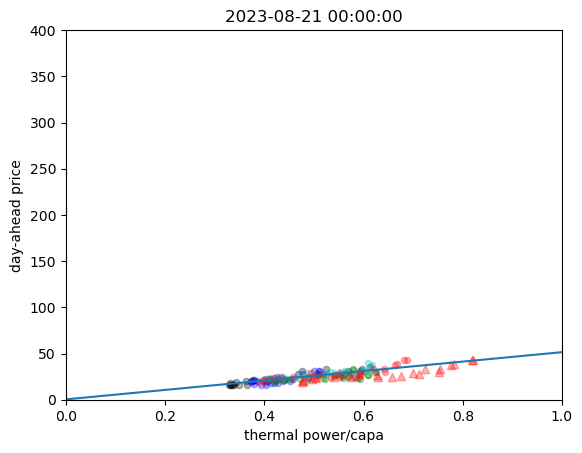

68.45484889926266
50.82879108124487
81.40785301403801
56.16421277950117
47.789474974170794 47.78947497417079 47.78947497417067


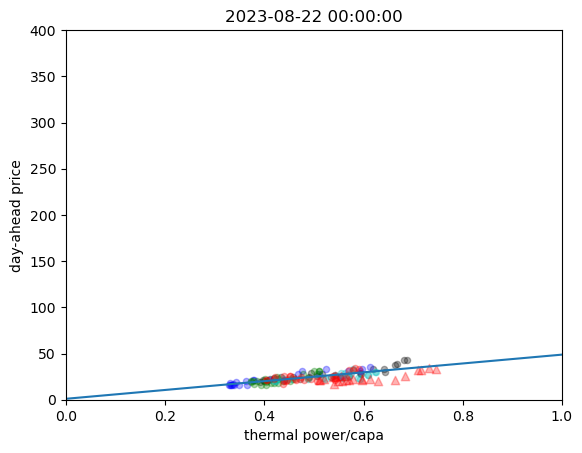

79.5882328654005
68.45484889926287
50.82879108124477
81.40785301403801
55.87832957242513 55.878329572425095 55.878329572425066


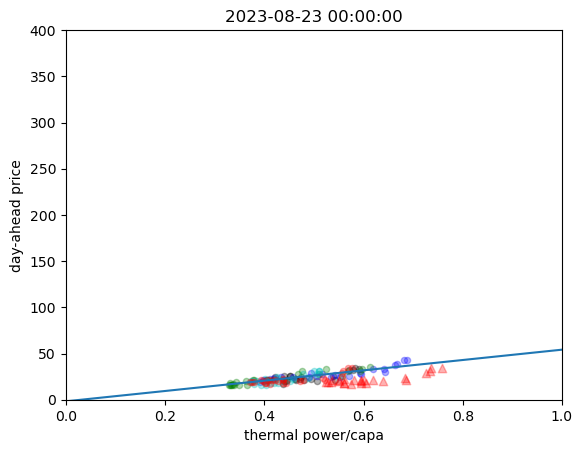

76.75897605284887
79.5882328654005
68.45484889926288
50.82879108124483
54.55998184889951 54.55998184889955 54.55998184889959


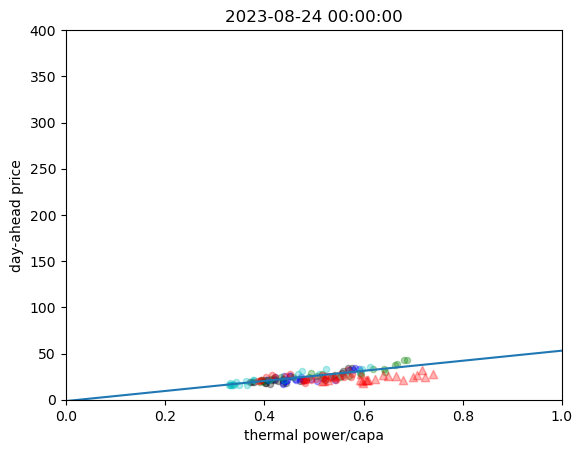

66.48537572254335
76.75897605284887
79.5882328654005
68.4548488992628
40.02123961425725 40.02123961425723 40.021239614257276


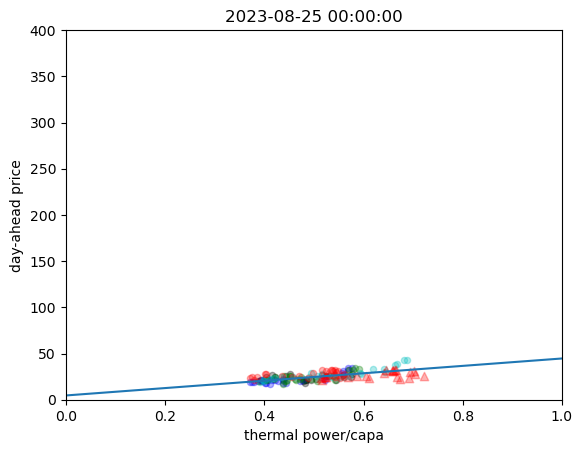

75.48712634186624
66.48537572254335
76.75897605284887
79.5882328654005
33.89141596320727 33.891415963207244 33.89141596320731


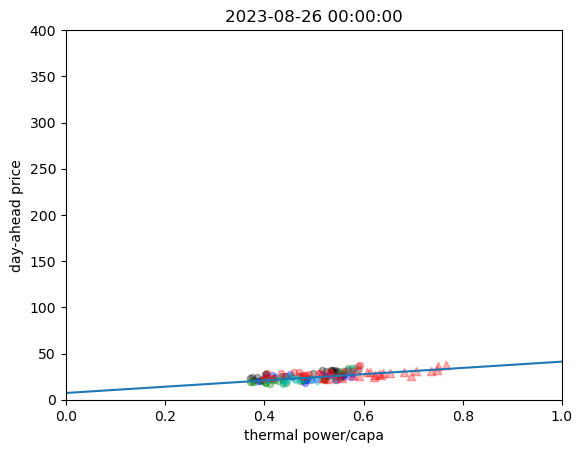

69.025995045417
75.48712634186624
66.48537572254335
76.75897605284887
26.68712188042833 26.68712188042835 26.687121880428368


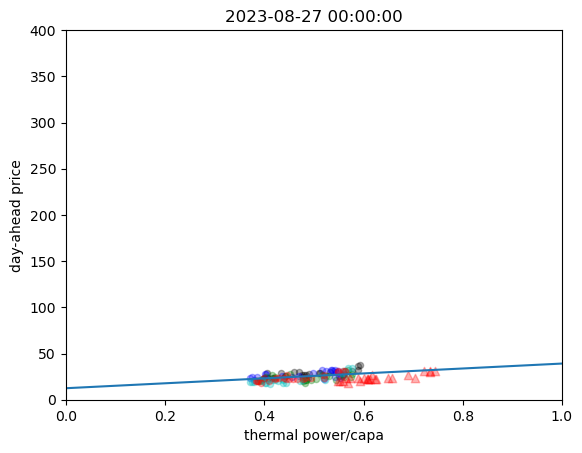

59.338926507018996
69.025995045417
75.48712634186624
66.48537572254335
23.928483344435993 23.92848334443603 23.928483344435968


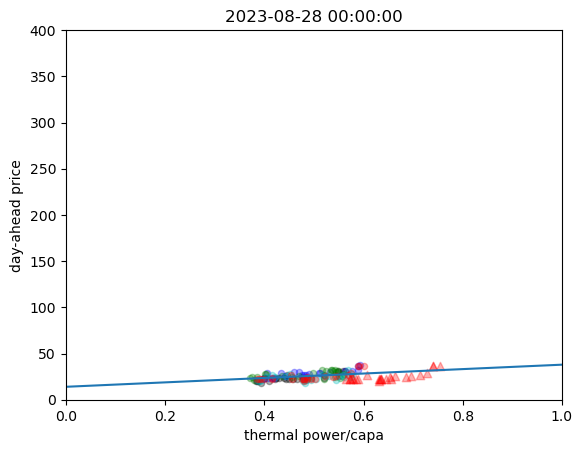

68.43267505994801
59.338926507018996
69.025995045417
75.48712634186624
40.38860476127255 40.38860476127251 40.38860476127251


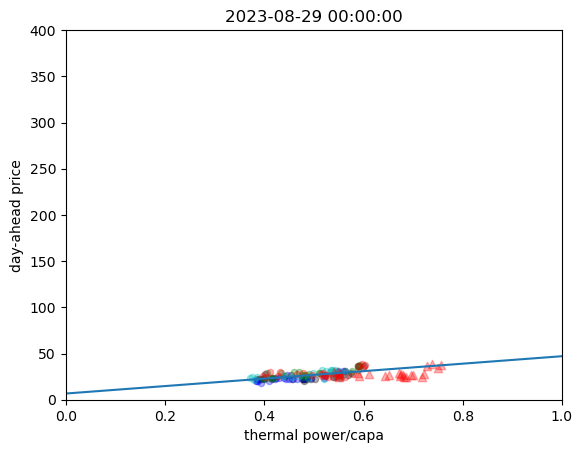

66.40822460776218
68.4326750599481
59.338926507018996
69.025995045417
32.38060937582113 32.38060937582115 32.380609375821166


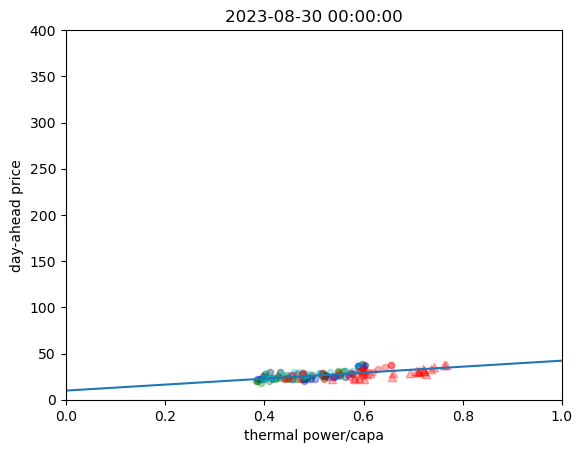

66.53197042148759
66.40822460776218
68.43267505994801
59.338926507018996
36.78490823684036 47.344623522963424 47.34462352296329


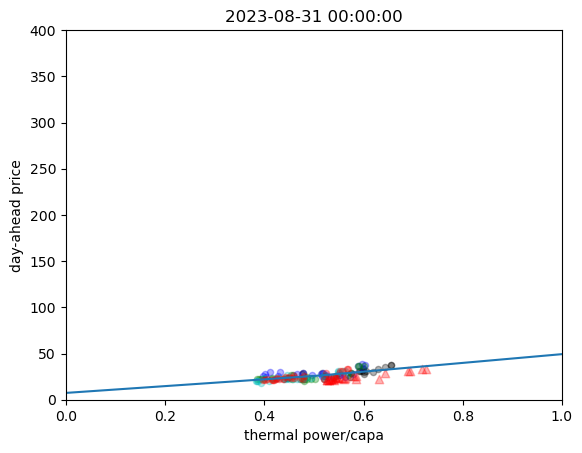

64.23707679603632
66.53197042148759
66.40822460776218
68.43267505994801
8.965937892401643 45.59600470696385 45.59600470696391


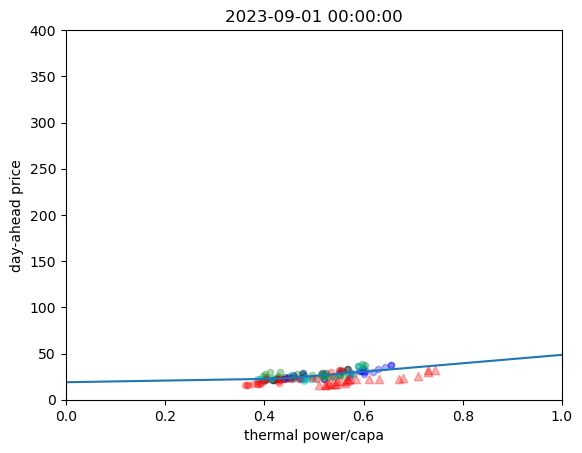

61.10943161778275
64.23707679603632
66.53197042148759
66.40822460776218
53.90479074267505 53.904790742675075 53.904790742675125


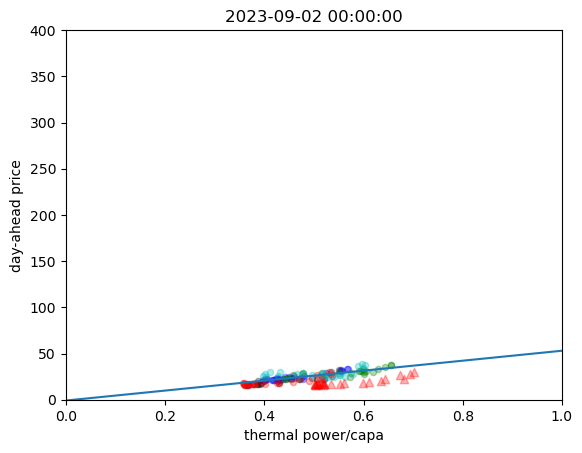

46.731246869377316
61.10943161778272
64.23707679603632
66.53197042148759
61.9912727350748 61.99127273507479 61.9912727350748


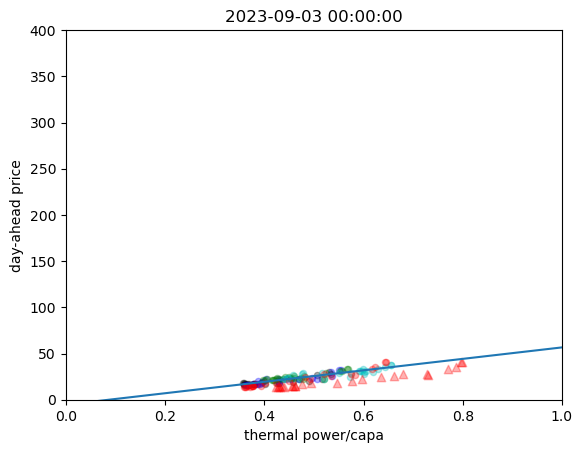

36.88143295751497
46.731099456958304
61.10943161778275
64.23707679603632
72.09773840000034 72.09773840000028 72.09773840000047


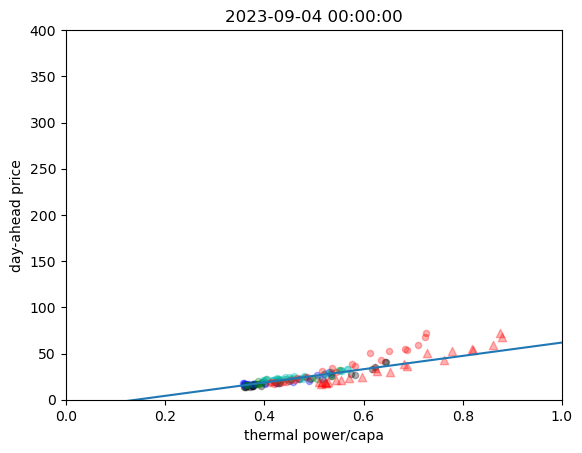

58.361429076490225
36.7293903969014
46.73101857715152
61.10943161778273
77.79033858226539 117.41110581445763 117.4111058144578


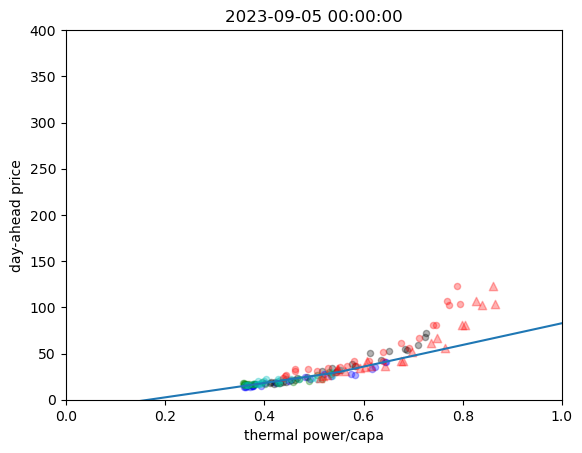

177.83970964652983
58.361418033309945
36.729390396901515
46.73102222557948
59.64704218606812 155.04935074215487 155.04935074215484


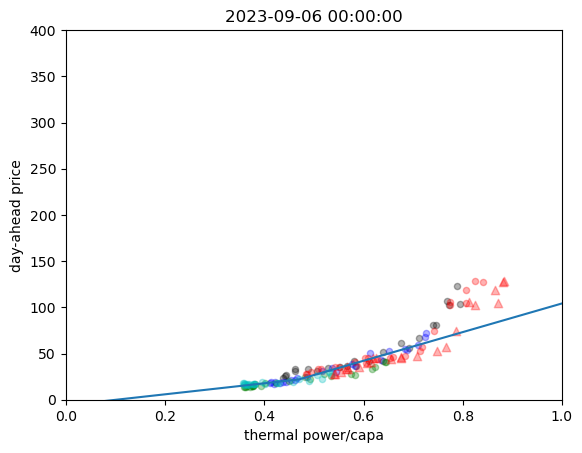

306.67557493754106
177.8396709673439
58.361431786468486
36.729390396901465
94.60139976965256 116.99185517789047 406.429375638956


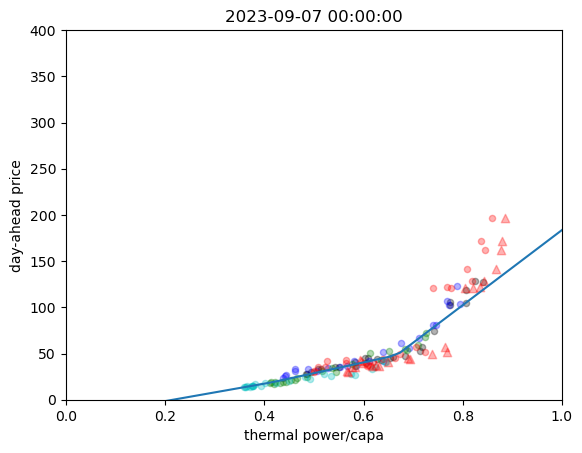

297.32486439629656
306.675574937541
177.83967101089848
58.361418071028325
52.118858817187444 138.93768277010753 573.9889086256215


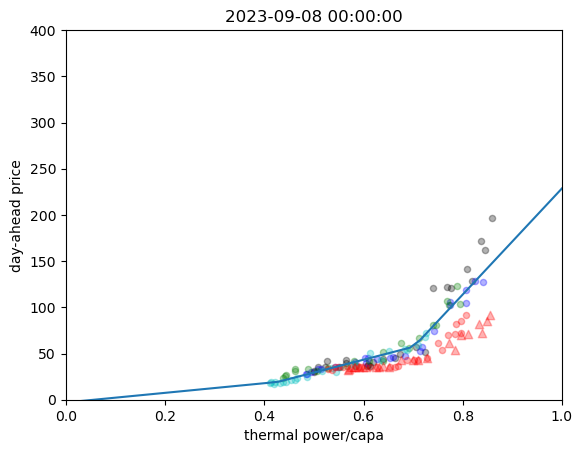

219.15669577512472
297.32519867843894
306.67557493754
177.83973785158653
70.18424557898554 106.16164044433236 541.9390834185107


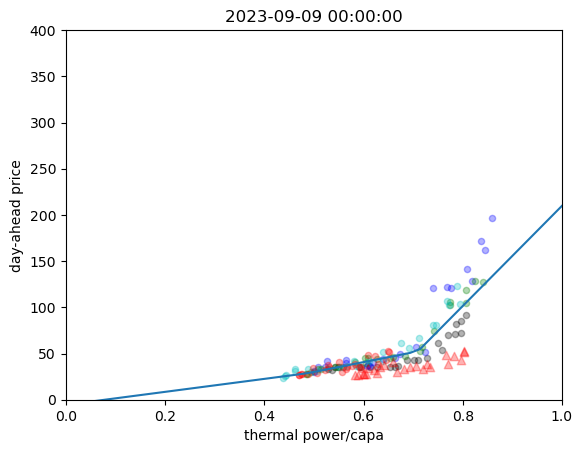

132.72596640416825
219.15321657557536
297.32640145631285
306.6755749375408
108.5925613876482 435.3678729729834 435.3678729729828


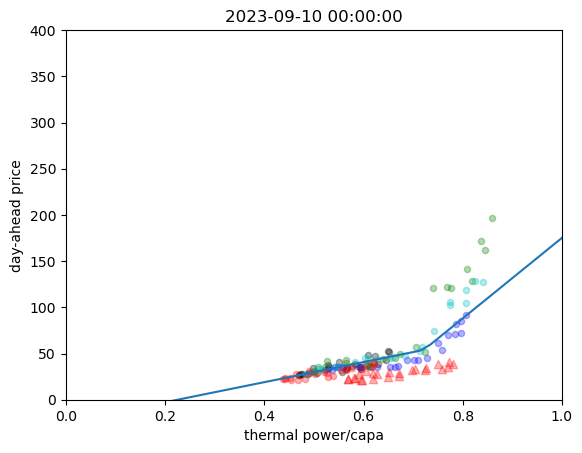

58.8841184734373
132.72596640416816
219.1532165772762
297.324868049342
99.72959598037274 99.72959598037272 259.8986735023896


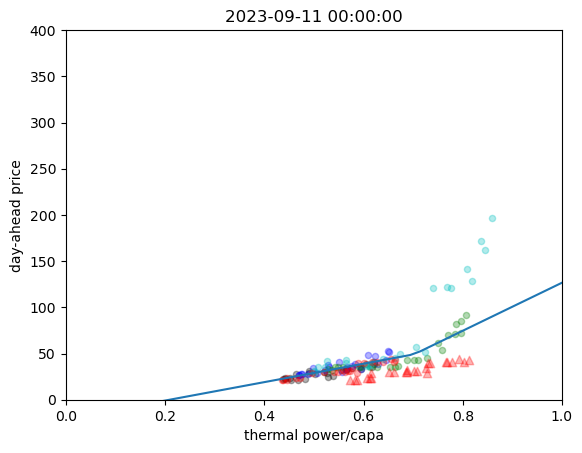

45.91537996008492
58.8841184734373
132.72596640416816
219.15343800589298
92.42734999711752 92.42734999711756 92.42734999711755


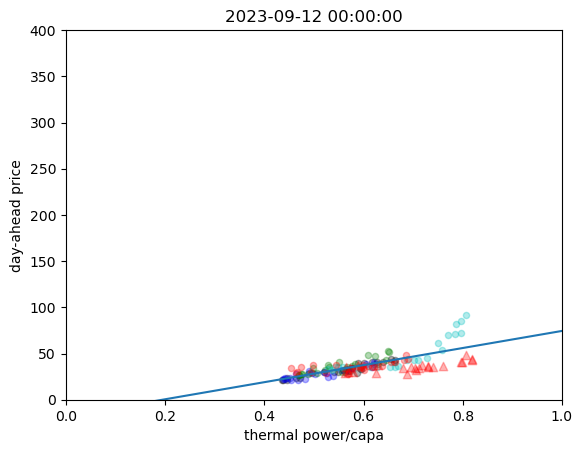

83.43433509425061
45.91537996008502
58.8841184734373
132.72596640416825
82.25513065986044 82.25513065986046 82.25513065986028


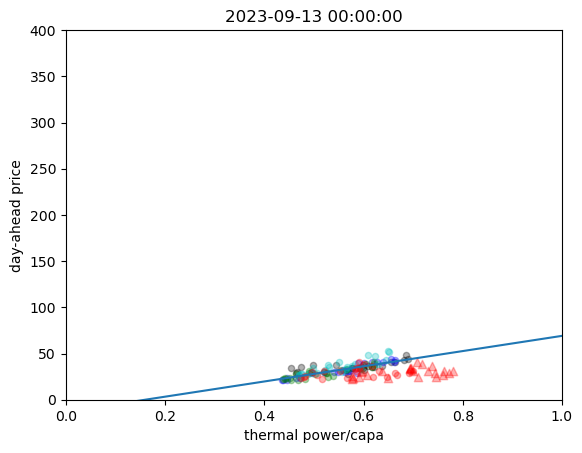

91.13383154417838
83.43433509425061
45.91537996008504
58.8841184734373
75.38883580739851 75.38883580739851 75.38883580738882


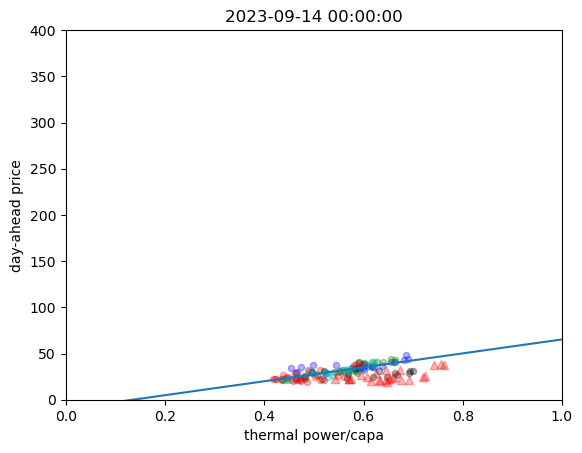

98.45547481420313
91.13383154417838
83.43433509425063
45.91537996008505
73.07993595527093 73.07993595527093 73.0799359552662


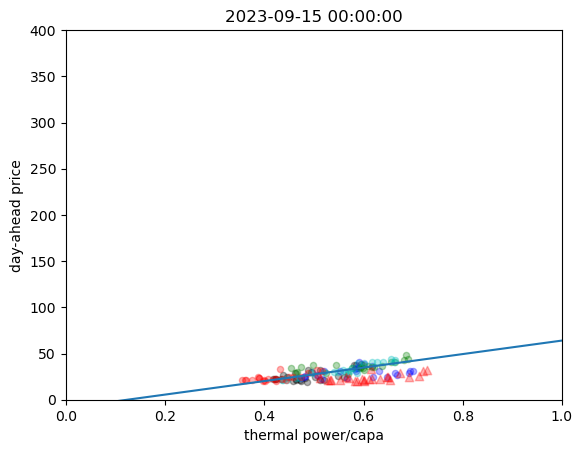

63.23902559867878
98.45547481420313
91.13383154417838
83.43433509425064
17.009349415331133 64.45881331154577 64.45881331155255


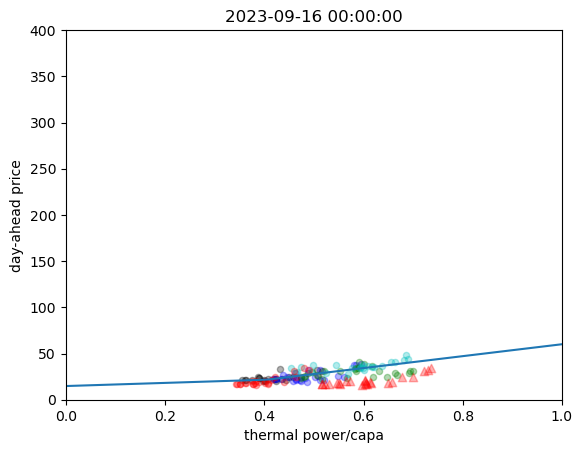

81.60919075144508
63.23902559867878
98.45547481420313
91.13383154417838
32.60991776846439 32.60991776846438 32.60991776846586


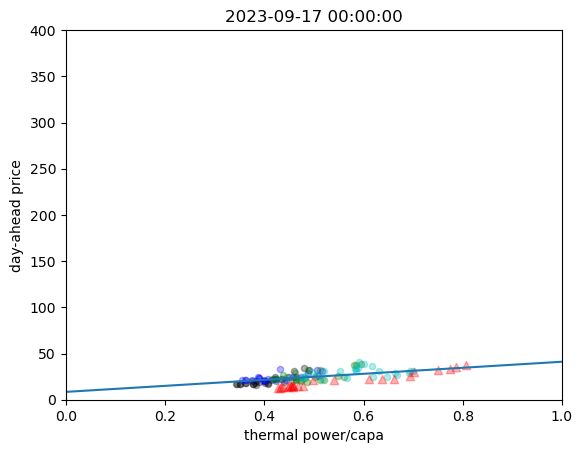

81.60919075144508
63.23902559867878
98.45547481420313
33.42003247424551 33.42003247424546 33.420032474245545


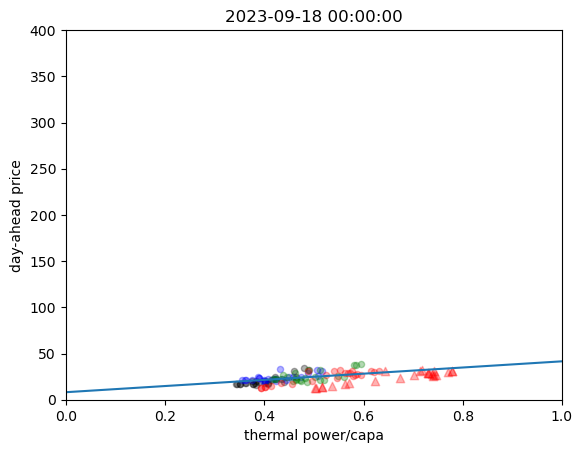

56.69343707655629
81.60919075144508
63.23902559867878
45.116968371815325 45.11696837181535 45.11696837181542


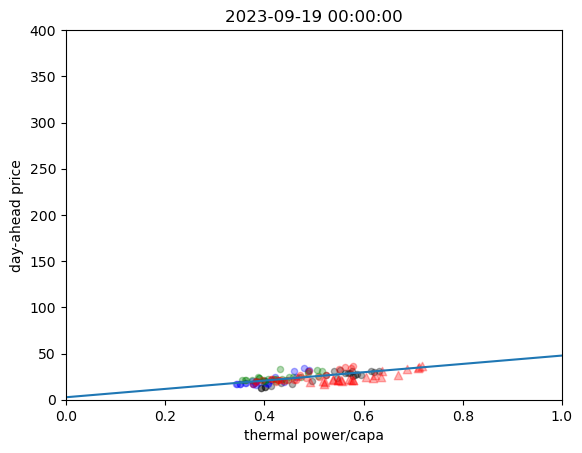

77.50550896030444
56.69343707655629
81.60919075144508
50.86309368481524 50.86309368481524 50.863093684815325


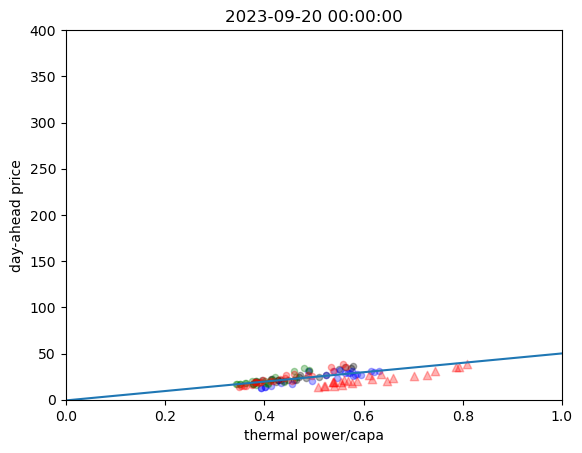

61.70423146442038
77.50550896030444
56.69343707655629
51.25586148818934 51.25586148818932 51.25586148818935


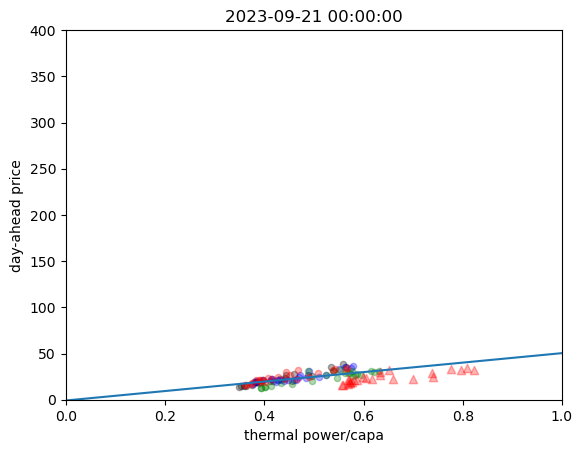

74.49122772418008
61.70423146442038
77.50550896030444
56.69343707655629
57.01790606427673 57.017906064276694 57.01790606427681


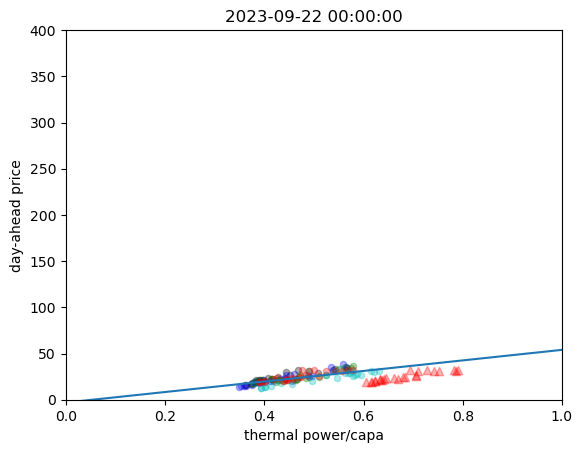

61.4209963222101
74.4912277241801
61.70423146442046
77.50550896030444
79.94342368718469 79.94342368718466 79.9434236871847


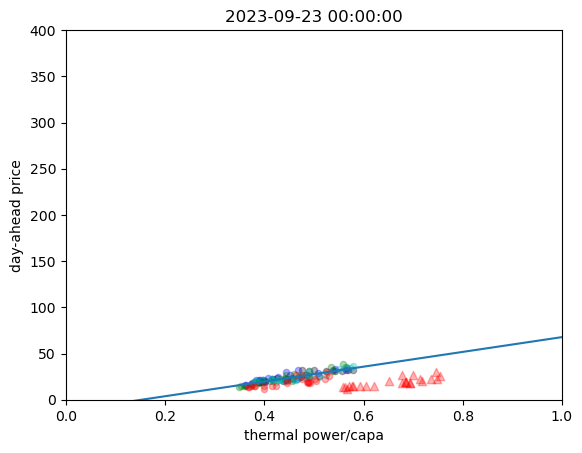

57.29693998868334
61.4209963222101
74.49122772418013
61.70423146442038
73.4122949733395 73.41229497333947 73.41229497333934


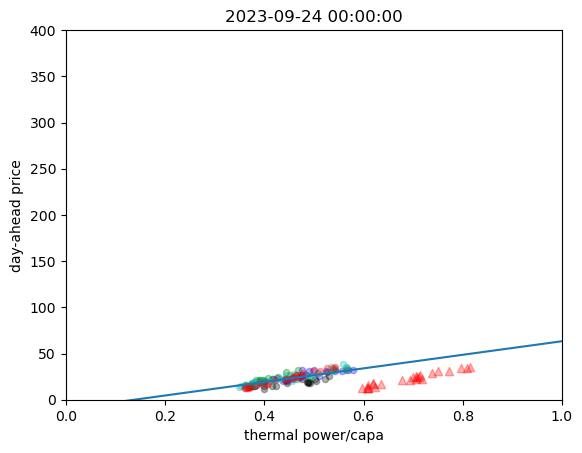

23.4183095380754
57.29693998868334
61.4209963222101
74.49122772418013
78.710837980095 78.710837980095 78.71083798009494


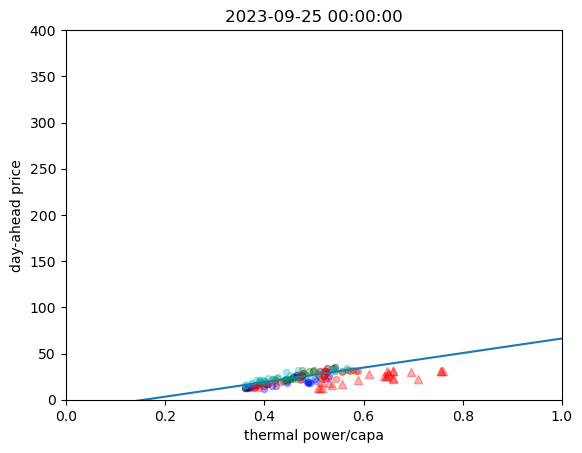

55.521325713312294
23.418309538075494
57.29693998868335
61.4209963222101
83.30030044391356 83.30030044391356 83.3003004439135


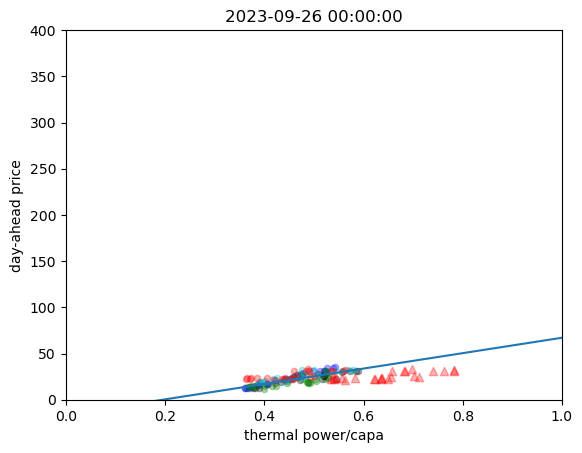

71.50347535169882
55.521325713312294
23.41830953807555
57.29693998868335
82.14868167075826 82.14868167075824 82.14868167075828


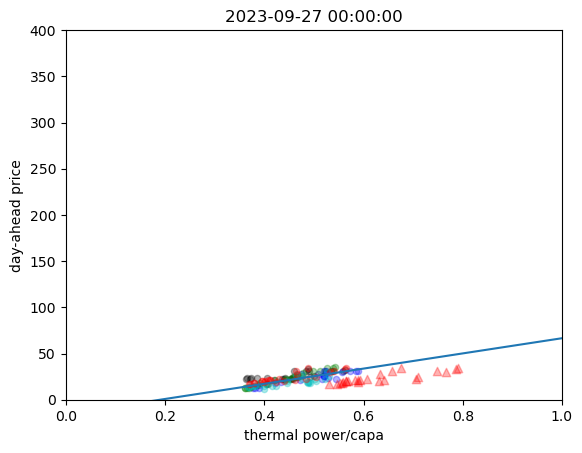

74.07890868280109
71.5034753516989
55.521325713312294
23.418309538075494
71.59805116904886 71.59805116904884 71.59805116904886


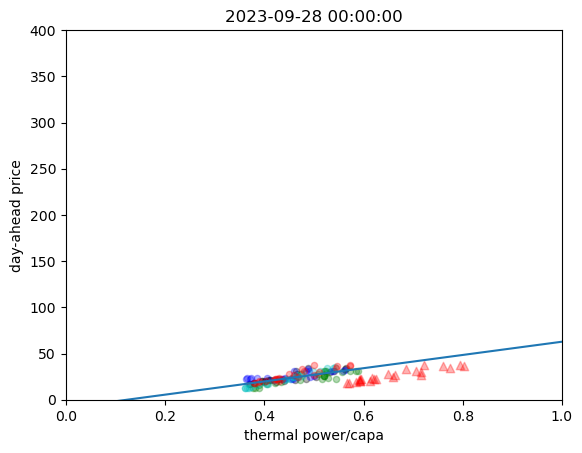

64.20505455393759
74.07890868280109
71.50347535169887
55.521325713312294
66.96879736488911 66.96879736488916 66.96879736488918


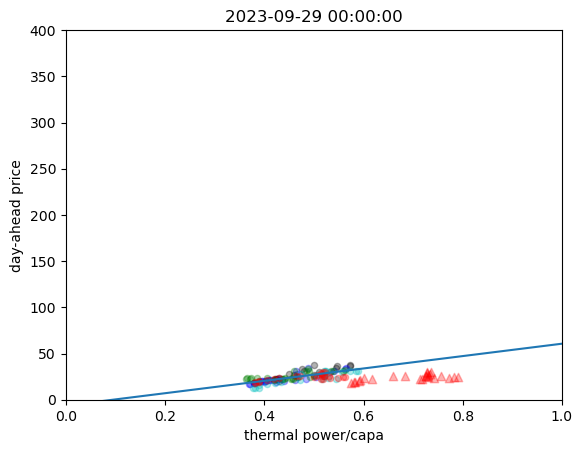

62.050115131578956
64.20505455393759
74.07890868280109
71.50347535169888
67.95764048634014 67.95764048634014 67.95764048634014


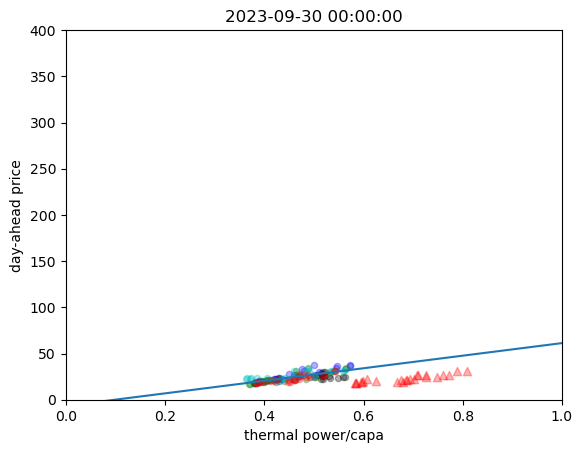

78.8568009868421
62.050115131578956
64.20505455393759
74.07890868280109
69.65008671715383 69.65008671715383 69.65008671715375


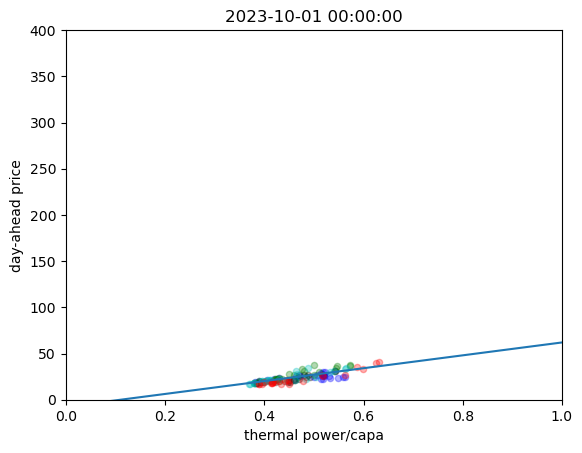

51.61995459589943
78.8568009868421
62.050115131578956
64.2050545539376
64.03775157659511 64.03775157659517 64.03775157659504


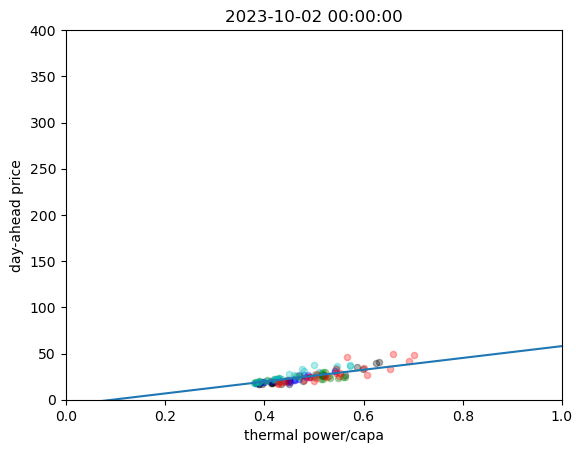

89.87743816710321
51.61995459589943
78.8568009868421
62.050115131578956
35.09414335828602 73.84746423071527 73.84746423071563


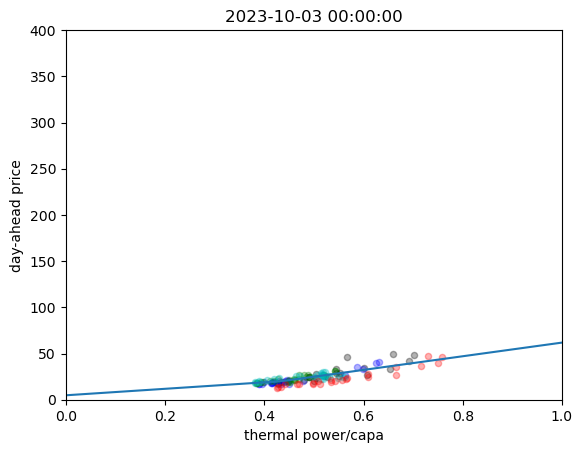

57.61530203366578
89.87743816710321
51.61995459589943
78.8568009868421
33.00428473256632 63.697679993351485 63.69767999335157


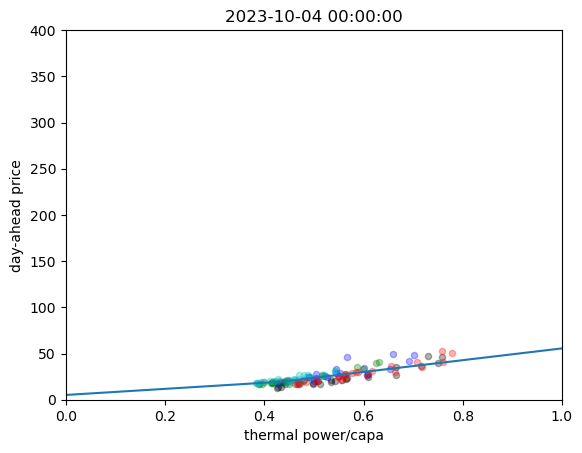

60.57380092025993
57.61530203366578
89.87743816710321
51.61995459589943
30.83380547236873 74.95536938494959 74.95536938494952


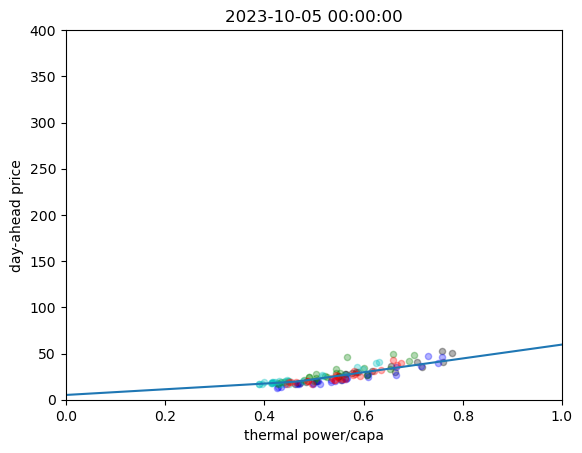

66.51419024427673
60.57380092025991
57.615302033665614
89.87743816710321
35.16256763340518 83.13710522473663 83.13710522473662


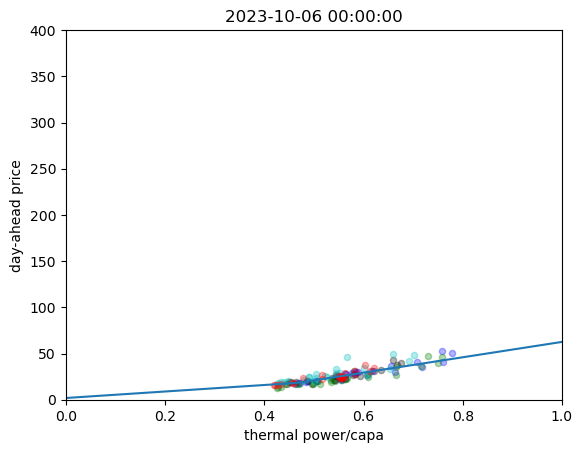

86.11535117840356
66.51419024427675
60.57380092025993
57.61530203366577
61.48633070983796 79.3157834315812 79.31578343158115


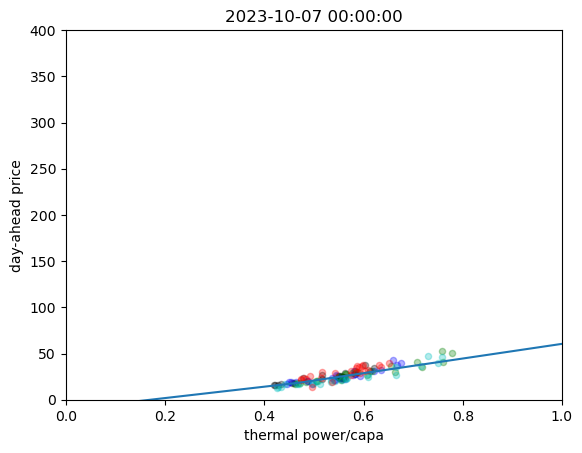

91.19288317056662
86.11535117840361
66.51419024427675
60.57380092025989
69.14889327917498 80.91400859700606 80.91400859700603


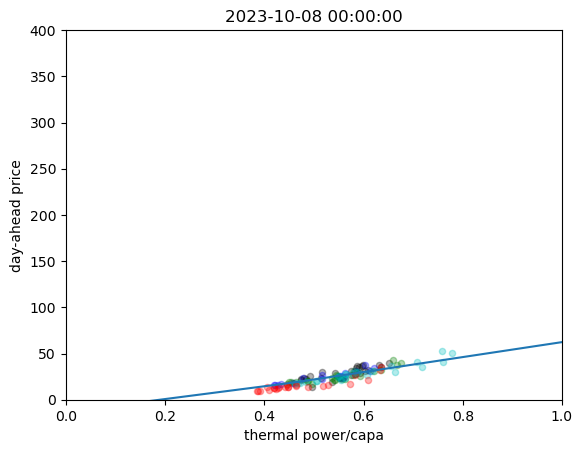

65.10608016701022
91.19288317056714
86.11535117840356
66.51419024427675
91.7914430437238 91.79144304372385 91.79144304372392


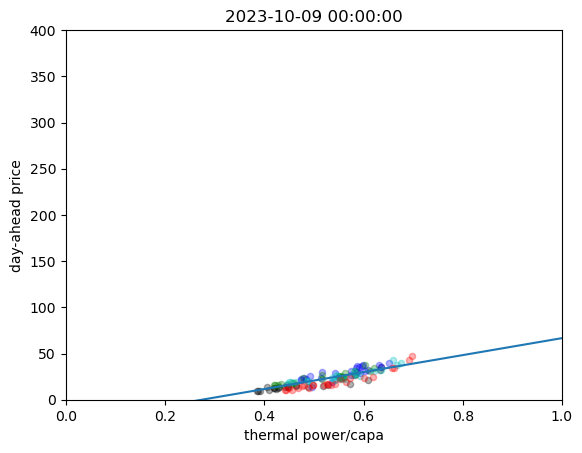

75.40264714953229
65.1060801670102
91.19288317056738
86.11535117840356
86.82855942382281 99.81606205591625 99.81606205591623


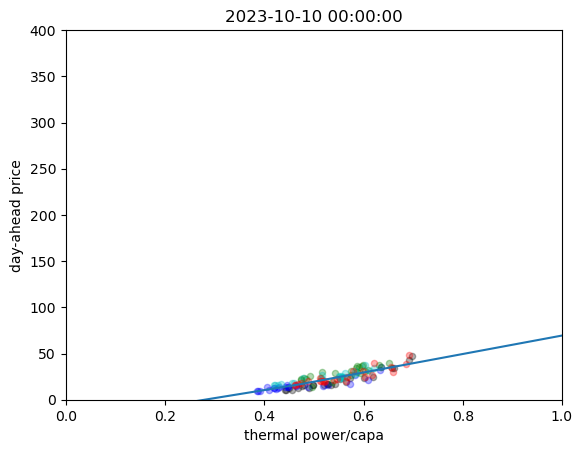

82.92503421846772
75.40264714953229
65.10608016701019
91.19288317056736
79.04513408148529 105.89690301786936 105.89690301786935


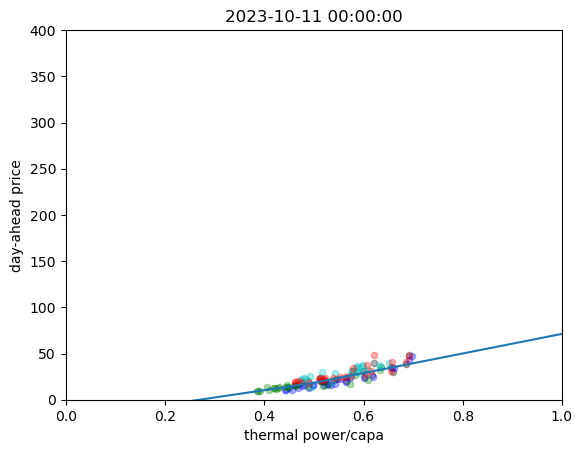

82.04632040471762
82.92503421846772
75.40264714953229
65.1060801670102
77.72418176688114 97.12134561815552 97.12134561815552


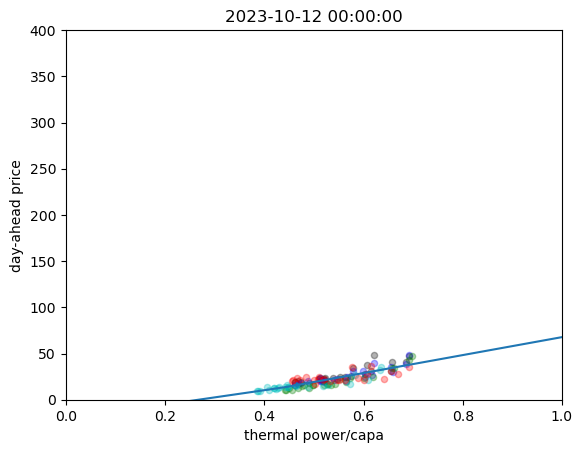

85.07536184210528
82.04632040471763
82.92503421846772
75.40264714953231
82.0049757687236 82.00497576872358 82.00497576872372


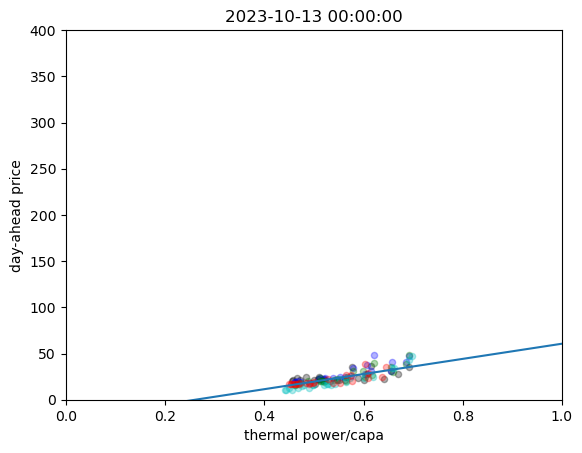

69.66664214332633
85.07536184210528
82.04632040471762
82.92503421846766
71.8158350499352 71.81583504993523 71.81583504993534


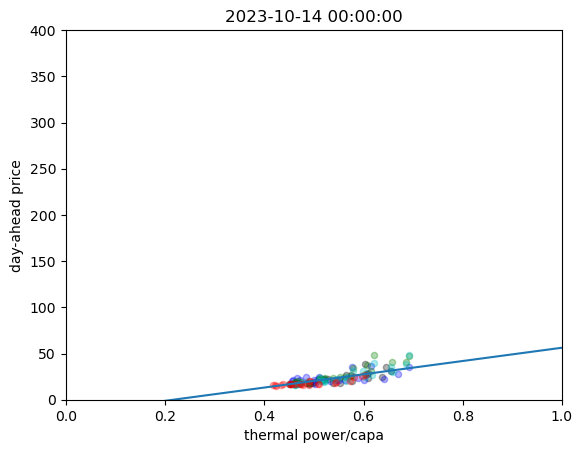

48.966842105263154
69.66664214332627
85.07536184210528
82.04632040471763
68.01875927635577 68.01875927635575 68.01875927635587


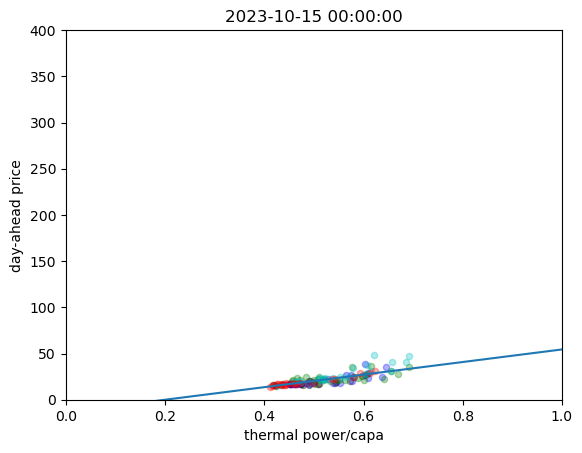

53.345207502721706
48.966842105263154
69.66664214332626
85.07536184210528
37.10002571018973 51.85694730920444 51.856947309204415


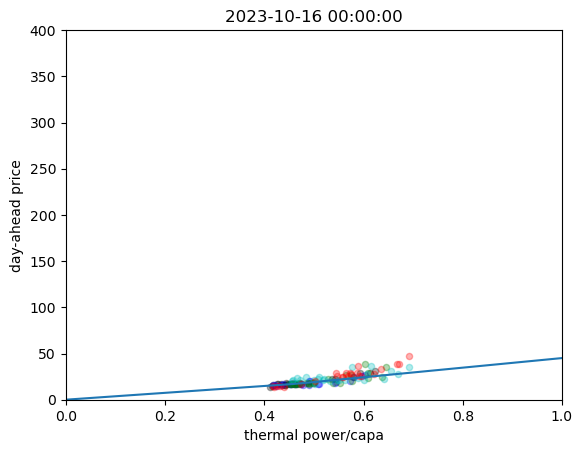

62.11863388405775
53.345207502721706
48.966842105263154
69.66664214332626
41.489846876354825 72.77800526112213 72.77800526112223


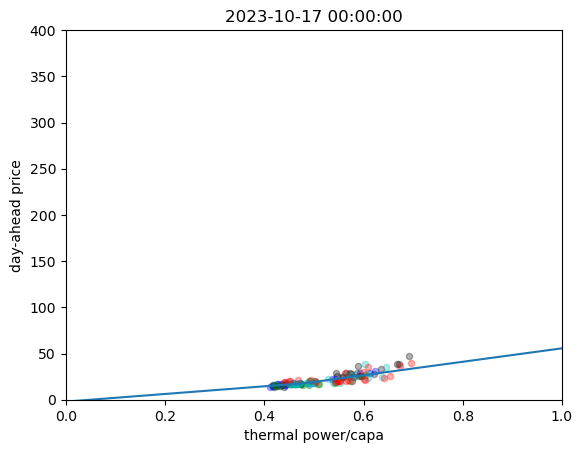

84.56609013988489
62.14279514890073
53.34520750272172
48.966842105263154
43.70326403687886 70.46956869663806 70.46956869663796


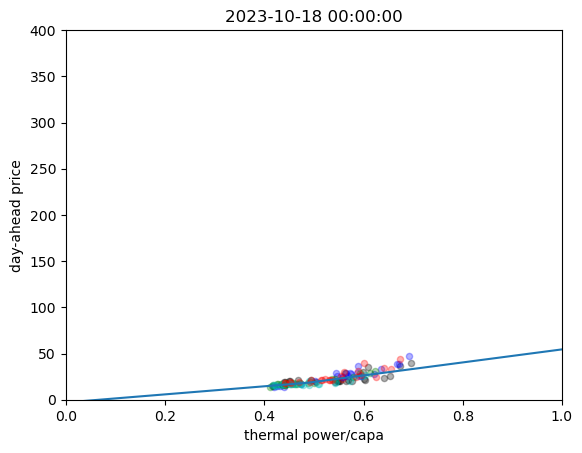

74.66828921521821
84.56609013988489
62.09172256386335
53.34520750272172
51.66296126274901 80.89130062300693 80.8913006230069


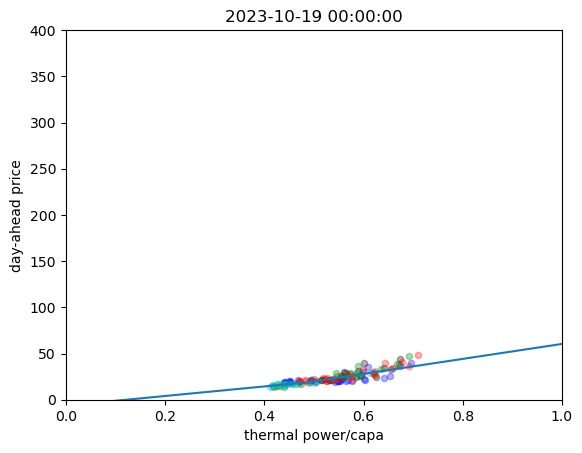

82.5816552190417
74.66828921521827
84.56609013988489
62.108696064637755
72.05934769021682 72.05934769021688 72.05934769021654


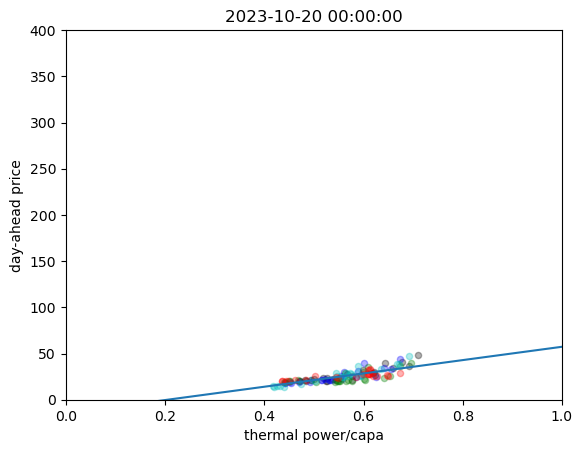

49.015945375442996
82.5816552190417
74.66828921521827
84.56609013988489
26.47683623632945 72.77687093037616 72.77687093037662


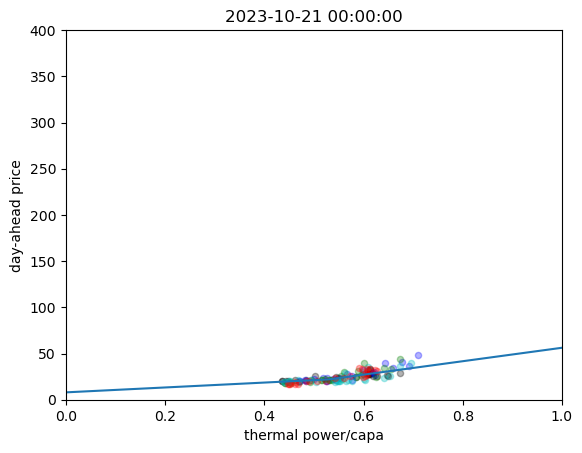

56.21811843460157
49.01594537544297
82.5816552190417
74.66828921521824
48.449669718634695 68.574634389491 68.57463438949078


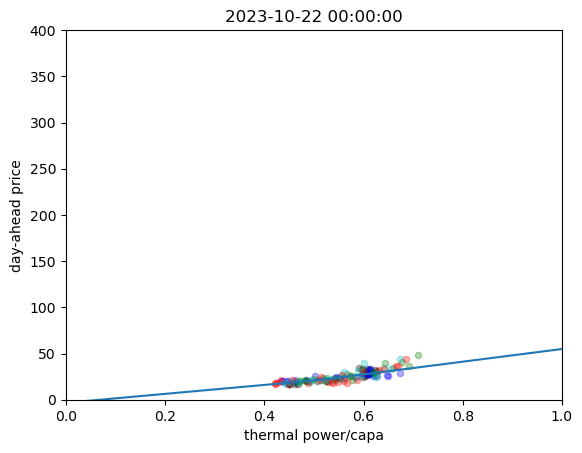

117.2281936445724
56.218118434601536
49.01594537544297
82.5816552190417
38.84812440896662 81.476648584577 81.47664858457675


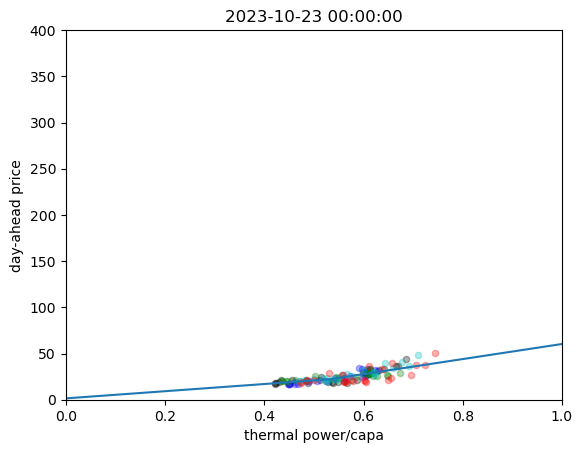

144.60836620080607
117.22819364457239
56.21811843460157
49.01594537544297
24.033614493641416 63.44016692552939 63.44016692552962


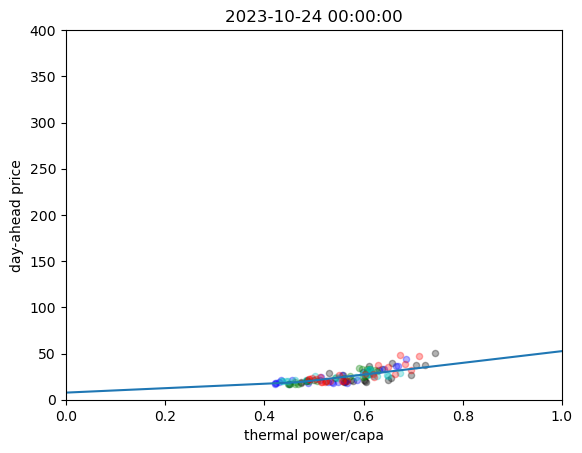

112.65691405302753
144.60836620080607
117.2281936445724
56.21811843460157
0.0 71.09389449219513 71.09389449219496


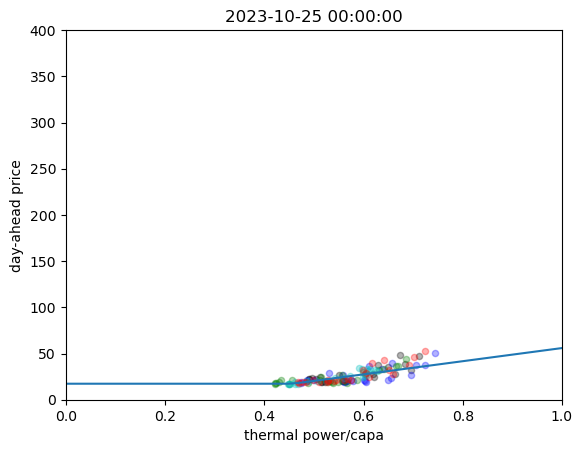

112.47408065854086
112.65691405302753
144.60836620080607
117.22819364457237
21.90068133268921 108.46669221018476 108.4666922101849


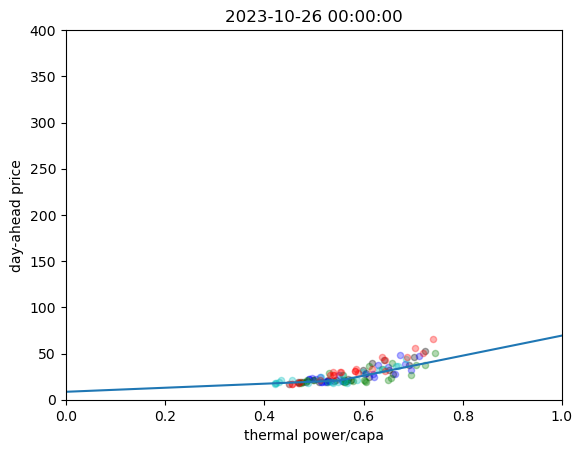

71.5876972277847
112.48855150745874
112.65691405302753
144.60836620080607
80.55619562216359 80.55619562216357 80.55619562216347


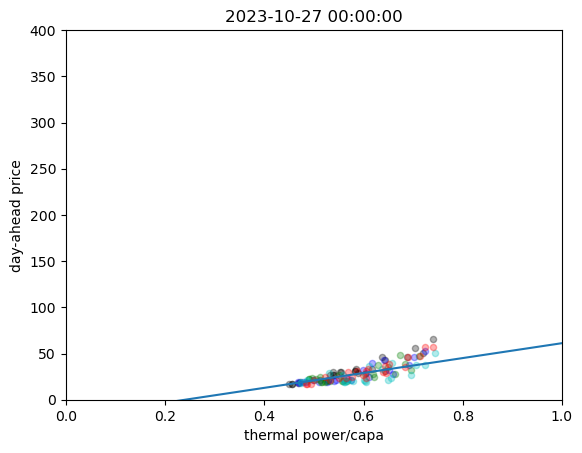

108.52497279738654
71.5876972277847
112.48855150745871
112.65691405302753
61.31169570996009 108.2240838277593 108.22408382775937


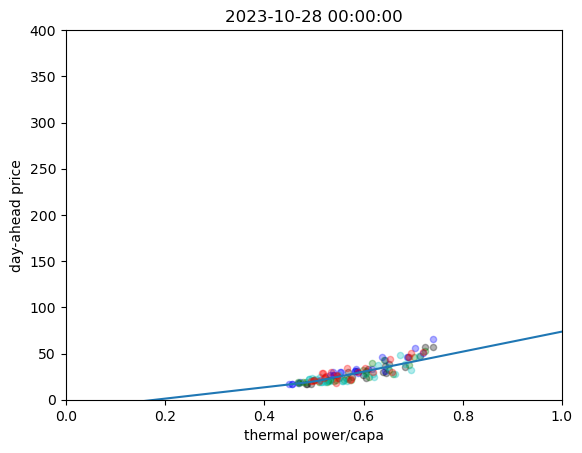

146.18865541903966
108.52497279738654
71.58769722778472
112.46733623295846
100.35458681948704 129.54040753971574 129.54040753971594


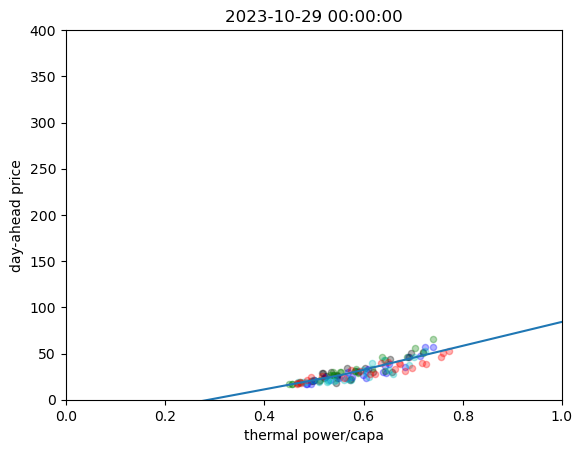

88.59139178436754
146.18865541903966
108.52497279738654
71.58769722778487
107.16294751040589 107.16294751040584 107.16294751040583


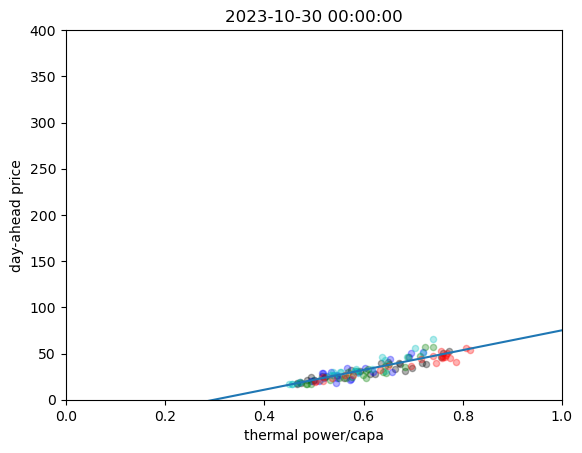

59.53205266583123
88.59139178436753
146.18865541903966
108.52497279738652
99.62922498690239 99.62922498690243 99.62922498690241


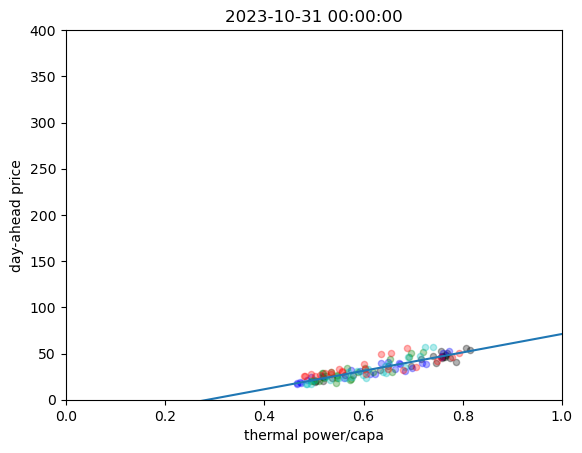

In [38]:
warnings.filterwarnings("ignore", category=ConvergenceWarning)
record = []
count = 0
tmp_record = []
color = ['k', 'b', 'g', 'c', 'm']
for _ in pd.date_range(pd.to_datetime('2023/1/1'),pd.to_datetime('2023/10/31')):
    X = np.array([])
    Y = np.array([])
    X1 = np.array([])
    Y1 = np.array([])
    tmp_model = 0
    model_dis = 0
    min1, max1, min2, max2 = 0, 0, 0, 0
    t = 0
    plt.cla()
    plt.xlim(0,1)
    plt.ylim(0,400)
    plt.xlabel('thermal power/capa')
    plt.ylabel('day-ahead price')
    plt.title('{}'.format(_))

    for __ in range(1, 5):
        date = _ - datetime.timedelta(__)
        df10 = get_price_data(date)['Locational Marginal Price']
        df11 = get_predpower_predcapa(date)['thermal/capa']
        df12 = pd.concat([df11, df10], axis=1)
        # df12[df12['Locational Marginal Price'] < 15] = np.nan
        # df12[df12['Locational Marginal Price'] > 100] = np.nan
        # df12 = df12.dropna(how='all')
        # tmp1 = df12[df12['Locational Marginal Price'] <20]
        # if tmp1.shape[0]:
        #     for x, y in zip(tmp1['thermal/capa'], tmp1['Locational Marginal Price']):
        #         newrow = pd.DataFrame(np.repeat([[x,y]],math.exp((20-y)/20)*100,axis=0))
        #         newrow.columns = ['thermal/capa', 'Locational Marginal Price']
        #         df12 = pd.concat([df12, newrow])
        y = df12['Locational Marginal Price']
        x = df12['thermal/capa']
        # print(x,y)
        if pd.isnull(x).all() or pd.isnull(y).all():
            continue
        model = simulate_by_3_part_line(x.to_list(), y.to_list())
        print(evaluate_model_accu(model, x, y))
        if evaluate_model_accu(model, x, y) > 4000:
            continue
        if not tmp_model:
            tmp_model = model
            min1, max1 = min(x), max(x)
        else:
            min2, max2 = min(x), max(x)
            up = min(max1, max2)
            down = max(min1, min2)
            model_dis = evaluate_model_dist(tmp_model, model, down, up)
#             print(model_dis)
        if model_dis > 7000:
            print('search {} days for 3 part'.format(__-1))
            break
        X = np.append(X, x)
        Y = np.append(Y, y)
        if t < 5:    
            plt.scatter(x, y, s = 20, alpha = 0.3, color = color[t])
            t += 1
        # df10 = get_price_data1(date)['realtime_price']
        # df11 = get_pred_load_data11(date)['gap/capa']
        # df12 = pd.concat([df11, df10], axis=1)
        # df12[df12['realtime_price'] < 60] = np.nan
        # df12[df12['realtime_price'] > 1450] = np.nan
        # df12 = df12.dropna(how='all')
        # tmp1 = df12[df12['realtime_price'] <200]
        # if tmp1.shape[0]:
        #     for x, y in zip(tmp1['gap/capa'], tmp1['realtime_price']):
        #         newrow = pd.DataFrame(np.repeat([[x,y]],math.exp((60-y)/60)*100,axis=0))
        #         newrow.columns = ['gap/capa', 'realtime_price']
        #         df12 = pd.concat([df12, newrow])
        # y = df12['realtime_price']
        # x = df12['gap/capa']
        # plt.scatter(x, y, s = 20, alpha = 0.3, color = 'y')
        # X = np.append(X, x)
        # Y = np.append(Y, y)
    if not(np.size(X)==0 or np.size(Y)==0):
        X = X.astype(float)
        mypwlf1 = simulate_by_3_part_line1(X,Y)
#     if not(np.isnan(X1).all() or np.isnan(Y1).all()):
#         mypwlf1_1 = choose_line_num(X1,Y1)
#     tmp_record.append(evaluate_model_dist(mypwlf1_1, mypwlf1, down, up))

#     xd = np.linspace(0, 1)
#     plt.plot(xd, mypwlf1.predict(xd))
    if (np.isnan(X).all() or np.isnan(Y).all()):
        continue
    s1, s2, s3 = mypwlf1.calc_slopes()
    print(s1, s2, s3)
    
#     df10 = get_price_data(_)['dayahead_price']
#     df11 = get_pred_load_data(_)['gap/capa']
#     df12 = pd.concat([df11, df10], axis=1)
#     df12[df12['dayahead_price'] < 60] = np.nan
#     df12[df12['dayahead_price'] > 1450] = np.nan
#     df12 = df12.dropna(how='all')
#     y = df12['dayahead_price']
#     x = df12['gap/capa']
    x = get_predpower_predcapa(_)['thermal/capa']
    y = get_price_data(_)['Locational Marginal Price']
    x, y = np.array(pd.DataFrame(np.append(x,y).reshape(2,-1)).T.dropna().T)[0,:], np.array(pd.DataFrame(np.append(x,y).reshape(2,-1)).T.dropna().T)[1,:]
    if not(np.size(x)==0 or np.size(y)==0):
        x, y = x.astype(float), y.astype(float)
        mypwlf11 = simulate_by_3_part_line1(x, y)
        plt.scatter(x, y, s = 20, alpha = 0.3, color='r')
        y_real = get_price_data(_)['Locational Marginal Price']
        x_real = get_realpower_realcapa(_)['thermal/capa']
        if not(np.isnan(x_real).all()):
#         x_real = get_pred_load_data(_)['gap/capa']
            plt.scatter(x_real, y_real, marker='^', alpha = 0.3, color='r')
    # if not (s1>s2+500>500 and s3>s2+500>500):
    #     X = np.append(X, [min(X)-0.01 for i in range(60)])
    #     Y = np.append(Y, [0 for i in range(60)])
    #     X = np.append(X, [max(X)+0.01 for i in range(20)])
    #     Y = np.append(Y, [1500 for i in range(20)])
    #     mypwlf1 = simulate_by_3_part_line1(X,Y)
    #     s1, s2, s3 = mypwlf1.calc_slopes()
    #     print(s1, s2, s3)
    #     if not (s1>s2+500>500 and s3>s2+500>500):
    #         X = np.append(X, [min(X) for i in range(60)])
    #         Y = np.append(Y, [0 for i in range(60)])
    #         mypwlf1 = simulate_by_3_part_line1(X,Y)
    #         s1, s2, s3 = mypwlf1.calc_slopes()
    #         print(s1, s2, s3)
    #         count += 1
    xd = np.linspace(0, 1)
    plt.plot(xd, mypwlf1.predict(xd))
    plt.show()
    mae2, smape2 = calculate_dist(mypwlf1, _)
    mae3, smape3 = calculate_dist(mypwlf1, _ + datetime.timedelta(1))
    mae4, smape4 = calculate_dist(mypwlf1, _ + datetime.timedelta(2))
    mae5, smape5 = calculate_dist(mypwlf1, _ + datetime.timedelta(3))
    mae6, smape6 = calculate_dist(mypwlf11, _)
#         print(mae2, smape2, mae3, smape3, mae4, smape4, mae5, smape5, mae6, smape6)
    record.append([mae2, mae3, mae4, mae5, mae6, smape2, smape3, smape4, smape5, smape6])
